In [1]:
from google.colab import drive
drive.mount('/content/drive/')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive/


In [2]:
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import gridspec
%matplotlib inline
import seaborn as sns

from collections import Counter
import itertools
from io import BytesIO
from collections import Counter
import requests
from PIL import Image
import math

import re
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import pairwise_distances

from gensim.models import Word2Vec
from gensim.models import KeyedVectors
import pickle

import plotly
import plotly.figure_factory as ff
from plotly.graph_objs import Scatter, Layout

plotly.offline.init_notebook_mode(connected=True)
warnings.filterwarnings("ignore")

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [3]:
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))

# 1. Read Data

In [ ]:
data = pd.read_json('/content/drive/My Drive/*Assign 26 - Apparel Recommendation/Copy of tops_fashion.json')
data.head()

,sku,asin,product_type_name,formatted_price,author,color,brand,publisher,availability,reviews,large_image_url,availability_type,small_image_url,editorial_review,title,model,medium_image_url,manufacturer,editorial_reivew
0,None,B016I2TS4W,SHIRT,None,None,None,FNC7C,None,None,"[False, https://www.amazon.com/reviews/iframe?...",https://images-na.ssl-images-amazon.com/images...,None,https://images-na.ssl-images-amazon.com/images...,Minions Como Superheroes Ironman Women's O Nec...,Minions Como Superheroes Ironman Long Sleeve R...,None,https://images-na.ssl-images-amazon.com/images...,None,NaN
1,None,B01N49AI08,SHIRT,None,None,None,FIG Clothing,None,None,"[False, https://www.amazon.com/reviews/iframe?...",https://images-na.ssl-images-amazon.com/images...,None,https://images-na.ssl-images-amazon.com/images...,Sizing runs on the small side. FIG® recommends...,FIG Clothing Womens Izo Tunic,None,https://images-na.ssl-images-amazon.com/images...,None,NaN
2,None,B01JDPCOHO,SHIRT,None,None,None,FIG Clothing,None,None,"[False, https://www.amazon.com/reviews/iframe?...",https://images-na.ssl-images-amazon.com/images...,None,https://images-na.ssl-images-amazon.com/images...,Sizing runs on the small side. FIG® recommends...,FIG Clothing Womens Won Top,None,https://images-na.ssl-images-amazon.com/images...,None,NaN
3,None,B01N19U5H5,SHIRT,None,None,None,Focal18,None,None,"[True, https://www.amazon.com/reviews/iframe?a...",https://images-na.ssl-images-amazon.com/images...,None,https://images-na.ssl-images-amazon.com/images...,100% Brand New & Fashion<br> Quantity: 1 Piece...,Focal18 Sailor Collar Bubble Sleeve Blouse Shi...,None,https://images-na.ssl-images-amazon.com/images...,None,NaN
4,None,B004GSI2OS,SHIRT,$26.26,None,Onyx Black/ Stone,FeatherLite,None,Usually ships in 6-10 business days,"[False, https://www.amazon.com/reviews/iframe?...",https://images-na.ssl-images-amazon.com/images...,now,https://images-na.ssl-images-amazon.com/images...,,Featherlite Ladies' Long Sleeve Stain Resistan...,None,https://images-na.ssl-images-amazon.com/images...,None,NaN


In [ ]:
data.shape

(183138, 19)

In [ ]:
data.columns

Index(['sku', 'asin', 'product_type_name', 'formatted_price', 'author',
       'color', 'brand', 'publisher', 'availability', 'reviews',
       'large_image_url', 'availability_type', 'small_image_url',
       'editorial_review', 'title', 'model', 'medium_image_url',
       'manufacturer', 'editorial_reivew'],
      dtype='object')

## Note:
- We are going to consider only asin, product_type_name, formatted_price, color, brand, title, medium_image_url

In [ ]:
data = data[['asin', 'color', 'brand', 'product_type_name', 'title', 'formatted_price', 'medium_image_url']]
data.head()

,asin,color,brand,product_type_name,title,formatted_price,medium_image_url
0,B016I2TS4W,None,FNC7C,SHIRT,Minions Como Superheroes Ironman Long Sleeve R...,None,https://images-na.ssl-images-amazon.com/images...
1,B01N49AI08,None,FIG Clothing,SHIRT,FIG Clothing Womens Izo Tunic,None,https://images-na.ssl-images-amazon.com/images...
2,B01JDPCOHO,None,FIG Clothing,SHIRT,FIG Clothing Womens Won Top,None,https://images-na.ssl-images-amazon.com/images...
3,B01N19U5H5,None,Focal18,SHIRT,Focal18 Sailor Collar Bubble Sleeve Blouse Shi...,None,https://images-na.ssl-images-amazon.com/images...
4,B004GSI2OS,Onyx Black/ Stone,FeatherLite,SHIRT,Featherlite Ladies' Long Sleeve Stain Resistan...,$26.26,https://images-na.ssl-images-amazon.com/images...


# 2.Missing Data for various features

## 2.1 Product type name

In [ ]:
print(data['product_type_name'].describe())

count     183138
unique        72
top        SHIRT
freq      167794
Name: product_type_name, dtype: object


In [ ]:
print(data['product_type_name'].unique())

['SHIRT' 'SWEATER' 'APPAREL' 'OUTDOOR_RECREATION_PRODUCT'
 'BOOKS_1973_AND_LATER' 'PANTS' 'HAT' 'SPORTING_GOODS' 'DRESS' 'UNDERWEAR'
 'SKIRT' 'OUTERWEAR' 'BRA' 'ACCESSORY' 'ART_SUPPLIES' 'SLEEPWEAR'
 'ORCA_SHIRT' 'HANDBAG' 'PET_SUPPLIES' 'SHOES' 'KITCHEN' 'ADULT_COSTUME'
 'HOME_BED_AND_BATH' 'MISC_OTHER' 'BLAZER' 'HEALTH_PERSONAL_CARE'
 'TOYS_AND_GAMES' 'SWIMWEAR' 'CONSUMER_ELECTRONICS' 'SHORTS' 'HOME'
 'AUTO_PART' 'OFFICE_PRODUCTS' 'ETHNIC_WEAR' 'BEAUTY'
 'INSTRUMENT_PARTS_AND_ACCESSORIES' 'POWERSPORTS_PROTECTIVE_GEAR' 'SHIRTS'
 'ABIS_APPAREL' 'AUTO_ACCESSORY' 'NONAPPARELMISC' 'TOOLS' 'BABY_PRODUCT'
 'SOCKSHOSIERY' 'POWERSPORTS_RIDING_SHIRT' 'EYEWEAR' 'SUIT'
 'OUTDOOR_LIVING' 'POWERSPORTS_RIDING_JACKET' 'HARDWARE' 'SAFETY_SUPPLY'
 'ABIS_DVD' 'VIDEO_DVD' 'GOLF_CLUB' 'MUSIC_POPULAR_VINYL'
 'HOME_FURNITURE_AND_DECOR' 'TABLET_COMPUTER' 'GUILD_ACCESSORIES'
 'ABIS_SPORTS' 'ART_AND_CRAFT_SUPPLY' 'BAG' 'MECHANICAL_COMPONENTS'
 'SOUND_AND_RECORDING_EQUIPMENT' 'COMPUTER_COMPONENT' 'JEWELRY'
 'B

In [ ]:
product_type_count = Counter(list(data['product_type_name']))
product_type_count.most_common(10)

[('SHIRT', 167794),
 ('APPAREL', 3549),
 ('BOOKS_1973_AND_LATER', 3336),
 ('DRESS', 1584),
 ('SPORTING_GOODS', 1281),
 ('SWEATER', 837),
 ('OUTERWEAR', 796),
 ('OUTDOOR_RECREATION_PRODUCT', 729),
 ('ACCESSORY', 636),
 ('UNDERWEAR', 425)]

## 2.2Brand

In [ ]:
print(data['brand'].describe())

count     182987
unique     10577
top         Zago
freq         223
Name: brand, dtype: object


In [ ]:
print(data['brand'].unique())

['FNC7C' 'FIG Clothing' 'Focal18' ... 'Z' "Rain's Pan Jacket"
 'FFLMYUHULIU']


In [ ]:
brand_count = Counter(list(data['brand']))
brand_count.most_common(10)

[('Zago', 223),
 ('XQS', 222),
 ('Yayun', 215),
 ('YUNY', 198),
 ('XiaoTianXin-women clothes', 193),
 ('Generic', 192),
 ('Boohoo', 190),
 ('Alion', 188),
 ('Abetteric', 187),
 ('TheMogan', 187)]

## 2.3Color

In [ ]:
print(data['color'].describe())

count     64956
unique     7380
top       Black
freq      13207
Name: color, dtype: object


In [ ]:
print(data['color'].unique())

[None 'Onyx Black/ Stone' 'Grape' ... 'Combo C'
 'White, Soft Coral and Charcoal Varigated' 'Monochrome Plaid']


In [ ]:
data['color'].isnull().sum()

118182

In [ ]:
len(data) - data['color'].isnull().sum()

64956

In [ ]:
color_count = Counter(list(data['color']))
color_count.most_common(10)

[(None, 118182),
 ('Black', 13207),
 ('White', 8616),
 ('Blue', 3570),
 ('Red', 2289),
 ('Pink', 1842),
 ('Grey', 1499),
 ('*', 1388),
 ('Green', 1258),
 ('Multi', 1203)]

## 2.4Title

In [ ]:
print(data['title'].describe())


count                                                183138
unique                                               175985
top       Nakoda Cotton Self Print Straight Kurti For Women
freq                                                     77
Name: title, dtype: object


In [ ]:
data['title'].isnull().sum()

0

## 2.5Price

In [ ]:
print(data['formatted_price'].describe())

count      28395
unique      3135
top       $19.99
freq         945
Name: formatted_price, dtype: object


In [ ]:
price_count = Counter(list(data['formatted_price']))
price_count.most_common(10)

[(None, 154743),
 ('$19.99', 945),
 ('$9.99', 749),
 ('$9.50', 601),
 ('$14.99', 472),
 ('$7.50', 463),
 ('$24.99', 414),
 ('$29.99', 370),
 ('$8.99', 343),
 ('$9.01', 336)]

# 3.Removing data points where values are null

## 3.1 Removing null data points from color

In [ ]:
#loc[~data['color].isnull()] returns data that are not null bcoz ~ is used for not
data = data.loc[~data['color'].isnull()]
data.head()

,asin,color,brand,product_type_name,title,formatted_price,medium_image_url
4,B004GSI2OS,Onyx Black/ Stone,FeatherLite,SHIRT,Featherlite Ladies' Long Sleeve Stain Resistan...,$26.26,https://images-na.ssl-images-amazon.com/images...
5,B00TAEHGGS,Grape,Fitscloth,SHIRT,[Fits Cloth] Grape Solid Modern Long Sleeve Pl...,None,https://images-na.ssl-images-amazon.com/images...
6,B012YX2ZPI,White,HX-Kingdom Fashion T-shirts,SHIRT,Women's Unique 100% Cotton T - Special Olympic...,$9.99,https://images-na.ssl-images-amazon.com/images...
8,B06Y2LCC5S,Black,Fashion2ne1,SHIRT,Standing on His Promises Rhinestones T-Shirt R...,None,https://images-na.ssl-images-amazon.com/images...
11,B001LOUGE4,Black,Fitness Etc.,SHIRT,Ladies Cotton Tank 2x1 Ribbed Tank Top,$11.99,https://images-na.ssl-images-amazon.com/images...


In [ ]:
len(data)

64956

## 3.2 Removing null data points from Price

In [ ]:
data = data.loc[~data['formatted_price'].isnull()]

In [ ]:
len(data)

28385

## 3.3 Remove Duplicates from title

### 3.3.1 Title matches exactly

In [ ]:
data = pd.read_pickle('/content/drive/My Drive/Copy of 28k_apparel_data')
data.head()

,asin,brand,color,medium_image_url,product_type_name,title,formatted_price
4,B004GSI2OS,FeatherLite,Onyx Black/ Stone,https://images-na.ssl-images-amazon.com/images...,SHIRT,Featherlite Ladies' Long Sleeve Stain Resistan...,$26.26
6,B012YX2ZPI,HX-Kingdom Fashion T-shirts,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,Women's Unique 100% Cotton T - Special Olympic...,$9.99
11,B001LOUGE4,Fitness Etc.,Black,https://images-na.ssl-images-amazon.com/images...,SHIRT,Ladies Cotton Tank 2x1 Ribbed Tank Top,$11.99
15,B003BSRPB0,FeatherLite,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,FeatherLite Ladies' Moisture Free Mesh Sport S...,$20.54
21,B014ICEDNA,FNC7C,Purple,https://images-na.ssl-images-amazon.com/images...,SHIRT,Supernatural Chibis Sam Dean And Castiel Short...,$7.50


In [ ]:
print('The number of points which are duplicated which title matches exactly:', (sum(data.duplicated('title'))))

The number of points which are duplicated which title matches exactly: 2325


### 3.3.2 Title lenght less than 3 - (ie title with short description)

In [ ]:
(data[data['title'].apply(lambda x: (len(x.split())>4))]).shape

(27949, 7)

In [ ]:
data = data[data['title'].apply(lambda x: len(x.split())>4)]
print('The number of points after removal short description',data_sorted.shape[0])

The number of points after removal short description 27949


### 3.3.3 Remove title with the words change at the last 2 or 3 words
- For this, sort the title and the same title words will be together even if they change at the last 2 or 3 words

In [ ]:
data_sorted = data.sort_values(by='title', ascending=False)
data_sorted.head()

,asin,brand,color,medium_image_url,product_type_name,title,formatted_price
61973,B06Y1KZ2WB,Éclair,Black/Pink,https://images-na.ssl-images-amazon.com/images...,SHIRT,Éclair Women's Printed Thin Strap Blouse Black...,$24.99
133820,B010RV33VE,xiaoming,Pink,https://images-na.ssl-images-amazon.com/images...,SHIRT,xiaoming Womens Sleeveless Loose Long T-shirts...,$18.19
81461,B01DDSDLNS,xiaoming,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,xiaoming Women's White Long Sleeve Single Brea...,$21.58
75995,B00X5LYO9Y,xiaoming,Red Anchors,https://images-na.ssl-images-amazon.com/images...,SHIRT,xiaoming Stripes Tank Patch/Bear Sleeve Anchor...,$15.91
151570,B00WPJG35K,xiaoming,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,xiaoming Sleeve Sheer Loose Tassel Kimono Woma...,$14.32


### Note:
- We can see that the title at row 133820, 81461, 75995, 151570 have more or less same title since we have sorted it , we found it out.
- Now we can remove it by comparing each title

In [ ]:
indices  = [] #storing the indices of data_sorted

for i, row in data_sorted.iterrows():
    indices.append(i)

In [ ]:
import itertools
stage1_dedupe_asins = []
i = 0
j = 0
num_data_points = data_sorted.shape[0]
while i < num_data_points and j < num_data_points:
    
    previous_i = i

    # store the list of words of ith string in a, ex: a = ['tokidoki', 'The', 'Queen', 'of', 'Diamonds', 'Women's', 'Shirt', 'X-Large']
    a = data['title'].loc[indices[i]].split()

    # search for the similar products sequentially 
    j = i+1
    while j < num_data_points:

        # store the list of words of jth string in b, ex: b = ['tokidoki', 'The', 'Queen', 'of', 'Diamonds', 'Women's', 'Shirt', 'Small']
        b = data['title'].loc[indices[j]].split()

        # store the maximum length of two strings
        length = max(len(a), len(b))

        # count is used to store the number of words that are matched in both strings
        count  = 0

        # itertools.zip_longest(a,b): will map the corresponding words in both strings, it will appened None in case of unequal strings
        # example: a =['a', 'b', 'c', 'd']
        # b = ['a', 'b', 'd']
        # itertools.zip_longest(a,b): will give [('a','a'), ('b','b'), ('c','d'), ('d', None)]
        for k in itertools.zip_longest(a,b): 
            if (k[0] == k[1]):                  #it will compare the tuple which returns above
                count += 1

        # if the number of words in which both strings differ are > 2 , we are considering it as those two apperals are different
        # if the number of words in which both strings differ are < 2 , we are considering it as those two apperals are same, hence we are ignoring them
        if (length - count) > 2: # number of words in which both sensences differ
            # if both strings are differ by more than 2 words we include the 1st string index
            stage1_dedupe_asins.append(data_sorted['asin'].loc[indices[i]])


            # start searching for similar apperals corresponds 2nd string
            i = j
            break
        else:
            j += 1
    if previous_i == i:
        break

In [ ]:
data = data.loc[data['asin'].isin(stage1_dedupe_asins)]

In [ ]:
data.shape


(17592, 7)

### 3.3.4 Remove near duplicates

<pre>

In the previous cell, we sorted whole data in alphabetical order of  titles.Then, we removed titles which are adjacent and very similar title

But there are some products whose titles are not adjacent but very similar.

Examples:

Titles-1
86261.  UltraClub Women's Classic Wrinkle-Free Long Sleeve Oxford Shirt, Pink, XX-Large
115042. UltraClub Ladies Classic Wrinkle-Free Long-Sleeve Oxford Light Blue XXL

TItles-2
75004.  EVALY Women's Cool University Of UTAH 3/4 Sleeve Raglan Tee
109225. EVALY Women's Unique University Of UTAH 3/4 Sleeve Raglan Tees
120832. EVALY Women's New University Of UTAH 3/4-Sleeve Raglan Tshirt

</pre>

In [ ]:
# This code snippet takes significant amount of time.
# O(n^2) time.
# Takes about an hour to run on a decent computer.

indices = []
for i,row in data.iterrows():
    indices.append(i)

stage2_dedupe_asins = []
while len(indices)!=0:
    i = indices.pop()     #pip removes the item in a list and returns its index
    stage2_dedupe_asins.append(data['asin'].loc[i])
    # consider the first apperal's title
    a = data['title'].loc[i].split()
    # store the list of words of ith string in a, ex: a = ['tokidoki', 'The', 'Queen', 'of', 'Diamonds', 'Women's', 'Shirt', 'X-Large']
    for j in indices:
        
        b = data['title'].loc[j].split()
        # store the list of words of jth string in b, ex: b = ['tokidoki', 'The', 'Queen', 'of', 'Diamonds', 'Women's', 'Shirt', 'X-Large']
        
        length = max(len(a),len(b))
        
        # count is used to store the number of words that are matched in both strings
        count  = 0

        # itertools.zip_longest(a,b): will map the corresponding words in both strings, it will appened None in case of unequal strings
        # example: a =['a', 'b', 'c', 'd']
        # b = ['a', 'b', 'd']
        # itertools.zip_longest(a,b): will give [('a','a'), ('b','b'), ('c','d'), ('d', None)]
        for k in itertools.zip_longest(a,b): 
            if (k[0]==k[1]):
                count += 1

        # if the number of words in which both strings differ are < 3 , we are considering it as those two apperals are same, hence we are ignoring them
        if (length - count) < 3:
            indices.remove(j)

In [ ]:
# from whole previous products we will consider only 
# the products that are found in previous cell 
data = data.loc[data['asin'].isin(stage2_dedupe_asins)]

In [ ]:
print('Number of data points after stage two of dedupe: ',data.shape[0])
# from 17k apperals we reduced to 16k apperals

Number of data points after stage two of dedupe:  16042


## 4.Preprocessing

In [ ]:
data = pd.read_pickle('/content/drive/My Drive/Copy of 16k_apperal_data')
data.head()

,asin,brand,color,medium_image_url,product_type_name,title,formatted_price
4,B004GSI2OS,FeatherLite,Onyx Black/ Stone,https://images-na.ssl-images-amazon.com/images...,SHIRT,Featherlite Ladies' Long Sleeve Stain Resistan...,$26.26
6,B012YX2ZPI,HX-Kingdom Fashion T-shirts,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,Women's Unique 100% Cotton T - Special Olympic...,$9.99
15,B003BSRPB0,FeatherLite,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,FeatherLite Ladies' Moisture Free Mesh Sport S...,$20.54
27,B014ICEJ1Q,FNC7C,Purple,https://images-na.ssl-images-amazon.com/images...,SHIRT,Supernatural Chibis Sam Dean And Castiel O Nec...,$7.39
46,B01NACPBG2,Fifth Degree,Black,https://images-na.ssl-images-amazon.com/images...,SHIRT,Fifth Degree Womens Gold Foil Graphic Tees Jun...,$6.95


In [ ]:
# we use the list of stop words that are downloaded from nltk lib.
stop_words = set(stopwords.words('english'))
print ('list of stop words:', stop_words)

def nlp_preprocessing(total_text, index, column):
    if type(total_text) is not int:
        string = ""
        for words in total_text.split():
            # remove the special chars in review like '"#$@!%^&*()_+-~?>< etc.
            word = ("".join(e for e in words if e.isalnum()))
            # Conver all letters to lower-case
            word = word.lower()
            # stop-word removal
            if not word in stop_words:
                string += word + " "
        data[column][index] = string

list of stop words: {'above', 'is', 'a', 'themselves', 'it', 'that', 're', 'with', "couldn't", 'ourselves', 'hadn', 'further', 'having', 'needn', 'how', 'not', "you've", 've', 'this', 'such', 'are', 'very', 'wouldn', "don't", 'their', "you'll", 'hasn', "mustn't", "isn't", 'up', 'those', 'him', 'theirs', 'then', "doesn't", 'off', 'have', 'what', 'yourself', 'but', 'there', 'll', 'my', 'from', 'each', 'our', 'was', 'weren', 'same', 'should', 'any', 'shouldn', 'who', "that'll", 'these', "you'd", 'other', 'to', 'his', 'of', 'he', 'am', 'its', 'can', 'wasn', 'about', "mightn't", 'until', 'and', 'now', 'will', 'hers', "should've", 'under', 'over', 'you', 'myself', 'aren', 'just', 'or', 'were', 'than', "it's", 'o', "shouldn't", 'herself', 'because', "won't", "hasn't", 'your', 'did', 'too', 'at', 'as', 'on', 'i', "aren't", 'own', 'them', 'ours', 'been', 'doing', 'through', 'didn', "shan't", 't', 'shan', 'most', "wouldn't", 'no', 'be', 'does', 'where', 'few', 'if', 'why', 'which', "you're", 'do

In [ ]:
for index, row in data.iterrows():
    nlp_preprocess(row['title'], index, 'title')

## 5.Text based similarity

In [ ]:
data = pd.read_pickle('/content/drive/My Drive/*Assign 26 - Apparel Recommendation/Copy of 16k_apperal_data_preprocessed')
data.head() 

,asin,brand,color,medium_image_url,product_type_name,title,formatted_price
4,B004GSI2OS,FeatherLite,Onyx Black/ Stone,https://images-na.ssl-images-amazon.com/images...,SHIRT,featherlite ladies long sleeve stain resistant...,$26.26
6,B012YX2ZPI,HX-Kingdom Fashion T-shirts,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,womens unique 100 cotton special olympics wor...,$9.99
15,B003BSRPB0,FeatherLite,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,featherlite ladies moisture free mesh sport sh...,$20.54
27,B014ICEJ1Q,FNC7C,Purple,https://images-na.ssl-images-amazon.com/images...,SHIRT,supernatural chibis sam dean castiel neck tshi...,$7.39
46,B01NACPBG2,Fifth Degree,Black,https://images-na.ssl-images-amazon.com/images...,SHIRT,fifth degree womens gold foil graphic tees jun...,$6.95


### 5.1 Utilities to display images

In [ ]:
#Display an image
def display_img(url,ax,fig):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))
    plt.imshow(img)
  
#plotting code to understand the algorithm's decision.
def plot_heatmap(keys, values, labels, url, text):
        # keys: list of words of recommended title
        # values: len(values) ==  len(keys), values(i) represents the occurence of the word keys(i)
        # labels: len(labels) == len(keys), the values of labels depends on the model we are using
                # if model == 'bag of words': labels(i) = values(i)
                # if model == 'tfidf weighted bag of words':labels(i) = tfidf(keys(i))
                # if model == 'idf weighted bag of words':labels(i) = idf(keys(i))

        # we will devide the whole figure into two parts
        gs = gridspec.GridSpec(2, 2, width_ratios=[4,1], height_ratios=[4,1]) 
        fig = plt.figure(figsize=(25,3))
        
        # 1st, ploting heat map that represents the count of commonly ocurred words in title2
        ax = plt.subplot(gs[0])
        # it displays a cell in white color if the word is intersection(lis of words of title1 and list of words of title2), in black if not
        ax = sns.heatmap(np.array([values]), annot=np.array([labels]))
        ax.set_xticklabels(keys) # set that axis labels as the words of title
        ax.set_title(text) # apparel title
        
        # 2nd, plotting image of the the apparel
        ax = plt.subplot(gs[1])
        # we don't want any grid lines for image and no labels on x-axis and y-axis
        ax.grid(False)
        ax.set_xticks([])
        ax.set_yticks([])
        
        # we call dispaly_img based with paramete url
        display_img(url, ax, fig)
        
        # displays combine figure ( heat map and image together)
        plt.show()
    
def plot_heatmap_image(doc_id, vec1, vec2, url, text, model):

    # doc_id : index of the title1
    # vec1 : input apparels's vector, it is of a dict type {word:count}
    # vec2 : recommended apparels's vector, it is of a dict type {word:count}
    # url : apparels image url
    # text: title of recomonded apparel (used to keep title of image)
    # model, it can be any of the models, 
        # 1. bag_of_words
        # 2. tfidf
        # 3. idf

    # we find the common words in both titles, because these only words contribute to the distance between two title vec's
    intersection = set(vec1.keys()) & set(vec2.keys()) 

    # we set the values of non intersecting words to zero, this is just to show the difference in heatmap
    for i in vec2:
        if i not in intersection:
            vec2[i]=0

    # for labeling heatmap, keys contains list of all words in title2
    keys = list(vec2.keys())
    #  if ith word in intersection(lis of words of title1 and list of words of title2): values(i)=count of that word in title2 else values(i)=0 
    values = [vec2[x] for x in vec2.keys()]
    
    # labels: len(labels) == len(keys), the values of labels depends on the model we are using
        # if model == 'bag of words': labels(i) = values(i)
        # if model == 'tfidf weighted bag of words':labels(i) = tfidf(keys(i))
        # if model == 'idf weighted bag of words':labels(i) = idf(keys(i))

    if model == 'bag_of_words':
        labels = values
    elif model == 'tfidf':
        labels = []
        for x in vec2.keys():
            # tfidf_title_vectorizer.vocabulary_ it contains all the words in the corpus
            # tfidf_title_features[doc_id, index_of_word_in_corpus] will give the tfidf value of word in given document (doc_id)
            if x in  tfidf_title_vectorizer.vocabulary_:
                labels.append(tfidf_title_features[doc_id, tfidf_title_vectorizer.vocabulary_[x]])
            else:
                labels.append(0)
    elif model == 'idf':
        labels = []
        for x in vec2.keys():
            # idf_title_vectorizer.vocabulary_ it contains all the words in the corpus
            # idf_title_features[doc_id, index_of_word_in_corpus] will give the idf value of word in given document (doc_id)
            if x in  idf_title_vectorizer.vocabulary_:
                labels.append(idf_title_features[doc_id, idf_title_vectorizer.vocabulary_[x]])
            else:
                labels.append(0)

    plot_heatmap(keys, values, labels, url, text)


# this function gets a list of wrods along with the frequency of each 
# word given "text"
def text_to_vector(text):
    word = re.compile(r'\w+')
    words = word.findall(text)
    # words stores list of all words in given string, you can try 'words = text.split()' this will also gives same result
    return Counter(words) # Counter counts the occurence of each word in list, it returns dict type object {word1:count}



def get_result(doc_id, content_a, content_b, url, model):
    text1 = content_a
    text2 = content_b
    
    # vector1 = dict{word11:#count, word12:#count, etc.}
    vector1 = text_to_vector(text1)

    # vector1 = dict{word21:#count, word22:#count, etc.}
    vector2 = text_to_vector(text2)

    plot_heatmap_image(doc_id, vector1, vector2, url, text2, model)

## 6.Bag of Words:


In [ ]:
vec = CountVectorizer()
title_features = vec.fit_transform(data['title'])
print(title_features.get_shape())

(16042, 12609)


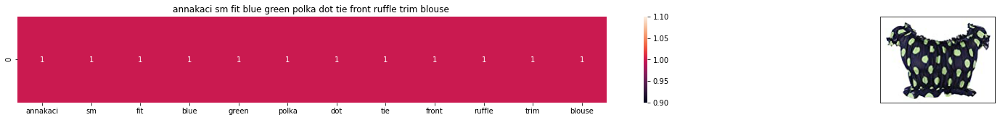

ASIN : B00KLHUIBS
Brand: Anna-Kaci
Title: annakaci sm fit blue green polka dot tie front ruffle trim blouse 
Euclidean similarity with the query image : 0.0


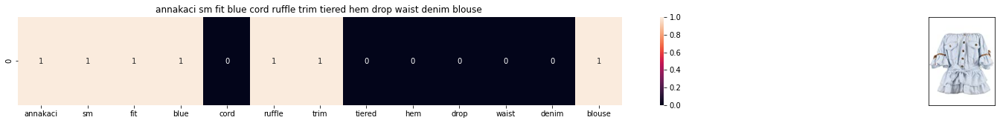

ASIN : B0759G15ZX
Brand: Anna-Kaci
Title: annakaci sm fit blue cord ruffle trim tiered hem drop waist denim blouse 
Euclidean similarity with the query image : 3.3166247903554


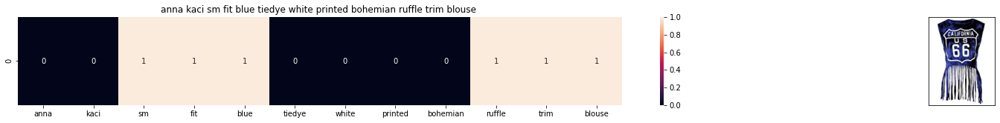

ASIN : B00YQ8S4K0
Brand: Anna-Kaci
Title: anna kaci sm fit blue tiedye white printed bohemian ruffle trim blouse 
Euclidean similarity with the query image : 3.4641016151377544


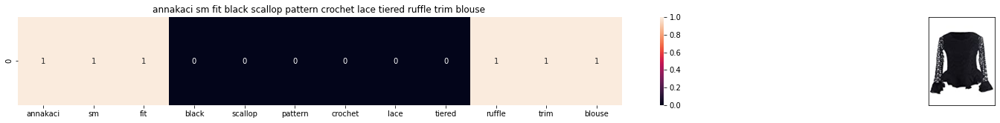

ASIN : B00O194W8W
Brand: Anna-Kaci
Title: annakaci sm fit black scallop pattern crochet lace tiered ruffle trim blouse 
Euclidean similarity with the query image : 3.4641016151377544


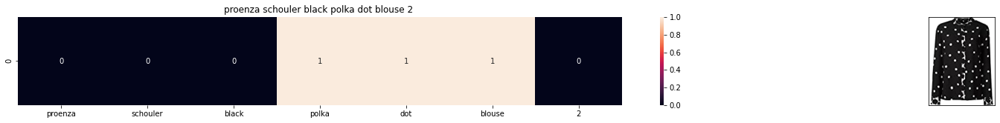

ASIN : B074TLHLMN
Brand: Proenza Schouler
Title: proenza schouler black polka dot blouse 2 
Euclidean similarity with the query image : 3.4641016151377544


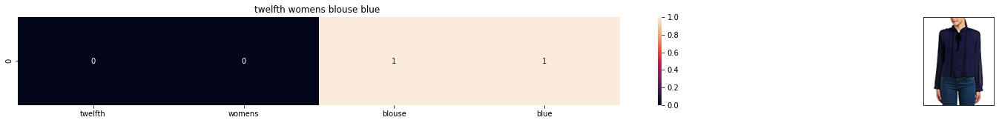

ASIN : B074F5BP5F
Brand: On Twelfth
Title: twelfth womens blouse blue 
Euclidean similarity with the query image : 3.4641016151377544


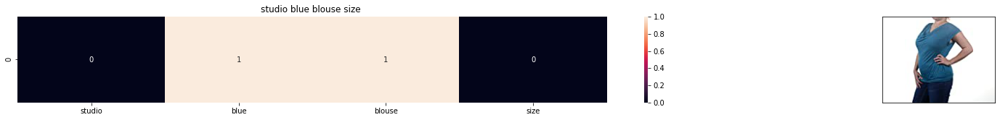

ASIN : B016P80OKQ
Brand: Studio M
Title: studio blue blouse size 
Euclidean similarity with the query image : 3.4641016151377544


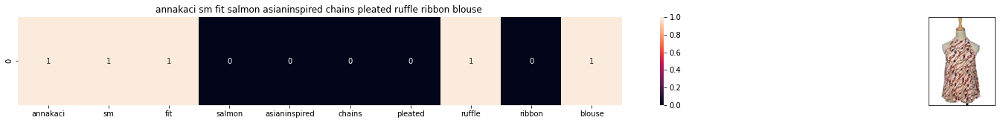

ASIN : B007KSG42S
Brand: Anna-Kaci
Title: annakaci sm fit salmon asianinspired chains pleated ruffle ribbon blouse 
Euclidean similarity with the query image : 3.4641016151377544


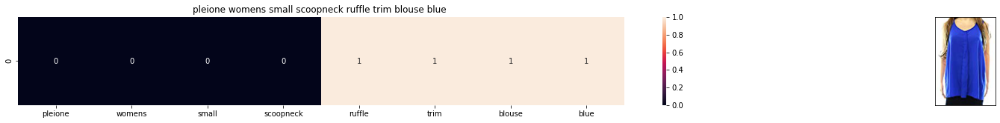

ASIN : B072VHTT1D
Brand: Pleione
Title: pleione womens small scoopneck ruffle trim blouse blue 
Euclidean similarity with the query image : 3.4641016151377544


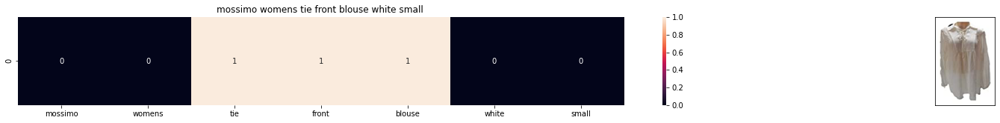

ASIN : B07111HHX6
Brand: Mossimo
Title: mossimo womens tie front blouse white small 
Euclidean similarity with the query image : 3.605551275463989


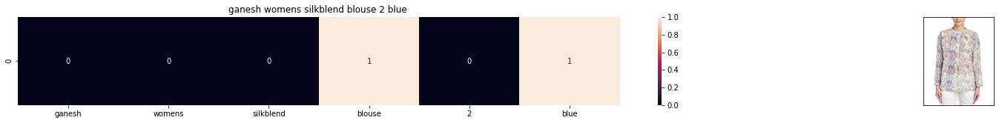

ASIN : B01N3SAT1F
Brand: Ganesh
Title: ganesh womens silkblend blouse 2 blue 
Euclidean similarity with the query image : 3.605551275463989


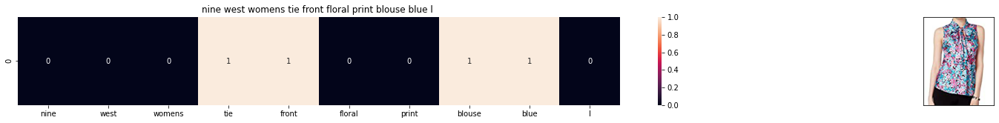

ASIN : B06WW5C6NJ
Brand: Nine West
Title: nine west womens tie front floral print blouse blue l 
Euclidean similarity with the query image : 3.605551275463989


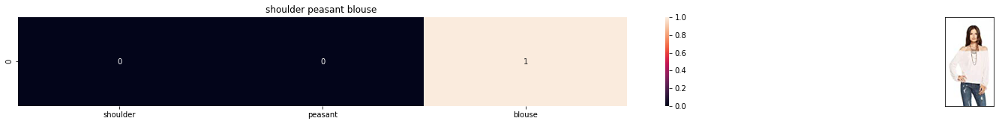

ASIN : B01E1QD5PK
Brand: CHASER
Title: shoulder peasant blouse 
Euclidean similarity with the query image : 3.605551275463989


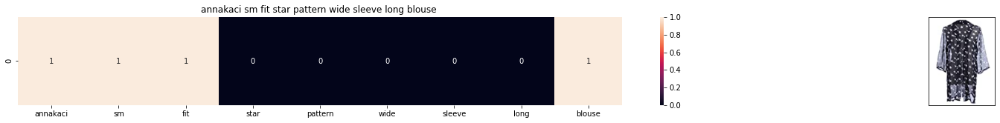

ASIN : B00G5RYY18
Brand: Anna-Kaci
Title: annakaci sm fit star pattern wide sleeve long blouse 
Euclidean similarity with the query image : 3.605551275463989


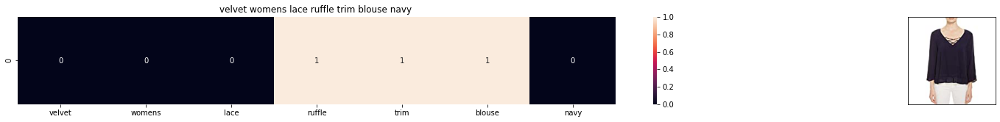

ASIN : B06XCZGQLP
Brand: Velvet by Graham & Spencer
Title: velvet womens lace ruffle trim blouse navy 
Euclidean similarity with the query image : 3.605551275463989


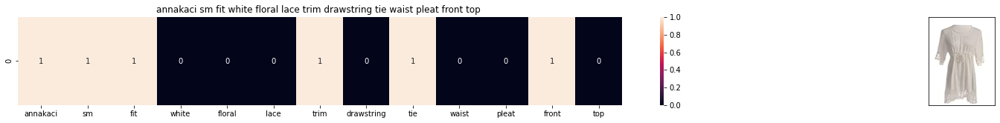

ASIN : B00DW1NKSS
Brand: Anna-Kaci
Title: annakaci sm fit white floral lace trim drawstring tie waist pleat front top 
Euclidean similarity with the query image : 3.605551275463989


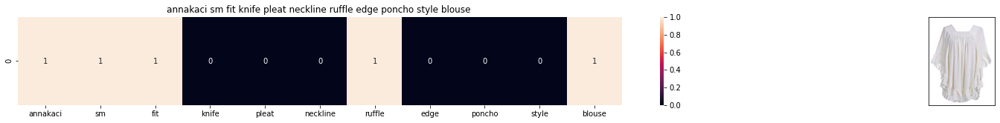

ASIN : B00HCNNOJW
Brand: Anna-Kaci
Title: annakaci sm fit knife pleat neckline ruffle edge poncho style blouse 
Euclidean similarity with the query image : 3.605551275463989


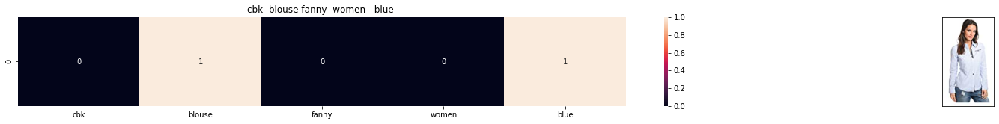

ASIN : B071NDX99J
Brand: CBK
Title: cbk  blouse fanny  women   blue 
Euclidean similarity with the query image : 3.605551275463989


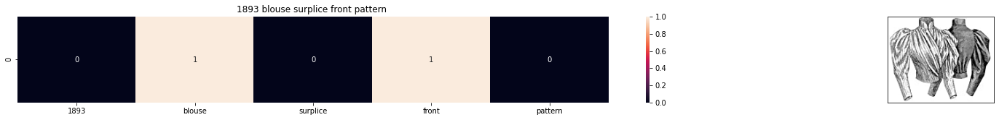

ASIN : B00886YXL0
Brand: Ageless Patterns
Title: 1893 blouse surplice front pattern 
Euclidean similarity with the query image : 3.605551275463989


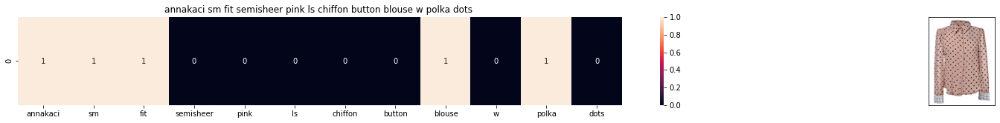

ASIN : B008Z5ST3C
Brand: Anna-Kaci
Title: annakaci sm fit semisheer pink ls chiffon button blouse w polka dots 
Euclidean similarity with the query image : 3.605551275463989


In [ ]:
def bag_of_words_model(doc_id, num_results):
    # doc_id: apparel's id in given corpus
    
    # pairwise_dist will store the distance from given input apparel to all remaining apparels
    # the metric we used here is cosine, the coside distance is mesured as K(X, Y) = <X, Y> / (||X||*||Y||)
    # http://scikit-learn.org/stable/modules/metrics.html#cosine-similarity
    # dist(x, y) = sqrt(dot(x, x) - 2 * dot(x, y) + dot(y, y))
    pairwise_dist = pairwise_distances(title_features,title_features[doc_id])
    
    # np.argsort will return indices of the smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #before we have indices of title feature but we need data frame indices of the 20 smallest distace's
    df_indices = list(data.index[indices])
    
    for i in range(0,len(indices)):
        # we will pass 1. doc_id, 2. title1, 3. title2, url, model
        get_result(indices[i],data['title'].loc[df_indices[0]], data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], 'bag_of_words')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print ('Brand:', data['brand'].loc[df_indices[i]])
        print ('Title:', data['title'].loc[df_indices[i]])
        print ('Euclidean similarity with the query image :', pdists[i])
        print('='*60)

#call the bag-of-words model for a product to get similar products.
bag_of_words_model(931, 20) # change the index if you want to.

## 7.TFIDF based product similarity

In [ ]:
tfidf_title_vectorizer = TfidfVectorizer(min_df=0)
tfidf_title_features = tfidf_title_vectorizer.fit_transform(data['title'])
print(tfidf_title_features.shape)

(16042, 12609)


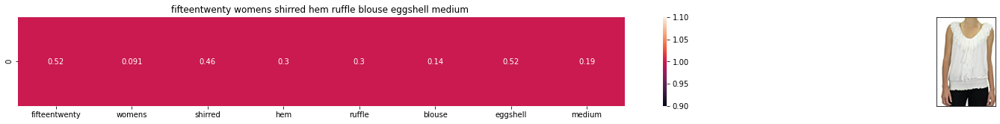

ASIN: B01I5GRO18
Brand: FIFTEEN TWENTY
Euclidean dist from the given image: 1.3335138834477849


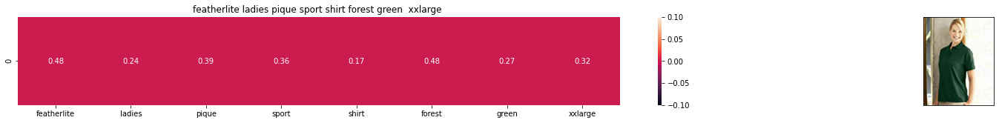

ASIN: B003BSPZ5I
Brand: FeatherLite
Euclidean dist from the given image: 1.3655115587313478


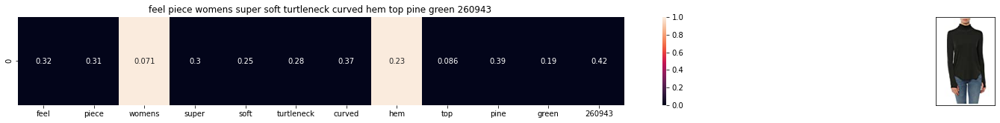

ASIN: B01MS8J0HE
Brand: Feel The Piece
Euclidean dist from the given image: 1.379951505811501


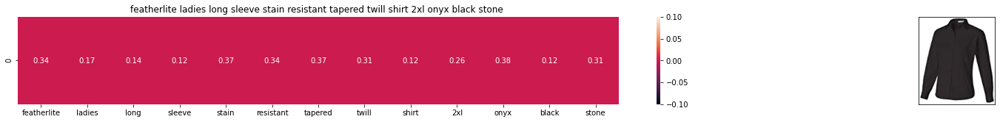

ASIN: B004GSI2OS
Brand: FeatherLite
Euclidean dist from the given image: 1.4142135623730951


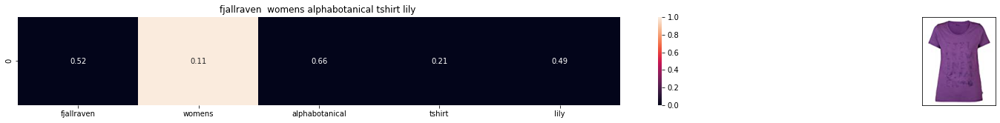

ASIN: B073WKCX36
Brand: Fjallraven
Euclidean dist from the given image: 1.4142135623730951


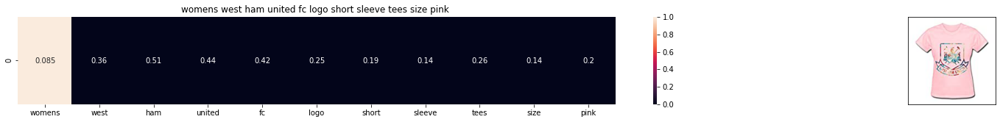

ASIN: B015K88D78
Brand: Fire-Dog-Custom Tees
Euclidean dist from the given image: 1.4142135623730951


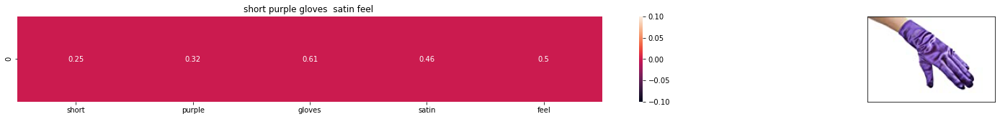

ASIN: B002ZZT446
Brand: Florida Hat Company
Euclidean dist from the given image: 1.4142135623730951


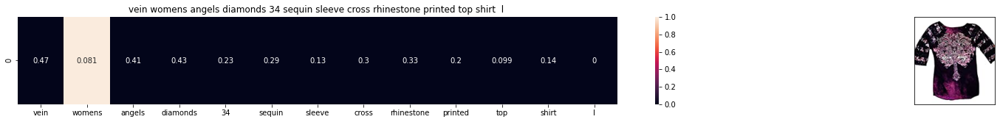

ASIN: B01NAZ3L3C
Brand: Fifth Degree
Euclidean dist from the given image: 1.4142135623730951


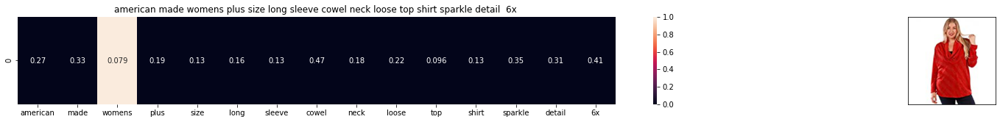

ASIN: B01MAWUZB7
Brand: Fifth Degree
Euclidean dist from the given image: 1.4142135623730951


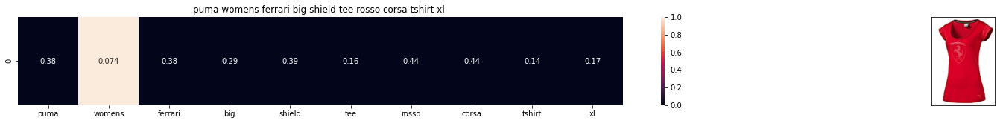

ASIN: B011JQWCCM
Brand: Ferrari
Euclidean dist from the given image: 1.4142135623730951


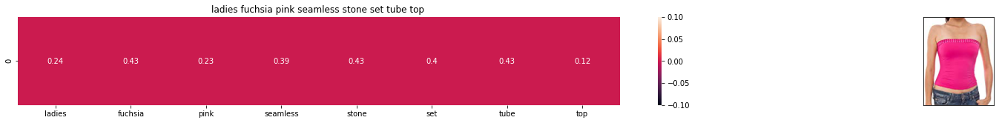

ASIN: B0079QXJ3S
Brand: FineBrandShop
Euclidean dist from the given image: 1.4142135623730951


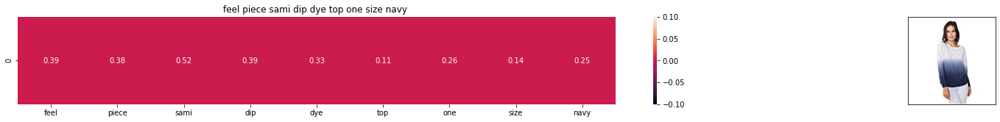

ASIN: B011YPK0MW
Brand: Feel The Piece
Euclidean dist from the given image: 1.4142135623730951


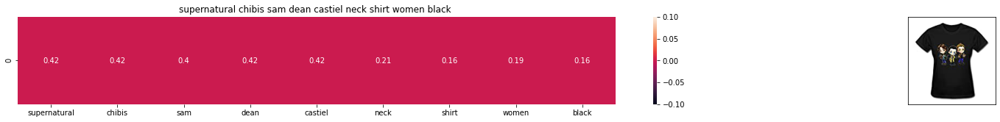

ASIN: B014ICB9A0
Brand: FNC7C
Euclidean dist from the given image: 1.4142135623730951


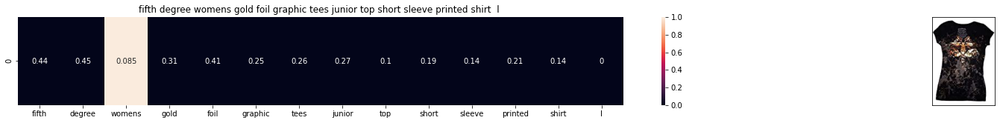

ASIN: B01NACPBG2
Brand: Fifth Degree
Euclidean dist from the given image: 1.4142135623730951


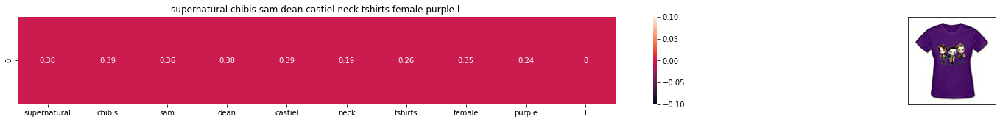

ASIN: B014ICEJ1Q
Brand: FNC7C
Euclidean dist from the given image: 1.4142135623730951


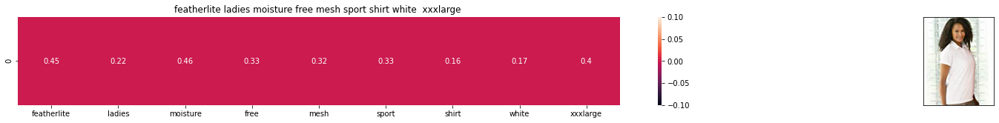

ASIN: B003BSRPB0
Brand: FeatherLite
Euclidean dist from the given image: 1.4142135623730951


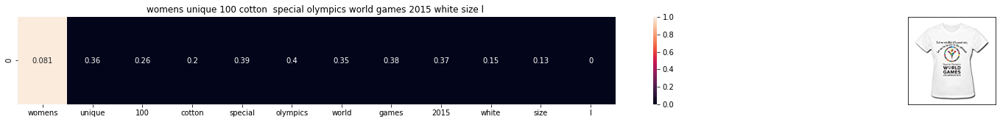

ASIN: B012YX2ZPI
Brand: HX-Kingdom Fashion T-shirts
Euclidean dist from the given image: 1.4142135623730951


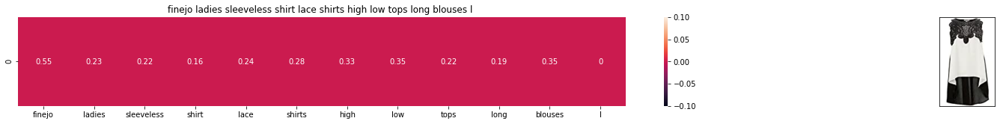

ASIN: B00R7DO9ZA
Brand: Finejo
Euclidean dist from the given image: 1.4142135623730951


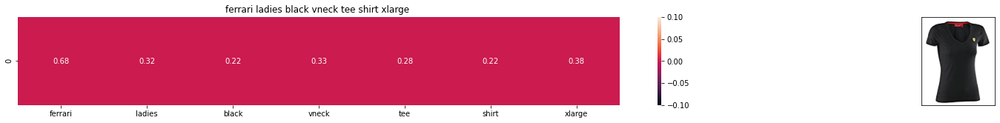

ASIN: B01EZ6XKR4
Brand: Ferrari
Euclidean dist from the given image: 1.4142135623730951


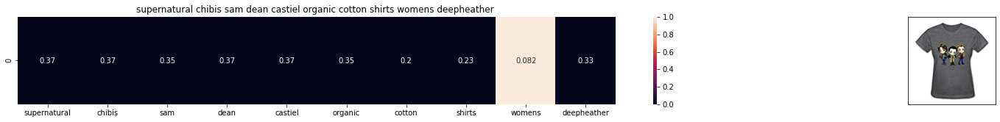

ASIN: B014ICD9YO
Brand: FNC7C
Euclidean dist from the given image: 1.4142135623730954


In [ ]:
def tfidf_model(doc_id, num_results):
    pairwise_dist = pairwise_distances(tfidf_title_features, tfidf_title_features[doc_id])
    indices = np.argsort(pairwise_dist.flatten()[0:num_results])
    pdist = np.sort(pairwise_dist.flatten()[0:num_results])

    #dataframe indices of 9 smallest indices
    df_indices = list(data.index[indices])

    for i in range(0, len(indices)):
        get_result(indices[i], data['title'].loc[df_indices[0]], data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], 'tfidf')
        print('ASIN:', data['asin'].loc[df_indices[i]])
        print('Brand:', data['brand'].loc[df_indices[i]])
        print('Euclidean dist from the given image:', pdist[i])
        print('='*100)
tfidf_model(931, 20)

## 8.IDF based product similarity
- IDF = log(no of docs)/(no of docs which has given word)

In [ ]:
idf_title_vectorizer = CountVectorizer()
idf_title_features = idf_title_vectorizer.fit_transform(data['title'])

In [ ]:
#to find the given_word (word) is there in given title and if it is there and find the sum of it
def n_containing(word):
    return sum(1 for title in data['title'] if word in title.split())

In [ ]:
#finding the idf of the word
def idf(word):
    return math.log(data.shape[0]/n_containing(word))

In [ ]:
#convert the idf features into float
idf_title_features = idf_title_features.astype(np.float)

#get the individual word and find the idf of the word
for i in idf_title_vectorizer.vocabulary_.keys():
    idf_val = idf(i)

#now replace the count values to idf values of each word in idf_title_features
# idf_title_features[:, idf_title_vectorizer.vocabulary_[i]].nonzero()[0] will return all documents in which the word i present
for j in idf_title_features[:,idf_title_vectorizer.vocabulary_[i]].nonzero()[0]:

    # we replace the count values of word i in document j with  idf_value of word i 
    # idf_title_features[doc_id, index_of_word_in_courpus] = idf value of word
    idf_title_features[j,idf_title_vectorizer.vocabulary_[i]] = idf_val

[  931 15136  4906  1074  5550 12552 15474  5103   241  6068 11004 14620
  1136 15477 14982  5577 15683 14131 15401 15385]
[11150, 172803, 49167, 13094, 55268, 141839, 175539, 51003, 2806, 59328, 122389, 167552, 13788, 175558, 171698, 55433, 178040, 161299, 175007, 174843]


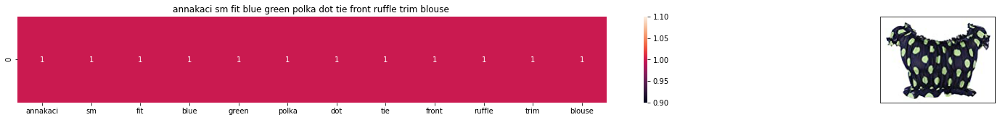

ASIN : B00KLHUIBS
Brand : Anna-Kaci
euclidean distance from the given image : 0.0


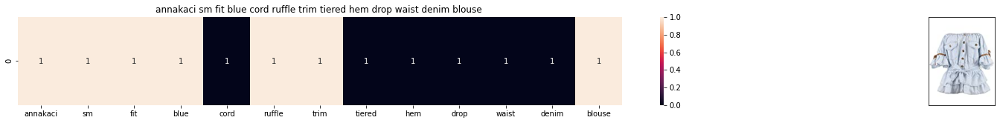

ASIN : B0759G15ZX
Brand : Anna-Kaci
euclidean distance from the given image : 3.3166247903554


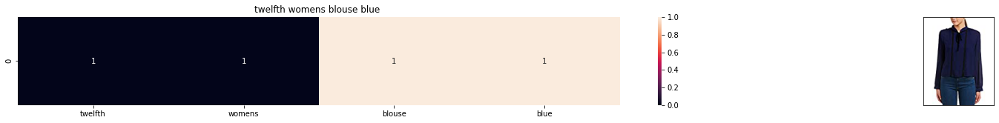

ASIN : B074F5BP5F
Brand : On Twelfth
euclidean distance from the given image : 3.4641016151377544


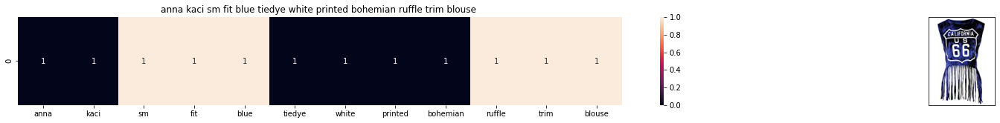

ASIN : B00YQ8S4K0
Brand : Anna-Kaci
euclidean distance from the given image : 3.4641016151377544


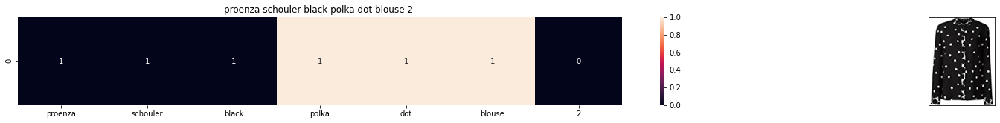

ASIN : B074TLHLMN
Brand : Proenza Schouler
euclidean distance from the given image : 3.4641016151377544


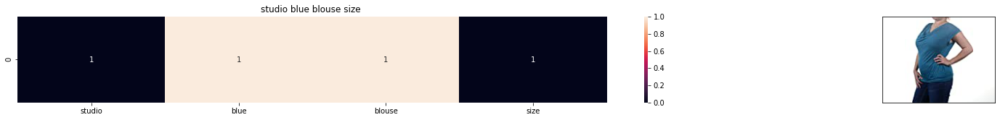

ASIN : B016P80OKQ
Brand : Studio M
euclidean distance from the given image : 3.4641016151377544


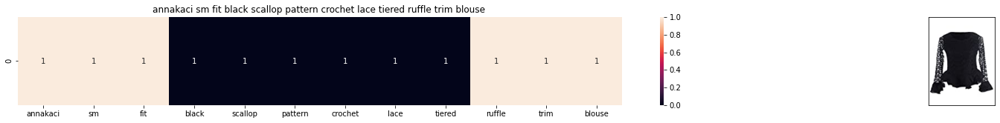

ASIN : B00O194W8W
Brand : Anna-Kaci
euclidean distance from the given image : 3.4641016151377544


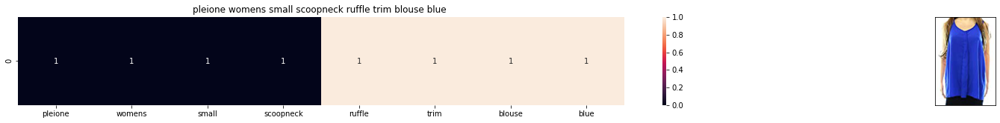

ASIN : B072VHTT1D
Brand : Pleione
euclidean distance from the given image : 3.4641016151377544


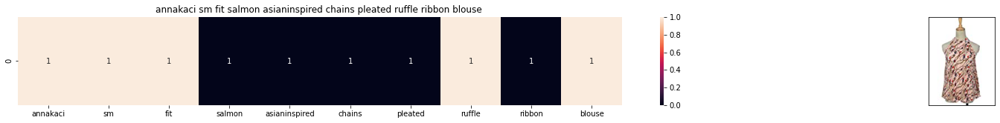

ASIN : B007KSG42S
Brand : Anna-Kaci
euclidean distance from the given image : 3.4641016151377544


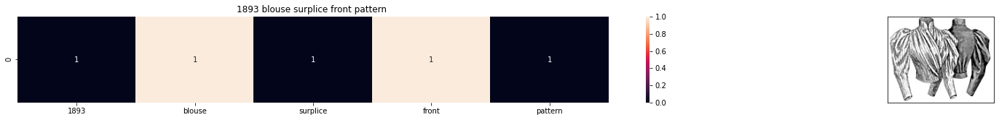

ASIN : B00886YXL0
Brand : Ageless Patterns
euclidean distance from the given image : 3.605551275463989


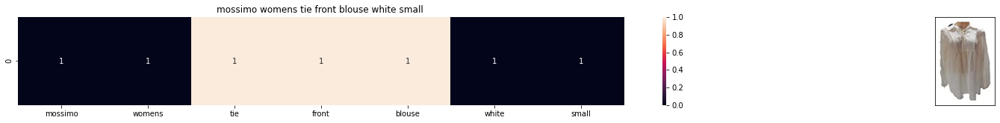

ASIN : B07111HHX6
Brand : Mossimo
euclidean distance from the given image : 3.605551275463989


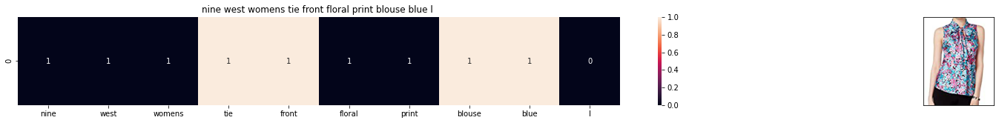

ASIN : B06WW5C6NJ
Brand : Nine West
euclidean distance from the given image : 3.605551275463989


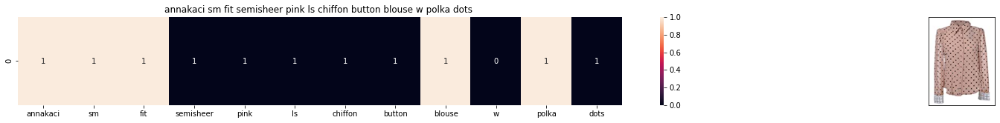

ASIN : B008Z5ST3C
Brand : Anna-Kaci
euclidean distance from the given image : 3.605551275463989


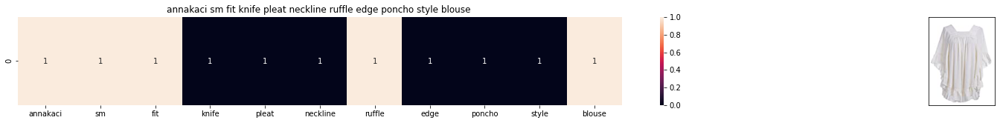

ASIN : B00HCNNOJW
Brand : Anna-Kaci
euclidean distance from the given image : 3.605551275463989


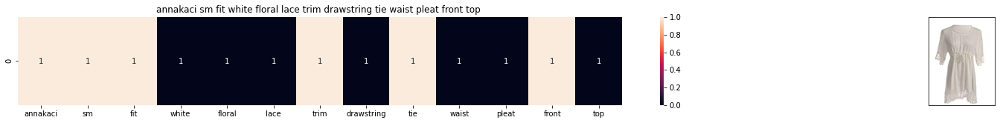

ASIN : B00DW1NKSS
Brand : Anna-Kaci
euclidean distance from the given image : 3.605551275463989


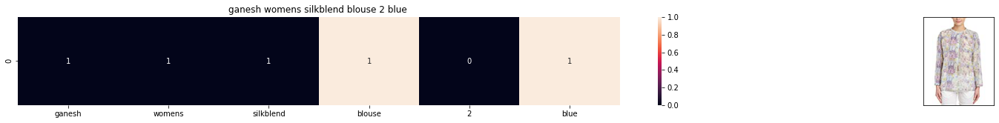

ASIN : B01N3SAT1F
Brand : Ganesh
euclidean distance from the given image : 3.605551275463989


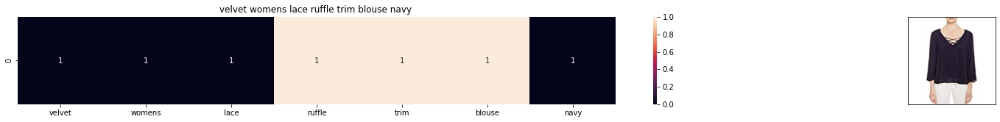

ASIN : B06XCZGQLP
Brand : Velvet by Graham & Spencer
euclidean distance from the given image : 3.605551275463989


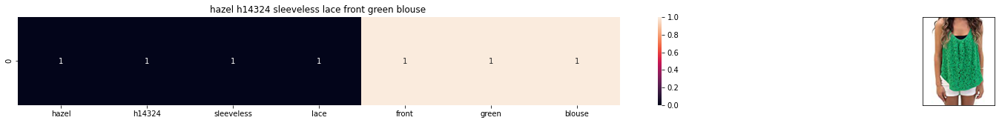

ASIN : B01EAV57MA
Brand : Hazel H14324 Sleeveless Lace Front Green Blouse
euclidean distance from the given image : 3.605551275463989


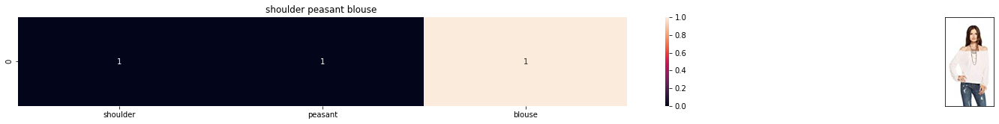

ASIN : B01E1QD5PK
Brand : CHASER
euclidean distance from the given image : 3.605551275463989


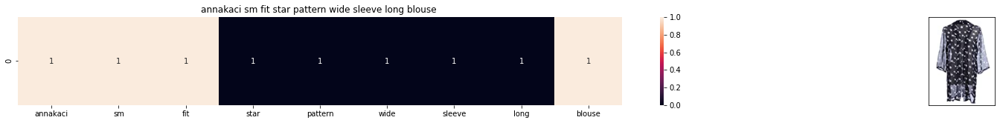

ASIN : B00G5RYY18
Brand : Anna-Kaci
euclidean distance from the given image : 3.605551275463989


In [ ]:
def idf_model(doc_id, num_results):
    pairwise_dist = pairwise_distances(idf_title_features, idf_title_features[doc_id]) 
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    pdists = np.sort(pairwise_dist.flatten())[0:num_results]

    df_indices = list(data.index[indices])
    print(indices)
    print(df_indices)
    for i in range(len(indices)):
        get_result(indices[i],data['title'].loc[df_indices[0]], data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], 'idf')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print('Brand :',data['brand'].loc[df_indices[i]])
        print ('euclidean distance from the given image :', pdists[i])
        print('='*100)
idf_model(931,20)

## 9.Text Semantics for title similarity

In [ ]:

# credits: https://www.kaggle.com/c/word2vec-nlp-tutorial#part-2-word-vectors
# Custom Word2Vec using your own text data.
# Do NOT RUN this code.
# It is meant as a reference to build your own Word2Vec when you have 
# lots of data.

'''
# Set values for various parameters
num_features = 300    # Word vector dimensionality                      
min_word_count = 1    # Minimum word count                        
num_workers = 4       # Number of threads to run in parallel
context = 10          # Context window size                                                                                    
downsampling = 1e-3   # Downsample setting for frequent words

# Initialize and train the model (this will take some time)
from gensim.models import word2vec
print ("Training model...")
model = word2vec.Word2Vec(sen_corpus, workers=num_workers, \
            size=num_features, min_count = min_word_count, \
            window = context)
    
'''

In [ ]:
with open('/content/drive/My Drive/*Assign 26 - Apparel Recommendation/Copy of word2vec_model', 'rb') as f:
    model = pickle.load(f)

vocab = model.keys()

### 9.1 Word2Vec using glove

In [ ]:
#Display an image
def display_img(url,ax,fig):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))
    plt.imshow(img)

In [ ]:
#get the word_vec using the model from pickle
def get_word_vec(sentence, doc, m_name):# if the word in our courpus is not there in the google word2vec corpus, we are just ignoring it_id, m_name):
    # sentence : title of the apparel
    # doc_id: document id in our corpus
    # m_name: model information it will take two values
        # if  m_name == 'avg', we will append the model[i], w2v representation of word i
        # if m_name == 'weighted', we will multiply each w2v[word] with the idf(word)
    
    vec = []
    for i in sentence.split():
        if i in vocab:
            if m_name=='weighted' and i in idf_title_vectorizer.vocabulary_:
                vec.append(idf_title_features[doc_id, idf_title_vectorizer.vocabulary_[i]]*model[i])
            elif m_name=='avg':
                vec.append(model[i])

        else:
            vec.append(zp.zeros(shape=(300,)))

    # we will return a numpy array of shape (#number of words in title * 300 ) 300 = len(w2v_model[word])
    # each row represents the word2vec representation of each word (weighted/avg) in given sentance 
    return np.array(vec)

### Note:
- pairwise dist is finding the euclidean distance between matrix and the array (ie) u will have a matrix of w2v values of all title and we given a query title and find the distance between titles and the query title and from there we can find the similar products using smaller eucliden distance. This is used here to find the similar products

- But in case of Brand name and color, we are finding the euclidean distance between two vectors (ie) b/w two data point colors in df. This is find here to plot the heatmap

In [ ]:
def get_distance(vec1, vec2):
    # vec1 = np.array(#number_of_words_title1 * 300), each row is a vector of length 300 corresponds to each word in give title
    # vec2 = np.array(#number_of_words_title2 * 300), each row is a vector of length 300 corresponds to each word in give title

    final_dist = []  # for each vector in vec1 we caluclate the distance(euclidean) to all vectors in vec2
    for i in vec1:
        dist = []
        for j in vec2:
            # np.linalg.norm(i-j) will result the euclidean distance between vectors i, j
            dist.append(np.linalg.norm(i-j)) 

        final_dist.append(np.array(dist))
    return final_dist 

In [ ]:
def heat_map_w2v(sentence1, sentence2, url, doc_id1, doc_id2, model):
    # sentence1 : title1, input apparel
    # sentence2 : title2, recommended apparel
    # url: apparel image url
    # doc_id1: document id of input apparel
    # doc_id2: document id of recommended apparel
    # model: it can have two values, 1. avg 2. weighted
    
    #s1_vec = np.array(#number_of_words_title1 * 300), each row is a vector(weighted/avg) of length 300 corresponds to each word in give title
    s1_vec = get_word_vec(sentence1, doc_id1, model)

    #s2_vec = np.array(#number_of_words_title1 * 300), each row is a vector(weighted/avg) of length 300 corresponds to each word in give title
    s2_vec = get_word_vec(sentence2, doc_id2, model)

    # s1_s2_dist = np.array(#number of words in title1 * #number of words in title2)
    # s1_s2_dist[i,j] = euclidean distance between words i, j
    s1_s2_dist = get_distance(s1_vec, s2_vec)

    # devide whole figure into 2 parts 1st part displays heatmap 2nd part displays image of apparel
    gs = gridspec.GridSpec(2, 2, width_ratios=[4,1],height_ratios=[2,1]) 
    fig = plt.figure(figsize=(15,15))
    
    ax = plt.subplot(gs[0])
    # ploting the heap map based on the pairwise distances
    ax = sns.heatmap(np.round(s1_s2_dist,4), annot=True)
    # set the x axis labels as recommended apparels title
    ax.set_xticklabels(sentence2.split())
    # set the y axis labels as input apparels title
    ax.set_yticklabels(sentence1.split())
    # set title as recommended apparels title
    ax.set_title(sentence2)
    
    ax = plt.subplot(gs[1])
    # we remove all grids and axis labels for image
    ax.grid(False)
    ax.set_xticks([])
    ax.set_yticks([])
    display_img(url, ax, fig)
    
    plt.show()

### 9.2 Similarity based on AvgW2V

In [ ]:
# this function will add the vectors of each word and returns the avg vector of given sentance
def build_avg_w2v(sentence, num_features, doc_id, m_name):
    # sentence: its title of the apparel
    # num_features: the length of word2vec vector, its values = 300
    # m_name: model information it will take two values
        # if  m_name == 'avg', we will append the model[i], w2v representation of word i
        # if m_name == 'weighted', we will multiply each w2v[word] with the idf(word)
    featureVec = np.zeros((num_features,), dtype='float32')

    nwords = 0
    for word in sentence.split():
        nwords += 1
        if word in vocab:
            if m_name == 'avg':
                featureVec = np.add(featureVec, model[word])

            elif m_name == 'weighted' and word in idf_title_vectorizer.vocabulary_:  #here idf_title_vectorizer is nothing but count vectorizer
                featureVec = np.add(featureVec, idf_title_features[doc_id, idf_title_vectorizer.vocabulary_[word]*model[word]])
        if (nwords>0):
            # returns the avg vector of given sentance, its of shape (1, 300)
            featureVec = np.divide(featureVec, nwords)

    return featureVec

In [ ]:
doc_id = 0
w2v_title = []

#for each sentence build avg_w2v for it
for i in data['title']:
    w2v_title.append(build_avg_w2v(i, 300, doc_id, 'avg'))

w2v_title = np.array(w2v_title)

In [ ]:
a = [3,2,4,5]
print(data.index[a])

Int64Index([27, 15, 46, 60], dtype='int64')


[142055, 160670, 135891, 147862, 68773, 99739, 116737, 136502, 160819, 51949, 40366, 77322, 39309, 87809, 128560, 65907, 175759, 12210, 116605, 41710]


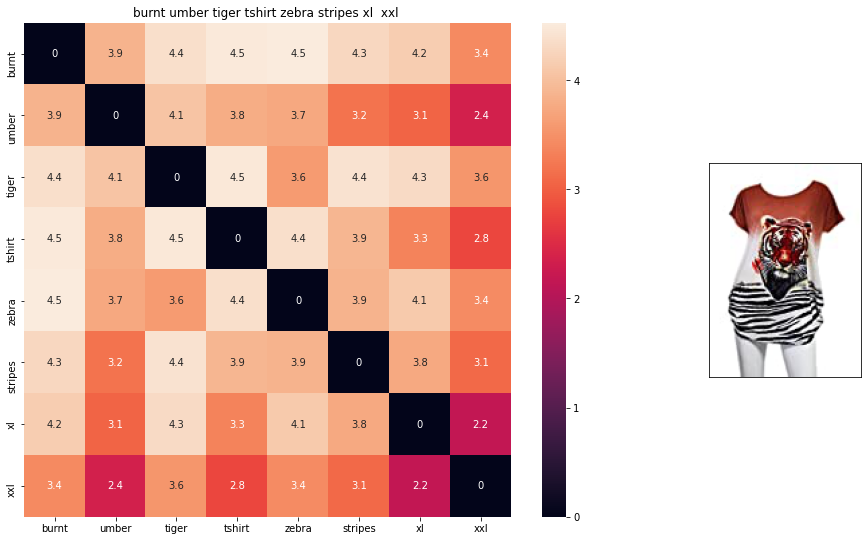

ASIN: B00JXQB5FQ
BRAND: Si Row
euclidean distance from given input image: 0.0


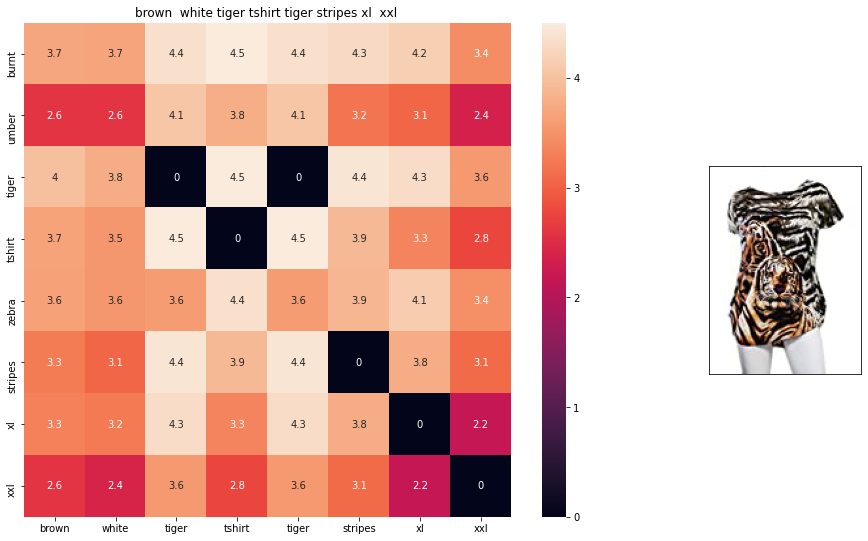

ASIN: B00JXQCWTO
BRAND: Si Row
euclidean distance from given input image: 0.0021298293


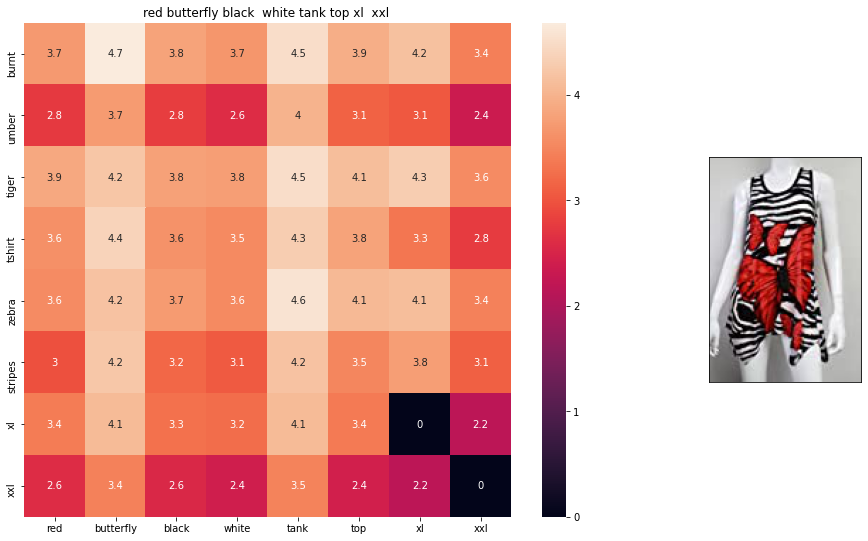

ASIN: B00JV63CW2
BRAND: Si Row
euclidean distance from given input image: 0.0111593865


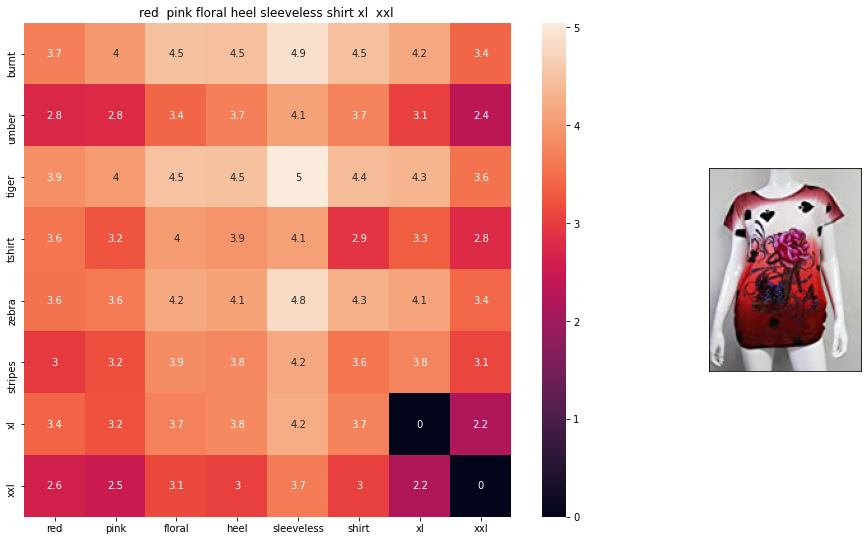

ASIN: B00JV63QQE
BRAND: Si Row
euclidean distance from given input image: 0.011563186


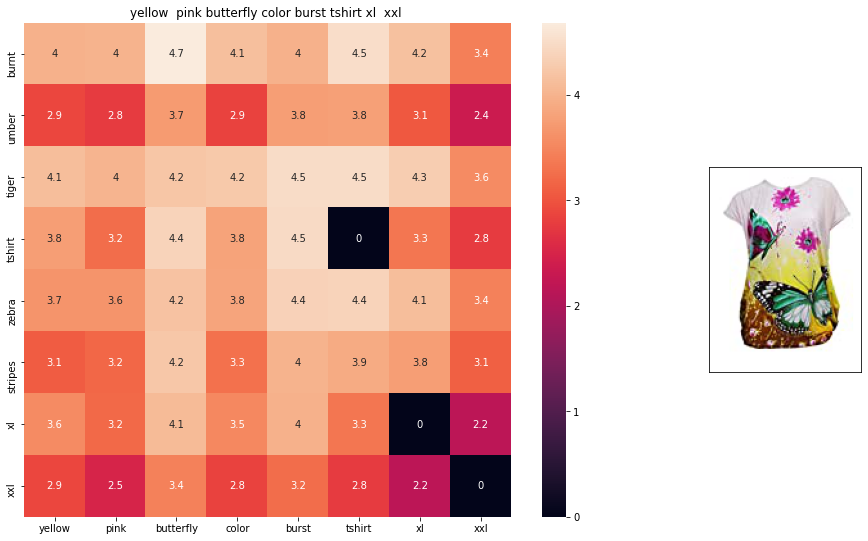

ASIN: B00JXQBBMI
BRAND: Si Row
euclidean distance from given input image: 0.011595066


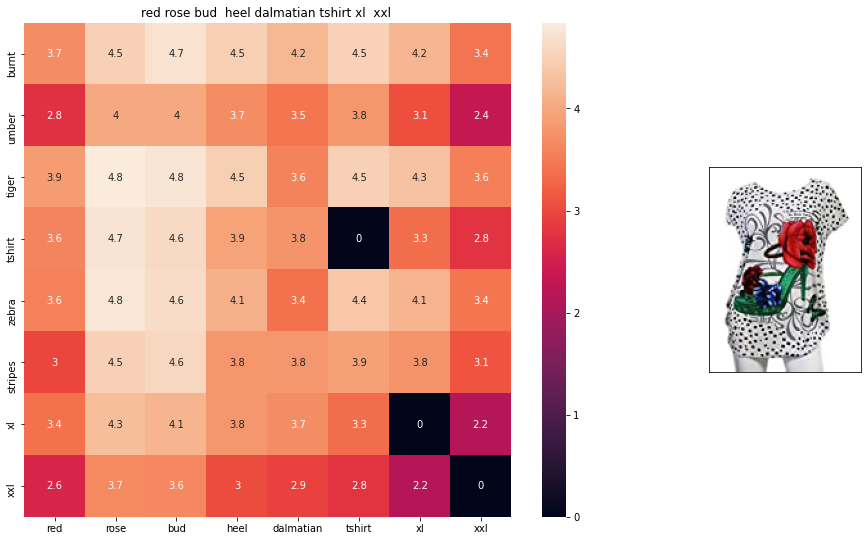

ASIN: B00JXQABB0
BRAND: Si Row
euclidean distance from given input image: 0.011853099


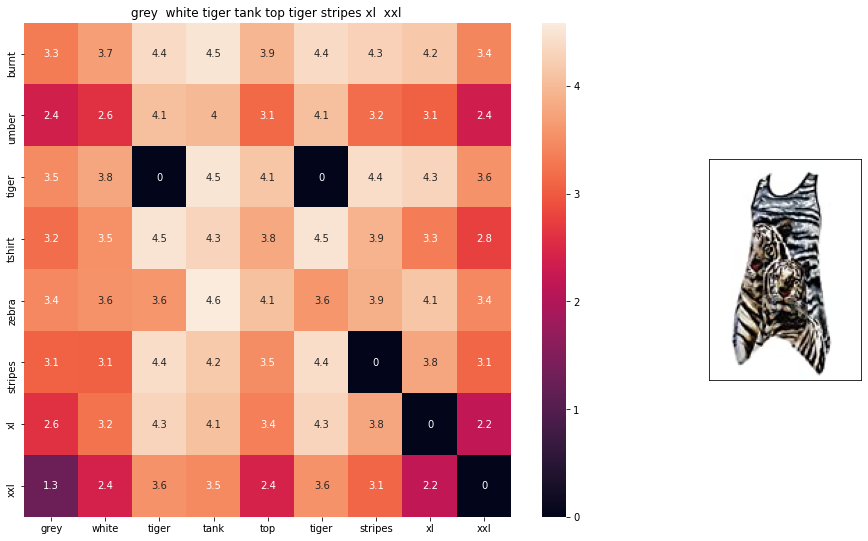

ASIN: B00JXQAFZ2
BRAND: Si Row
euclidean distance from given input image: 0.026211403


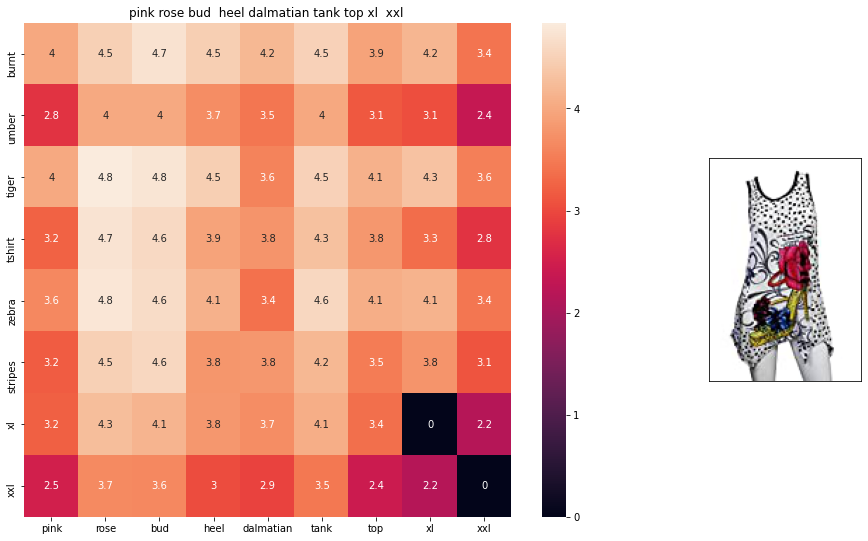

ASIN: B00JXQAX2C
BRAND: Si Row
euclidean distance from given input image: 0.02859099


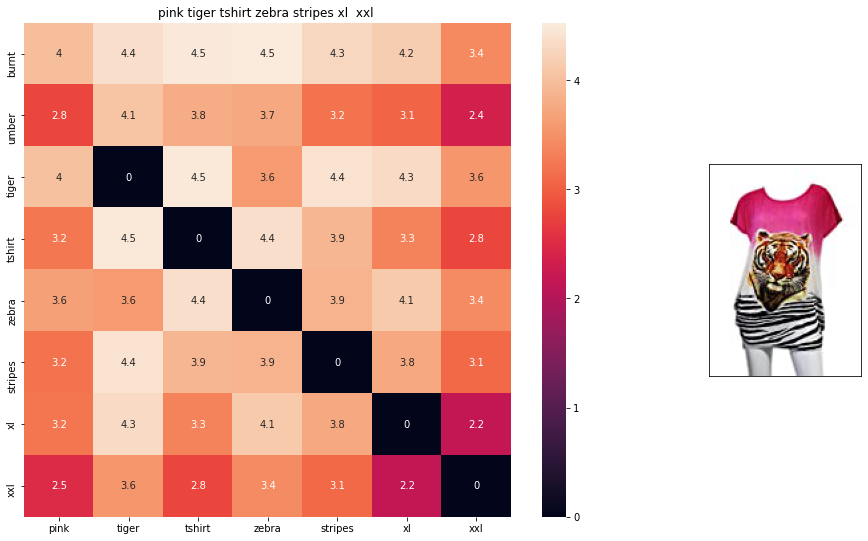

ASIN: B00JXQASS6
BRAND: Si Row
euclidean distance from given input image: 0.036345523


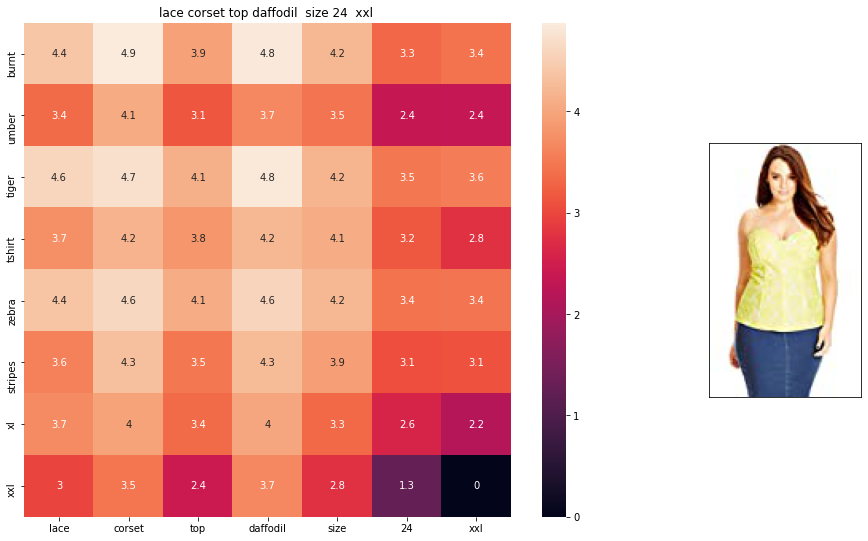

ASIN: B071KCMH3V
BRAND: City Chic
euclidean distance from given input image: 0.039996628


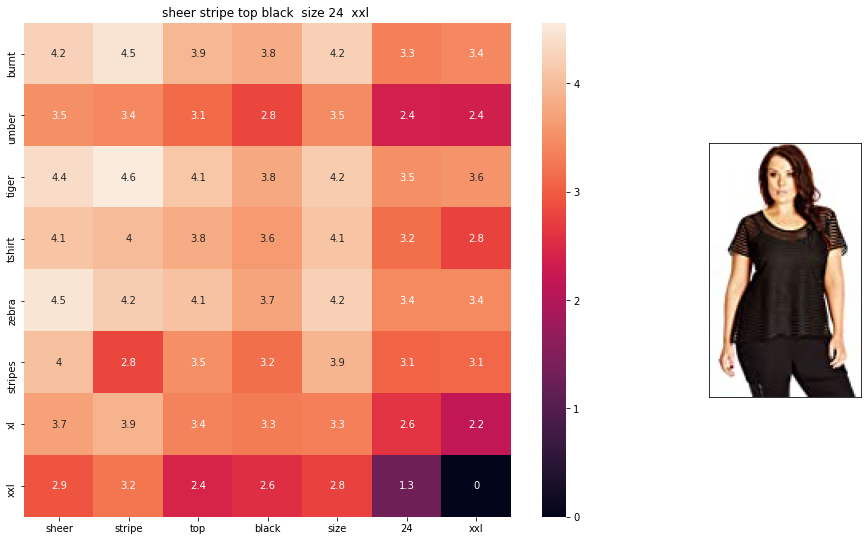

ASIN: B072R3SH6F
BRAND: City Chic
euclidean distance from given input image: 0.040345978


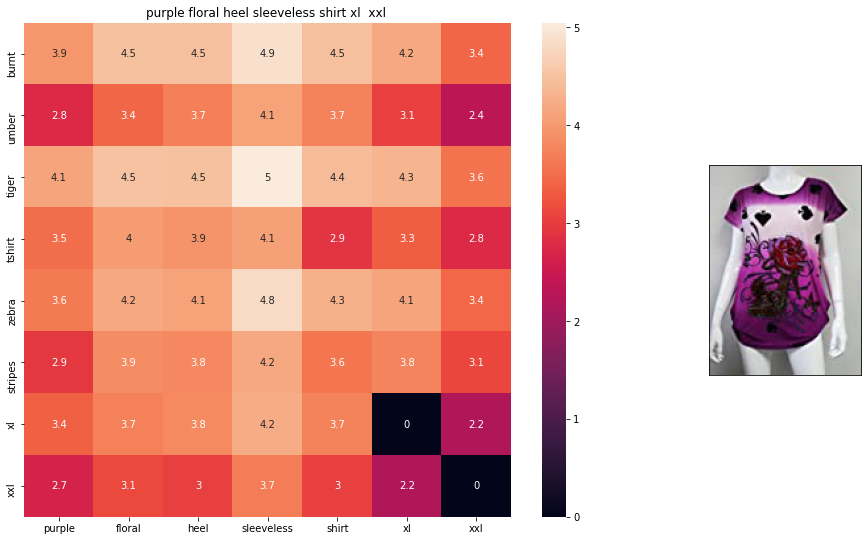

ASIN: B00JV63VC8
BRAND: Si Row
euclidean distance from given input image: 0.040592548


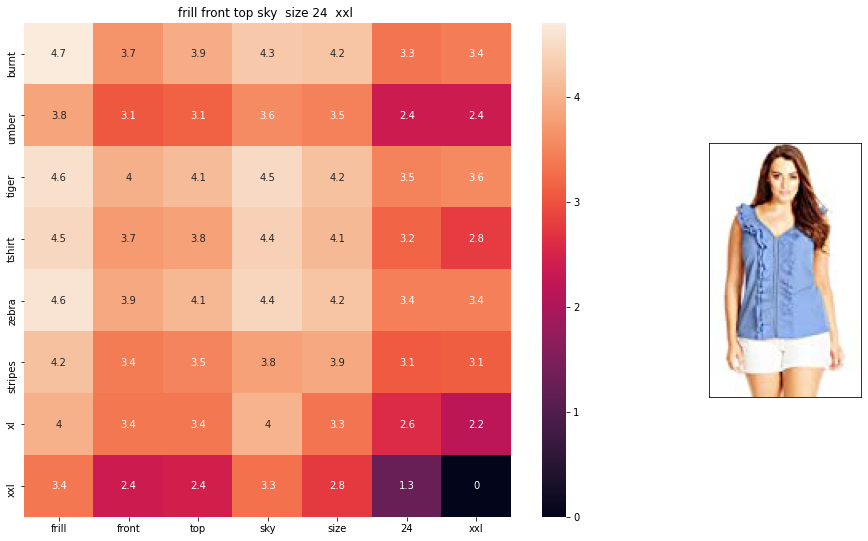

ASIN: B072KLGXX3
BRAND: City Chic
euclidean distance from given input image: 0.040663015


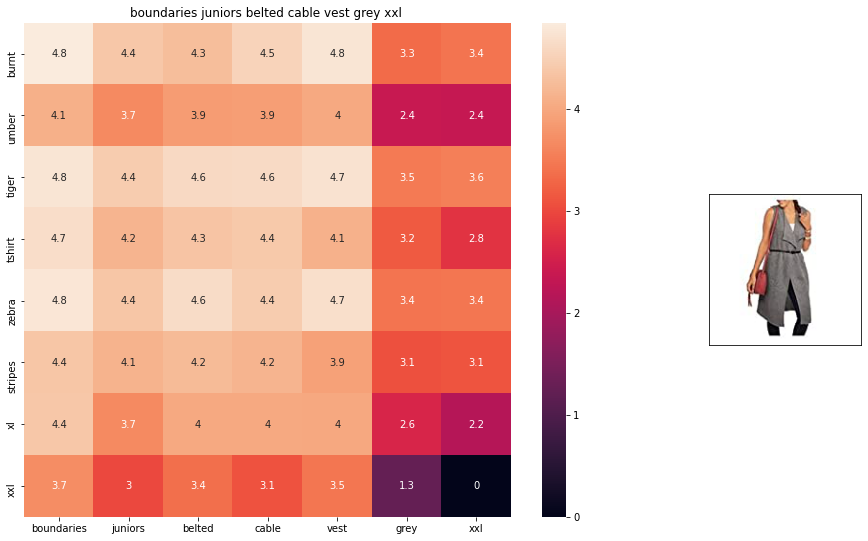

ASIN: B06Y61VH6R
BRAND: No Boundaries
euclidean distance from given input image: 0.04205626


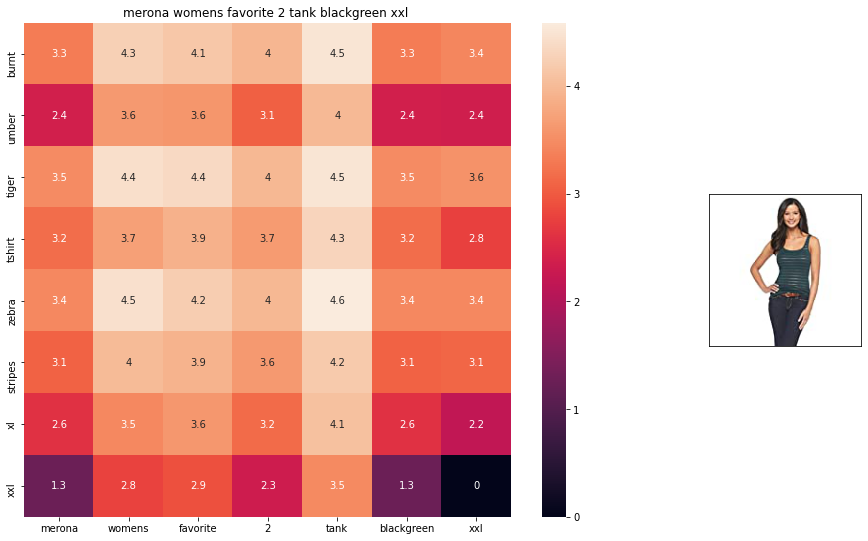

ASIN: B01KB2IW7Y
BRAND: Merona
euclidean distance from given input image: 0.04227717


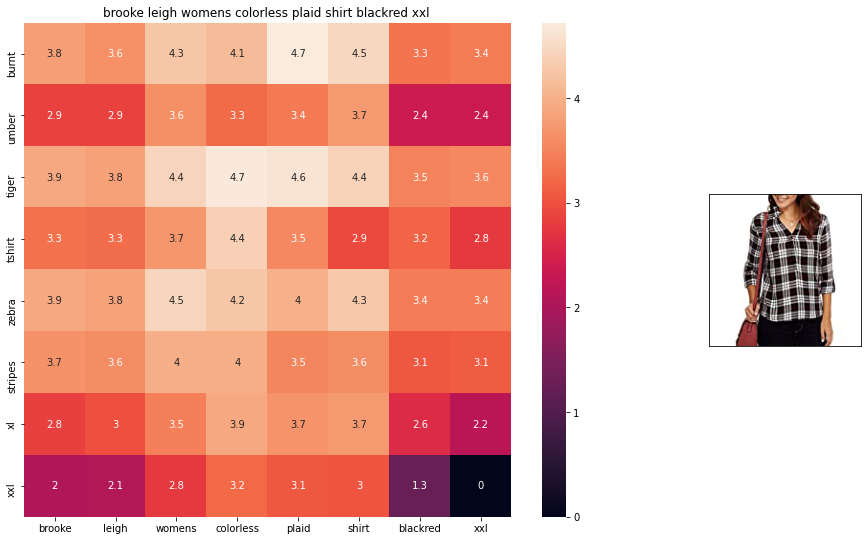

ASIN: B06XT7S61G
BRAND: Brooke Leigh
euclidean distance from given input image: 0.047406085


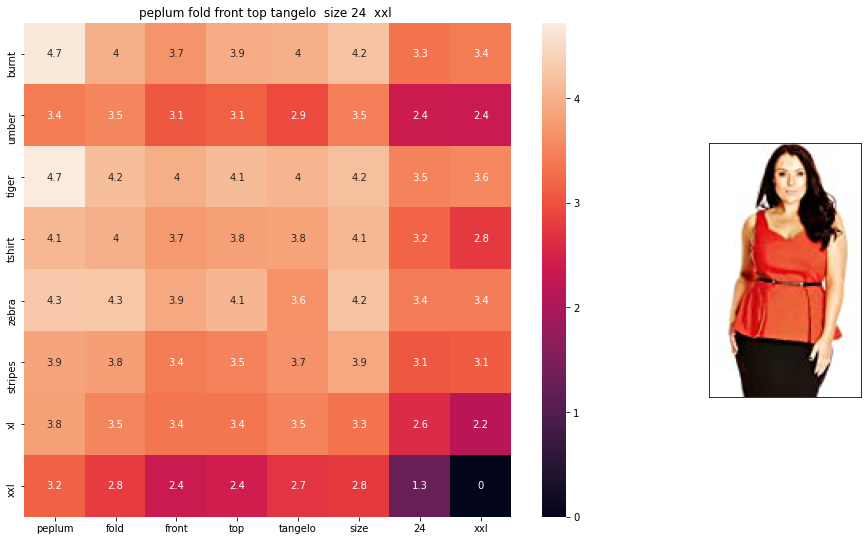

ASIN: B01D011I88
BRAND: City Chic
euclidean distance from given input image: 0.047485348


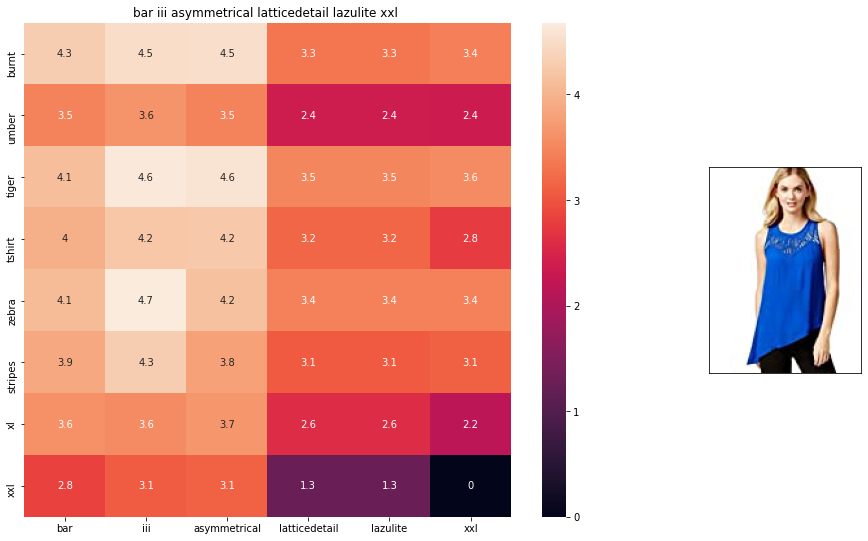

ASIN: B06X173JS4
BRAND: Bar III
euclidean distance from given input image: 0.048038494


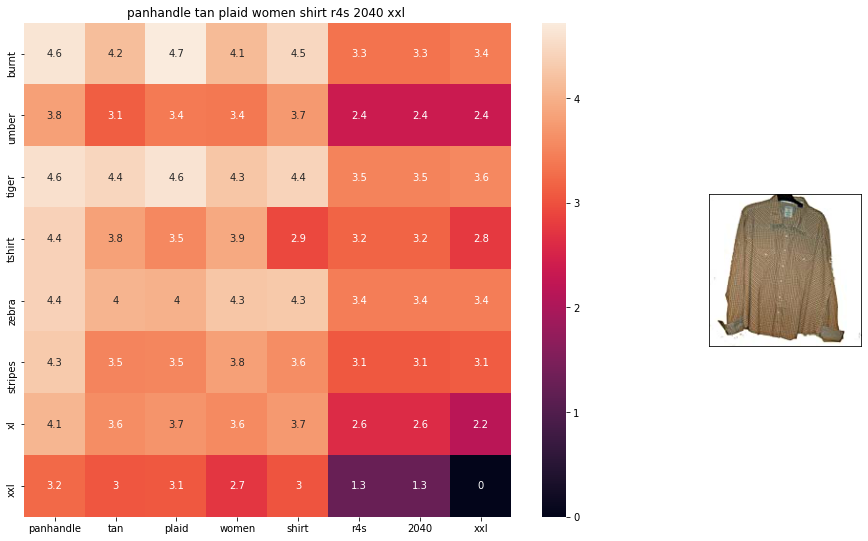

ASIN: B01MR0WLX8
BRAND: Panhandle
euclidean distance from given input image: 0.048658203


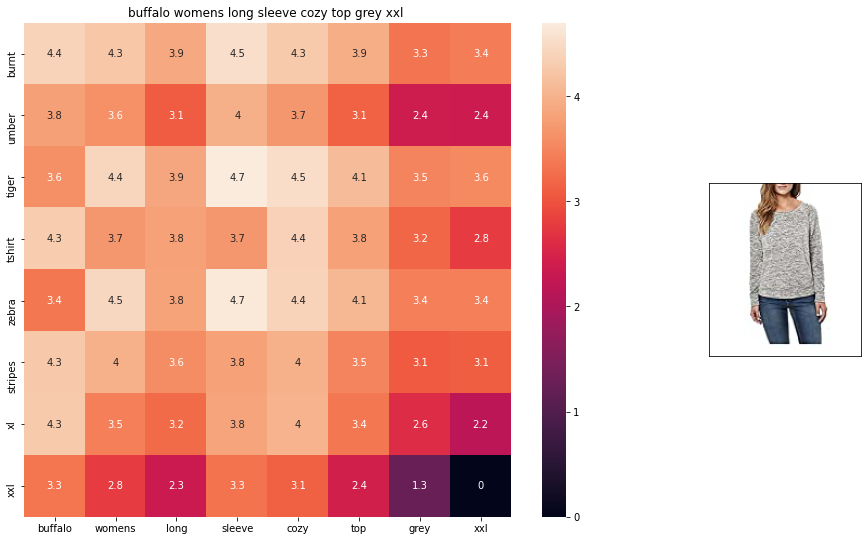

ASIN: B01N4VRD5I
BRAND: Buffalo by David Biton
euclidean distance from given input image: 0.049147494


In [ ]:
def avg_w2v_model(doc_id, num_results):
    # doc_id: apparel's id in given corpus
    # dist(x, y) = sqrt(dot(x, x) - 2 * dot(x, y) + dot(y, y))
    pairwise_dist = pairwise_distances(w2v_title, w2v_title[doc_id].reshape(1,-1))
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    pdists = np.sort(pairwise_dist.flatten())[0:num_results]
    df_indices = list(data.index[indices])
    print(df_indices)
    for i in range(len(indices)):
        heat_map_w2v(data['title'].loc[df_indices[0]], data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], indices[0], indices[i], 'avg')
        print('ASIN:', data['asin'].loc[df_indices[i]])
        print('BRAND:', data['brand'].loc[df_indices[i]])
        print('euclidean distance from given input image:', pdists[i])
        print('='*125)

avg_w2v_model(12566, 20)

### 9.3 IDF-W2V similarity

In [ ]:
doc_id = 0
w2v_title_weight = []
for i in data['title']:
    w2v_title_weight.append(build_avg_w2v(i, 300, doc_id, 'weighted'))
    doc_id += 1

w2v_title_weight = np.array(w2v_title_weight)

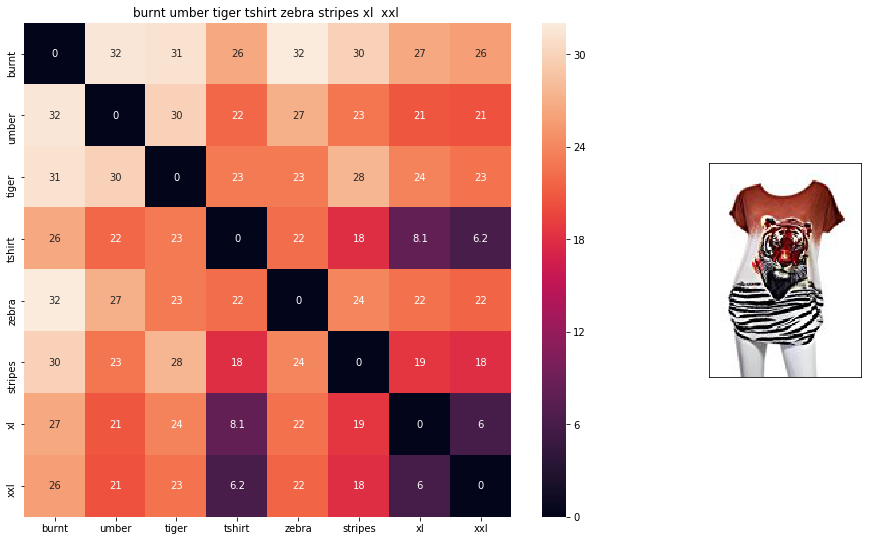

ASIN : B00JXQB5FQ
Brand : Si Row
euclidean distance from input : 0.00390625


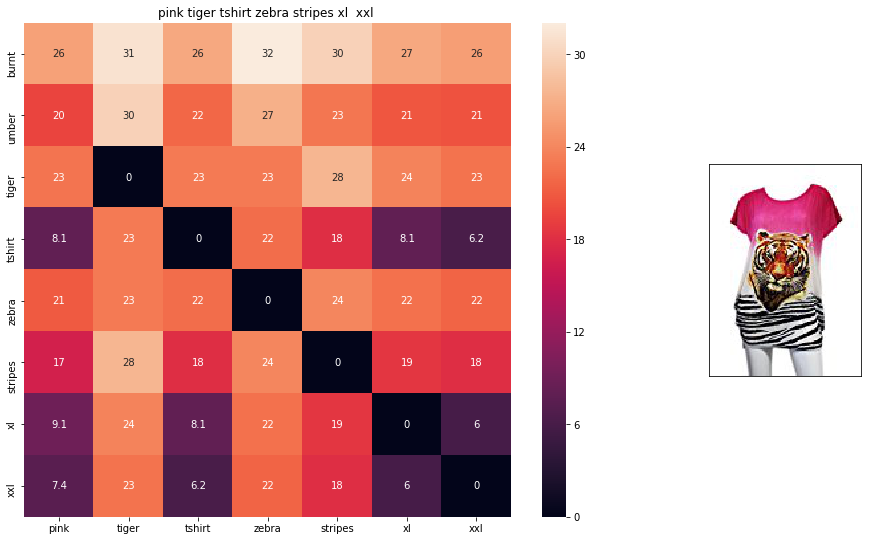

ASIN : B00JXQASS6
Brand : Si Row
euclidean distance from input : 4.06389


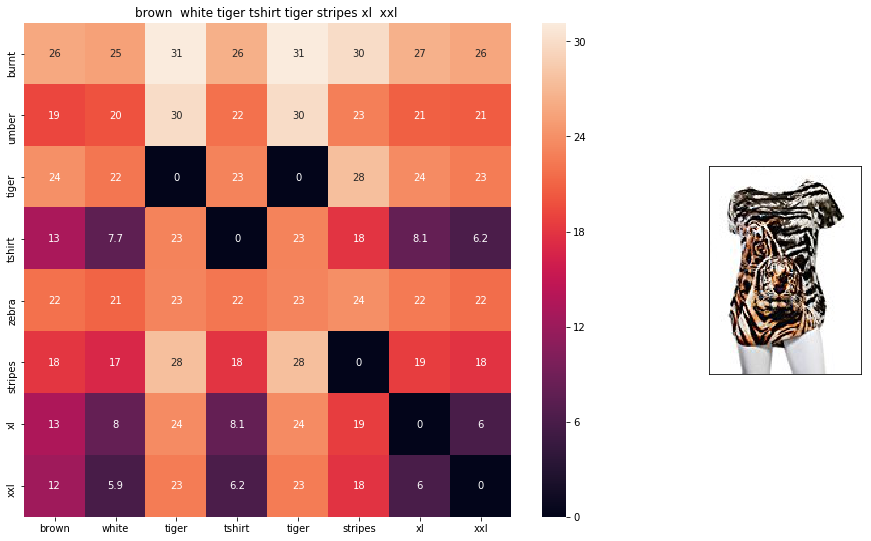

ASIN : B00JXQCWTO
Brand : Si Row
euclidean distance from input : 4.77094


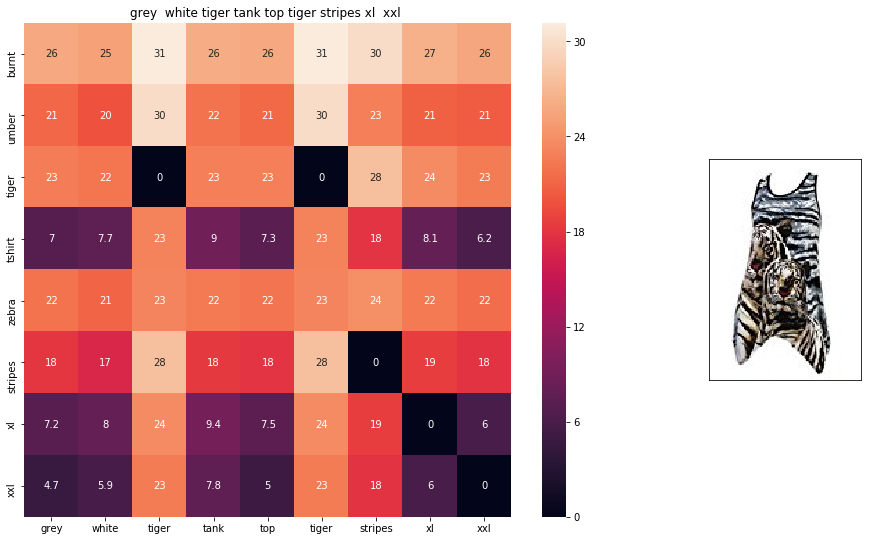

ASIN : B00JXQAFZ2
Brand : Si Row
euclidean distance from input : 5.36016


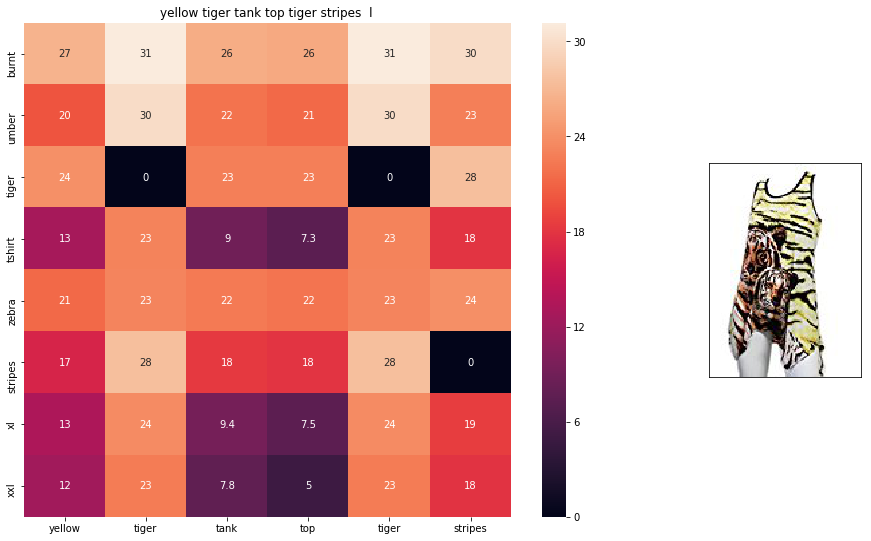

ASIN : B00JXQAUWA
Brand : Si Row
euclidean distance from input : 5.68952


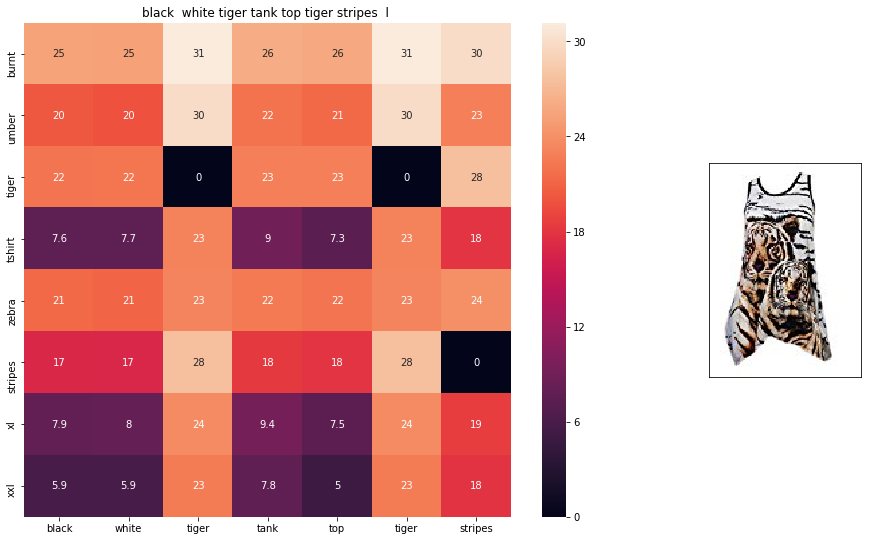

ASIN : B00JXQAO94
Brand : Si Row
euclidean distance from input : 5.69302


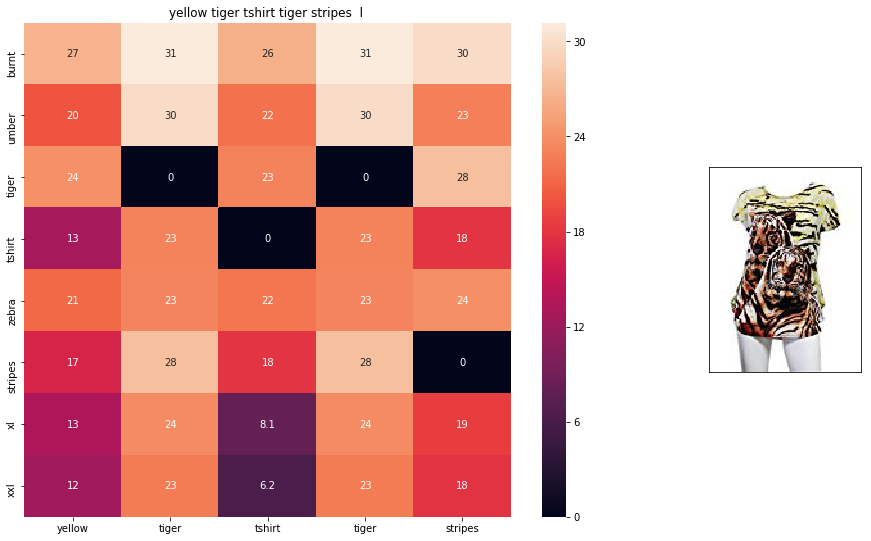

ASIN : B00JXQCUIC
Brand : Si Row
euclidean distance from input : 5.89344


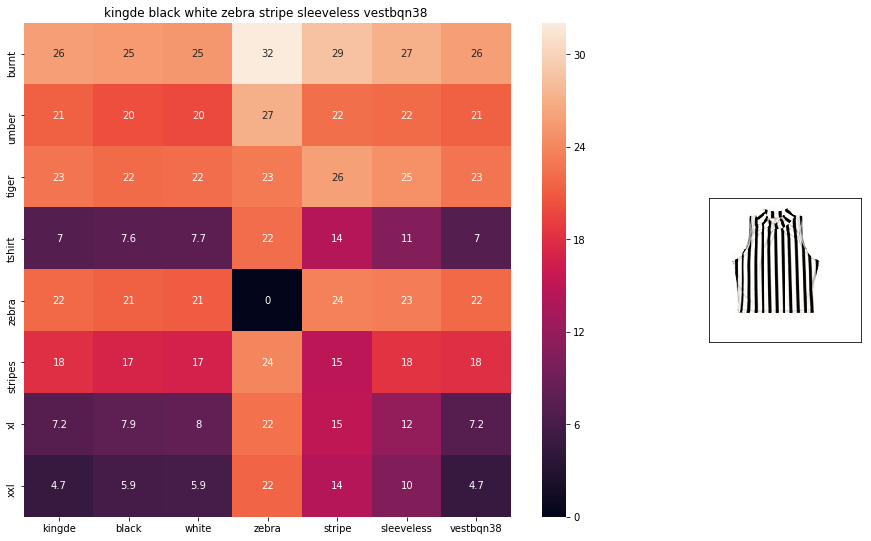

ASIN : B015H41F6G
Brand : KINGDE
euclidean distance from input : 6.13299


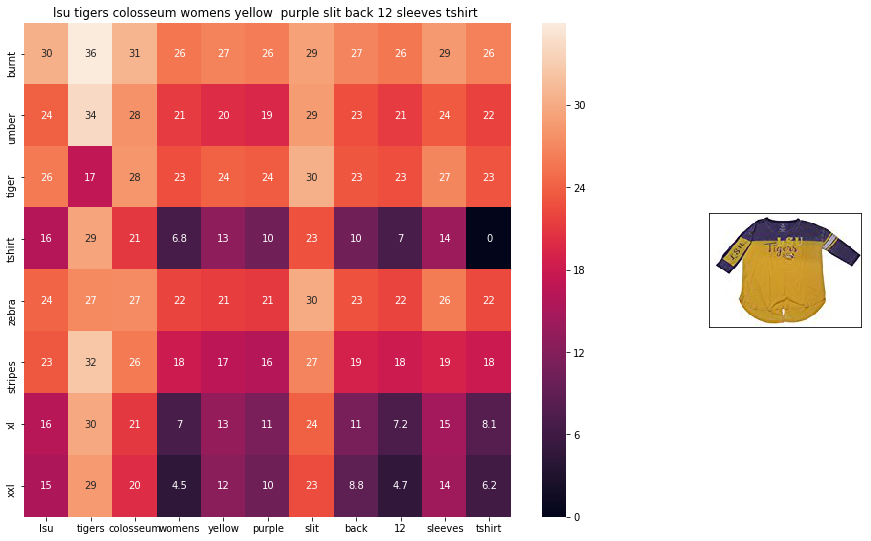

ASIN : B073R5Q8HD
Brand : Colosseum
euclidean distance from input : 6.25671


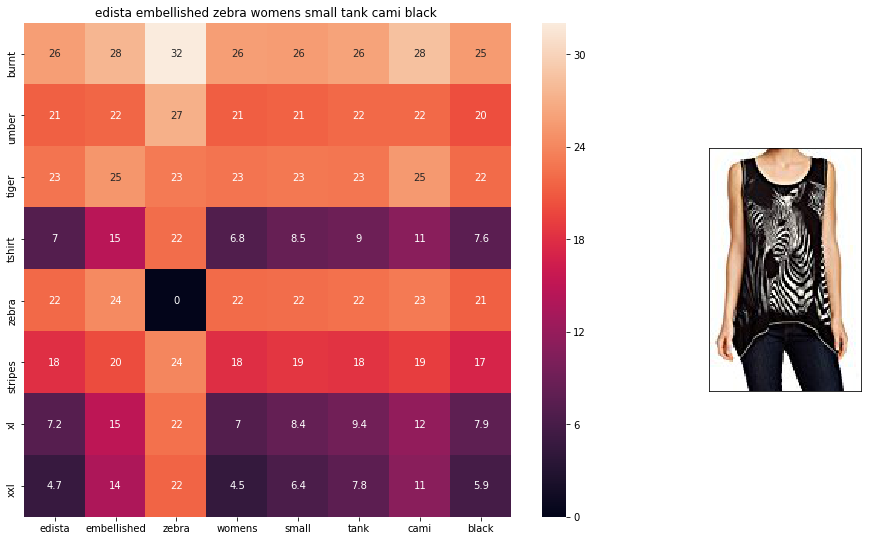

ASIN : B074P8MD22
Brand : Edista
euclidean distance from input : 6.3922


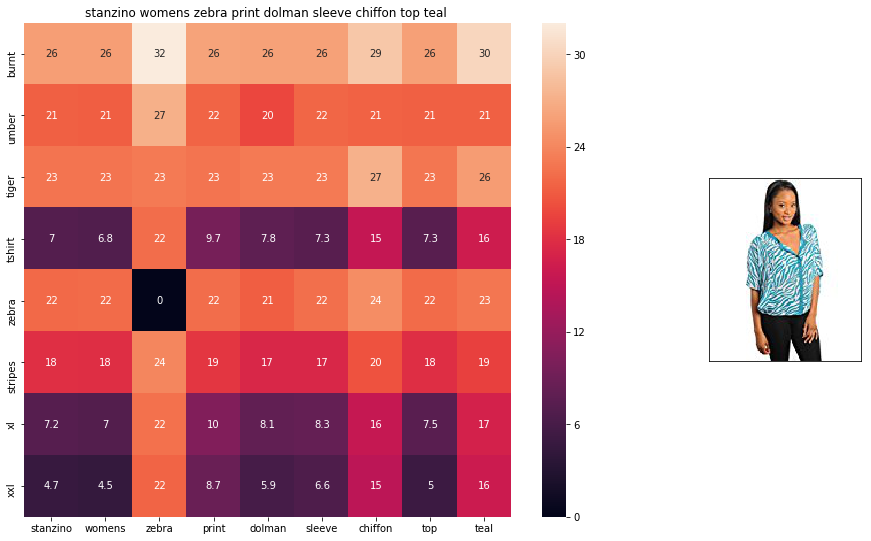

ASIN : B00C0I3U3E
Brand : Stanzino
euclidean distance from input : 6.4149


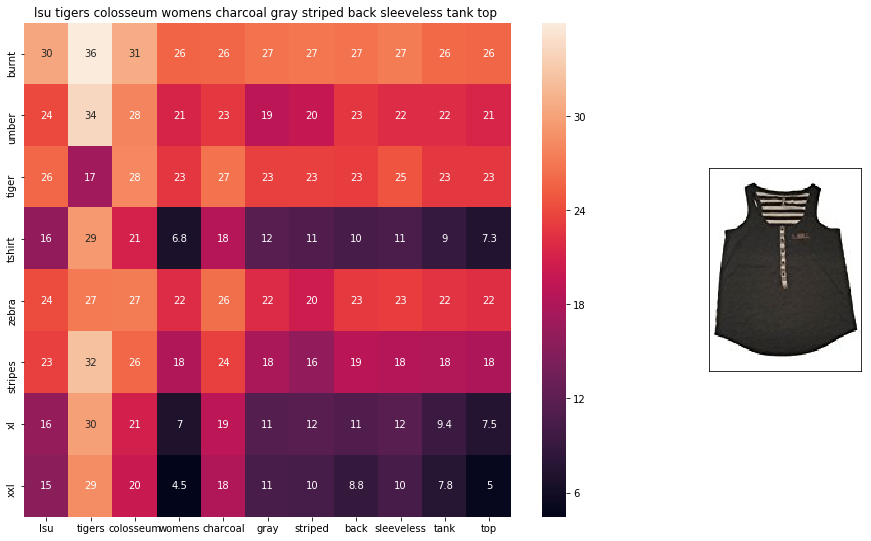

ASIN : B073R4ZM7Y
Brand : Colosseum
euclidean distance from input : 6.45096


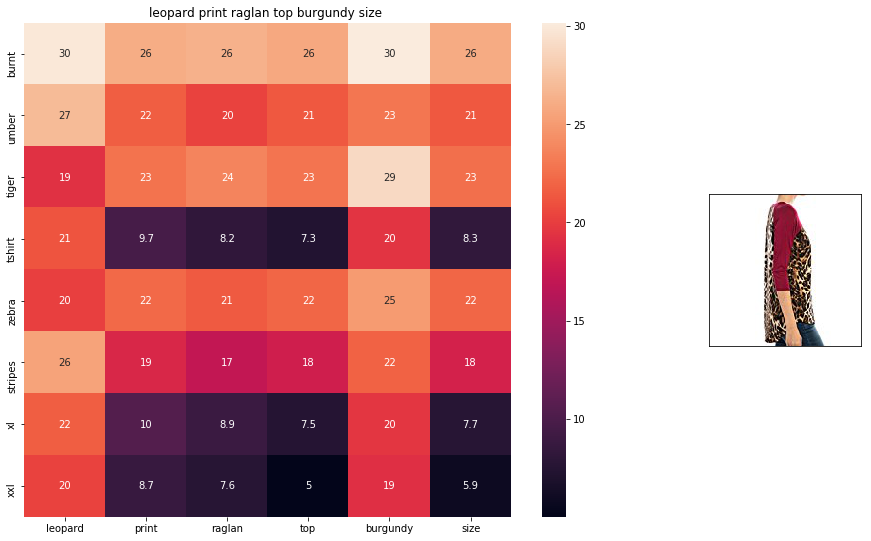

ASIN : B01C6ORLDQ
Brand : 1 Mad Fit
euclidean distance from input : 6.46341


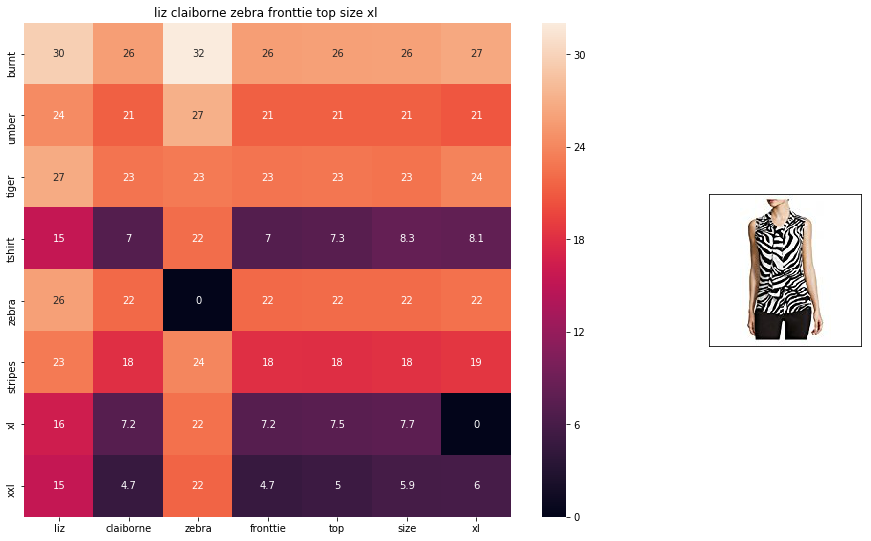

ASIN : B06XBY5QXL
Brand : Liz Claiborne
euclidean distance from input : 6.53922


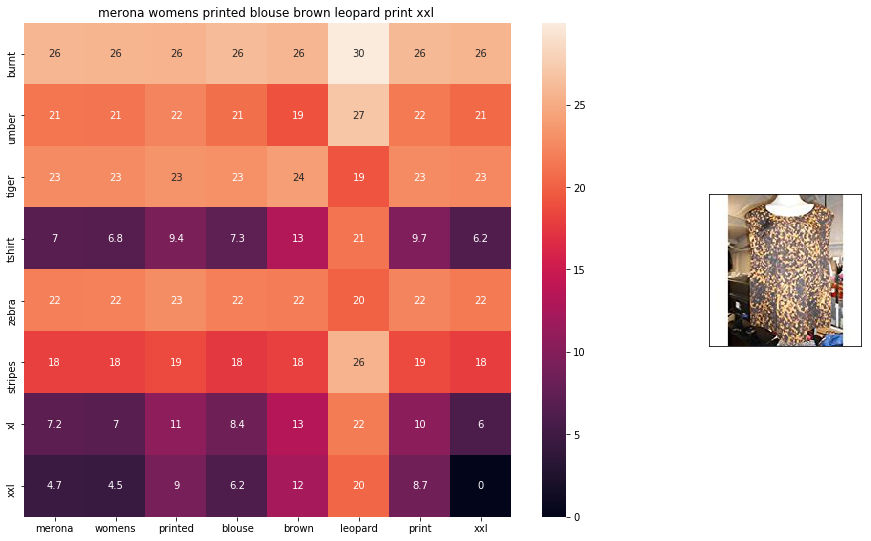

ASIN : B071YF3WDD
Brand : Merona
euclidean distance from input : 6.5755


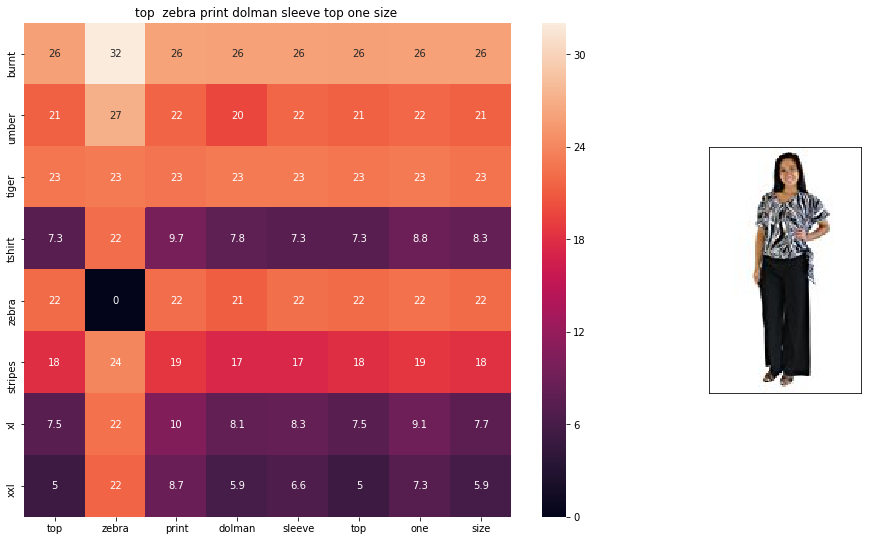

ASIN : B00H8A6ZLI
Brand : Vivian's Fashions
euclidean distance from input : 6.63821


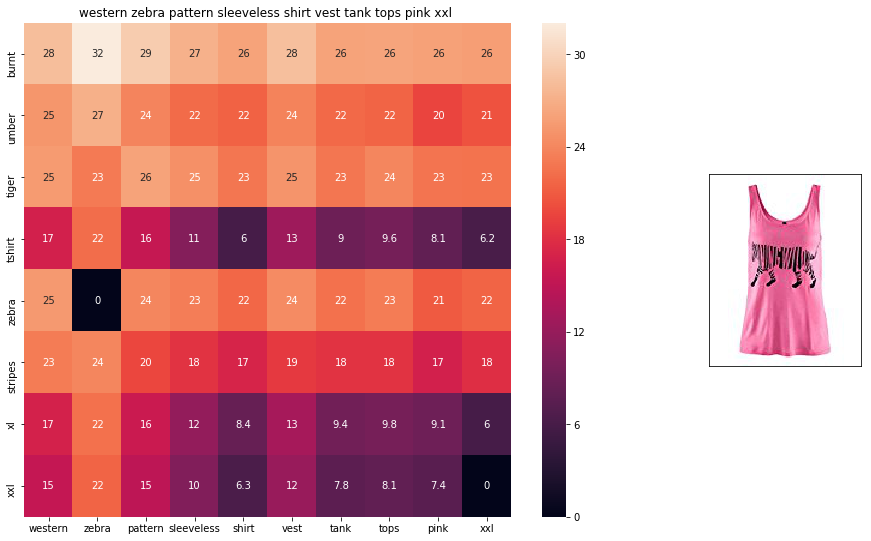

ASIN : B00Z6HEXWI
Brand : Black Temptation
euclidean distance from input : 6.66074


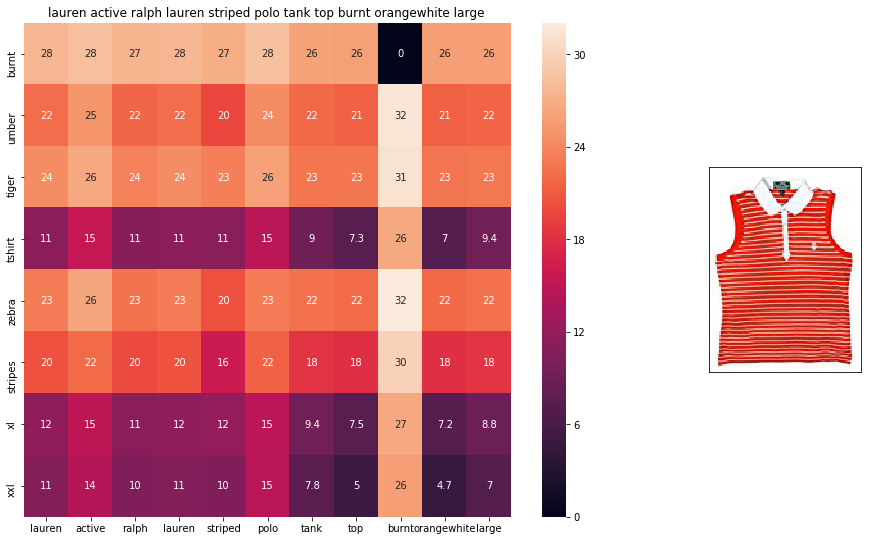

ASIN : B00ILGH5OY
Brand : Ralph Lauren Active
euclidean distance from input : 6.68391


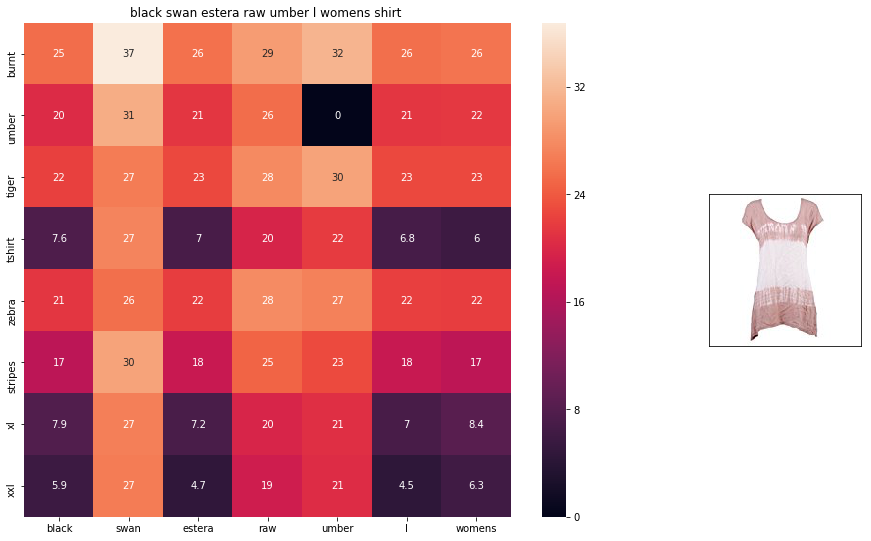

ASIN : B06Y1VN8WQ
Brand : Black Swan
euclidean distance from input : 6.70576


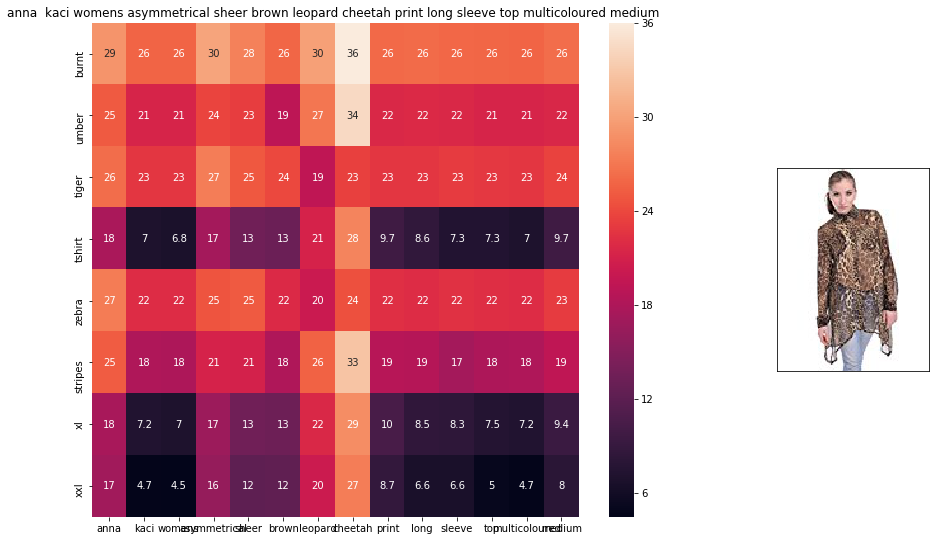

ASIN : B00KSNTY7Y
Brand : Anna-Kaci
euclidean distance from input : 6.70612


In [ ]:
def weighted_w2v_model(doc_id, num_results):
    # doc_id: apparel's id in given corpus
    
    # pairwise_dist will store the distance from given input apparel to all remaining apparels
    # the metric we used here is cosine, the coside distance is mesured as K(X, Y) = <X, Y> / (||X||*||Y||)
    # http://scikit-learn.org/stable/modules/metrics.html#cosine-similarity
    pairwise_dist = pairwise_distances(w2v_title_weight, w2v_title_weight[doc_id].reshape(1,-1))

    # np.argsort will return indices of 9 smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the 9 smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #data frame indices of the 9 smallest distace's
    df_indices = list(data.index[indices])
    
    for i in range(0, len(indices)):
        heat_map_w2v(data['title'].loc[df_indices[0]],data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], indices[0], indices[i], 'weighted')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print('Brand :',data['brand'].loc[df_indices[i]])
        print('euclidean distance from input :', pdists[i])
        print('='*125)

weighted_w2v_model(12566, 20)
#931
#12566
# in the give heat map, each cell contains the euclidean distance between words i, j

### 9.4 Similarity using brand and color

In [ ]:
data.head()

,asin,brand,color,medium_image_url,product_type_name,title,formatted_price
4,B004GSI2OS,FeatherLite,Onyx Black/ Stone,https://images-na.ssl-images-amazon.com/images...,SHIRT,featherlite ladies long sleeve stain resistant...,$26.26
6,B012YX2ZPI,HX-Kingdom Fashion T-shirts,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,womens unique 100 cotton special olympics wor...,$9.99
15,B003BSRPB0,FeatherLite,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,featherlite ladies moisture free mesh sport sh...,$20.54
27,B014ICEJ1Q,FNC7C,Purple,https://images-na.ssl-images-amazon.com/images...,SHIRT,supernatural chibis sam dean castiel neck tshi...,$7.39
46,B01NACPBG2,Fifth Degree,Black,https://images-na.ssl-images-amazon.com/images...,SHIRT,fifth degree womens gold foil graphic tees jun...,$6.95


In [ ]:
from scipy.sparse import hstack
#Replace Null values with Not given
data['brand'].fillna(value='Not given', inplace=True)

#Replace spaces with hypen
brands = [x.replace(' ', '-') for x in data['brand'].values]
types = [x.replace(' ', '-') for x in data['product_type_name'].values]
colors = [x.replace(' ', '-') for x in data['color'].values]

brand_vec = CountVectorizer()
brand_features = brand_vec.fit_transform(brands)

type_vec = CountVectorizer()
type_features = type_vec.fit_transform(types)

color_vec = CountVectorizer()
color_features = color_vec.fit_transform(colors)

extra_features = hstack((brand_features, type_features, color_features))

In [ ]:
import plotly
import plotly.figure_factory as ff
from plotly.graph_objs import Scatter, Layout

plotly.offline.init_notebook_mode(connected=True)
warnings.filterwarnings("ignore")

def heat_map_w2v_brand(sentance1, sentance2, url, doc_id1, doc_id2, df_id1, df_id2, model):
    
    # sentance1 : title1, input apparel
    # sentance2 : title2, recommended apparel
    # url: apparel image url
    # doc_id1: document id of input apparel
    # doc_id2: document id of recommended apparel
    # df_id1: index of document1 in the data frame
    # df_id2: index of document2 in the data frame
    # model: it can have two values, 1. avg 2. weighted
    
    #s1_vec = np.array(#number_of_words_title1 * 300), each row is a vector(weighted/avg) of length 300 corresponds to each word in give title
    s1_vec = get_word_vec(sentance1, doc_id1, model)
    #s2_vec = np.array(#number_of_words_title2 * 300), each row is a vector(weighted/avg) of length 300 corresponds to each word in give title
    s2_vec = get_word_vec(sentance2, doc_id2, model)
    
    # s1_s2_dist = np.array(#number of words in title1 * #number of words in title2)
    # s1_s2_dist[i,j] = euclidean distance between words i, j
    s1_s2_dist = get_distance(s1_vec, s2_vec)
   
    data_matrix = [['Asin','Brand', 'Color', 'Product type'],
               [data['asin'].loc[df_id1],brands[doc_id1], colors[doc_id1], types[doc_id1]], # input apparel's features
               [data['asin'].loc[df_id2],brands[doc_id2], colors[doc_id2], types[doc_id2]]] # recommonded apparel's features
    
    colorscale = [[0, '#1d004d'],[.5, '#f2e5ff'],[1, '#f2e5d1']] # to color the headings of each column 
    
    # we create a table with the data_matrix
    table = ff.create_table(data_matrix, index=True, colorscale=colorscale)
    # plot it with plotly
    plotly.offline.iplot(table, filename='simple_table')
    
    # devide whole figure space into 25 * 1:10 grids
    gs = gridspec.GridSpec(25, 15)
    fig = plt.figure(figsize=(25,5))
    
    # in first 25*10 grids we plot heatmap
    ax1 = plt.subplot(gs[:, :-5])
    # ploting the heap map based on the pairwise distances
    ax1 = sns.heatmap(np.round(s1_s2_dist,6), annot=True)
    # set the x axis labels as recommended apparels title
    ax1.set_xticklabels(sentance2.split())
    # set the y axis labels as input apparels title
    ax1.set_yticklabels(sentance1.split())
    # set title as recommended apparels title
    ax1.set_title(sentance2)

    # in last 25 * 10:15 grids we display image
    ax2 = plt.subplot(gs[:, 10:16])
    # we dont display grid lins and axis labels to images
    ax2.grid(False)
    ax2.set_xticks([])
    ax2.set_yticks([])
    
    # pass the url it display it
    display_img(url, ax2, fig)
    
    plt.show()

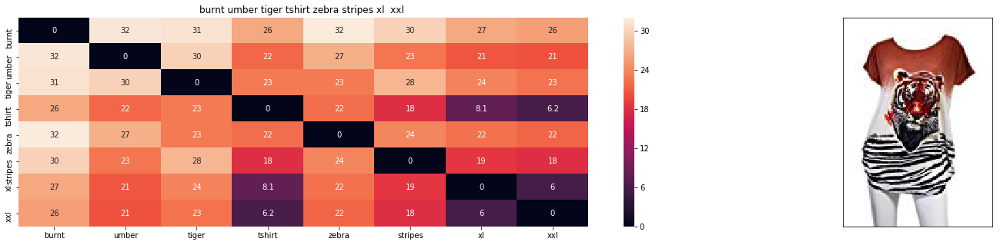

ASIN : B00JXQB5FQ
Brand : Si Row
euclidean distance from input : 0.001953125


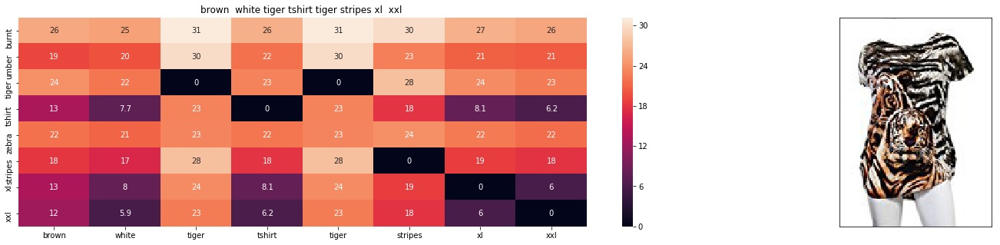

ASIN : B00JXQCWTO
Brand : Si Row
euclidean distance from input : 2.38547115326


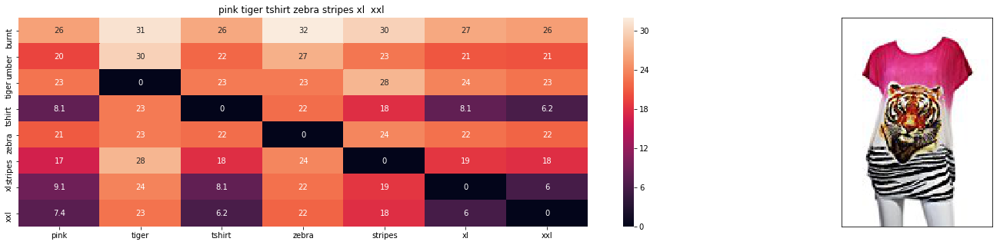

ASIN : B00JXQASS6
Brand : Si Row
euclidean distance from input : 2.73905105609


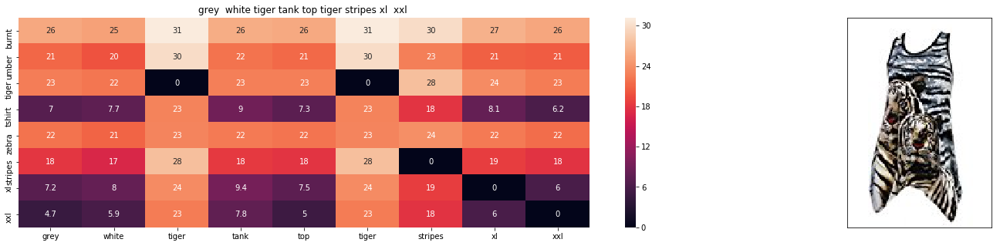

ASIN : B00JXQAFZ2
Brand : Si Row
euclidean distance from input : 3.387187195


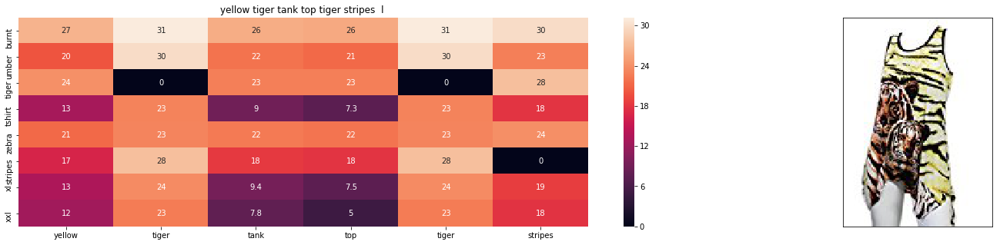

ASIN : B00JXQAUWA
Brand : Si Row
euclidean distance from input : 3.5518684389


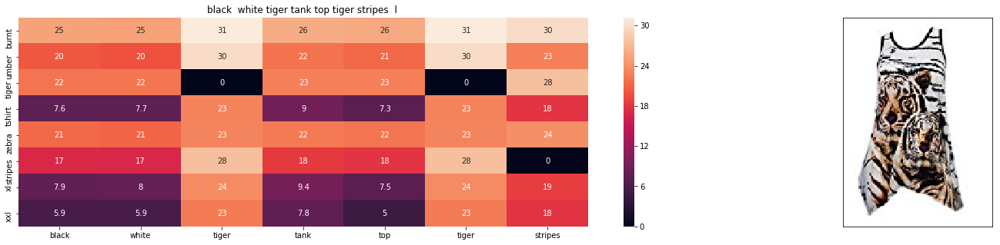

ASIN : B00JXQAO94
Brand : Si Row
euclidean distance from input : 3.5536174776


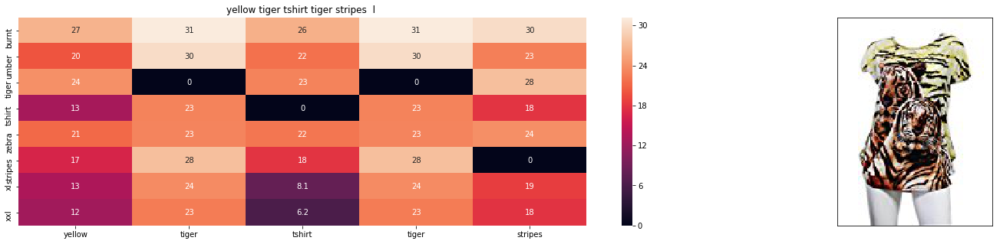

ASIN : B00JXQCUIC
Brand : Si Row
euclidean distance from input : 3.65382804889


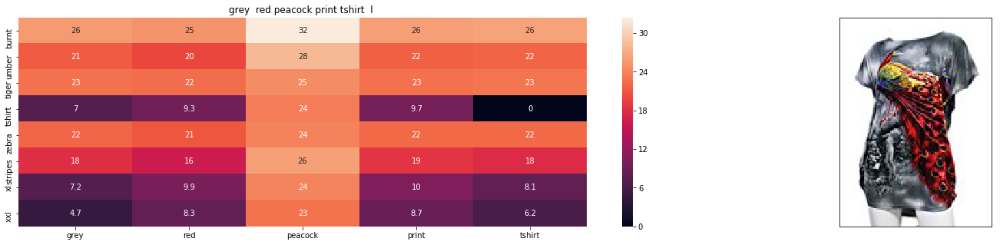

ASIN : B00JXQCFRS
Brand : Si Row
euclidean distance from input : 4.12881164569


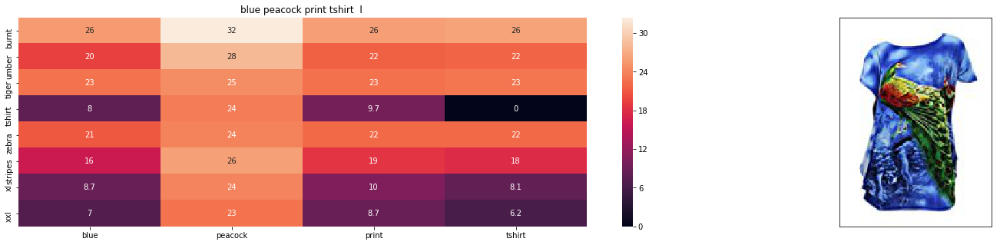

ASIN : B00JXQC8L6
Brand : Si Row
euclidean distance from input : 4.20390052813


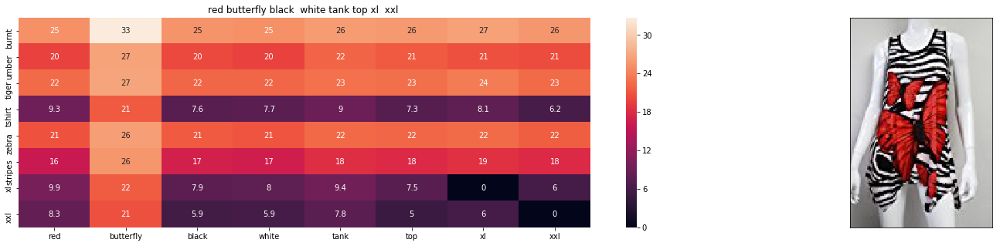

ASIN : B00JV63CW2
Brand : Si Row
euclidean distance from input : 4.28658676166


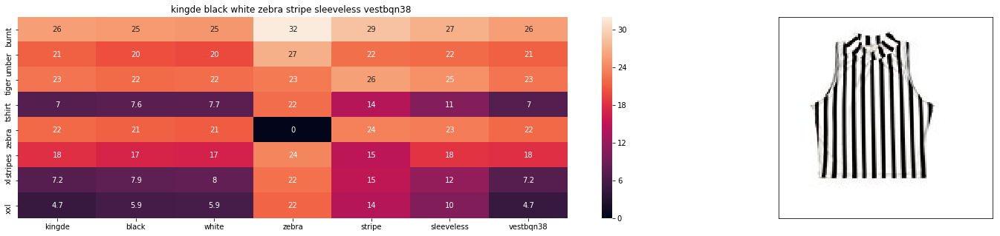

ASIN : B015H41F6G
Brand : KINGDE
euclidean distance from input : 4.38937078798


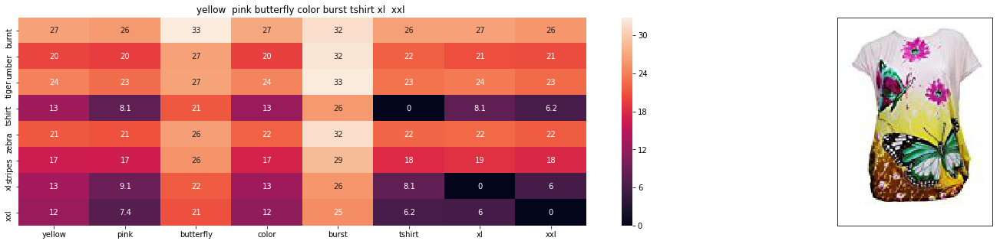

ASIN : B00JXQBBMI
Brand : Si Row
euclidean distance from input : 4.39790992755


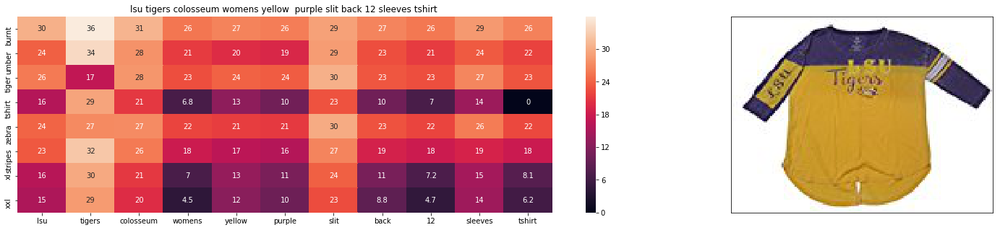

ASIN : B073R5Q8HD
Brand : Colosseum
euclidean distance from input : 4.45122858369


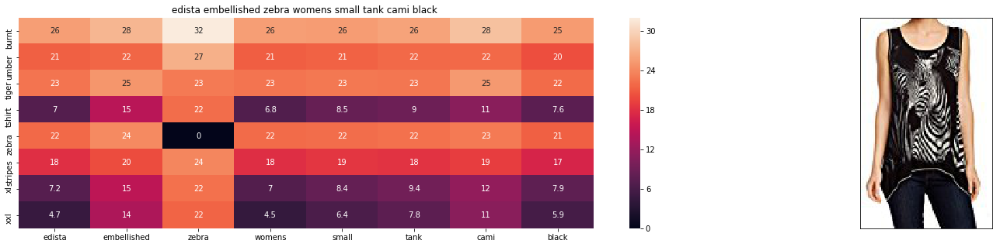

ASIN : B074P8MD22
Brand : Edista
euclidean distance from input : 4.51897779787


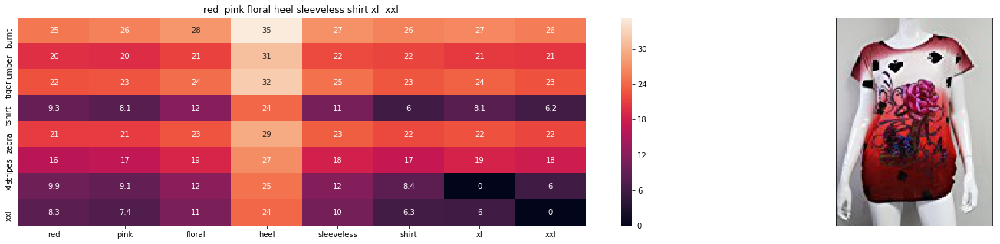

ASIN : B00JV63QQE
Brand : Si Row
euclidean distance from input : 4.52937545794


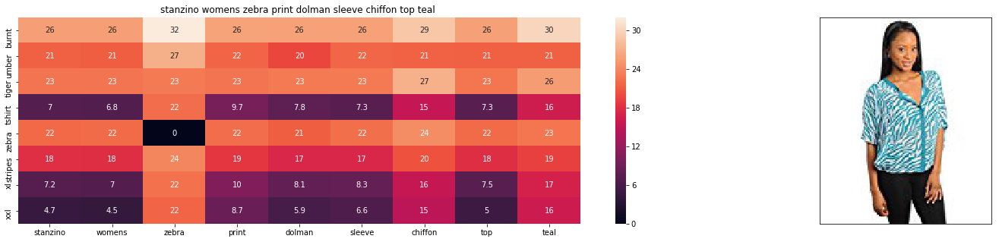

ASIN : B00C0I3U3E
Brand : Stanzino
euclidean distance from input : 4.53032614076


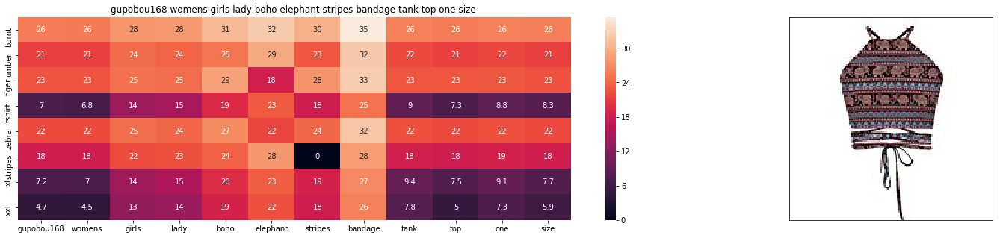

ASIN : B01ER184O6
Brand : GuPoBoU168
euclidean distance from input : 4.54681702403


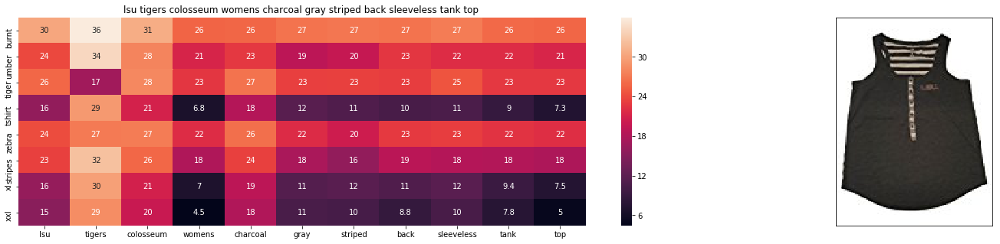

ASIN : B073R4ZM7Y
Brand : Colosseum
euclidean distance from input : 4.54835554445


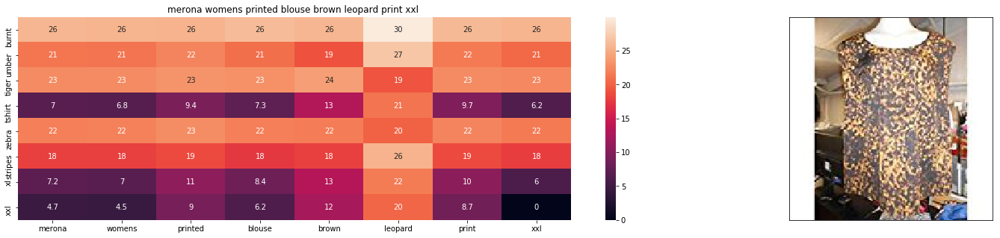

ASIN : B071YF3WDD
Brand : Merona
euclidean distance from input : 4.61062742555


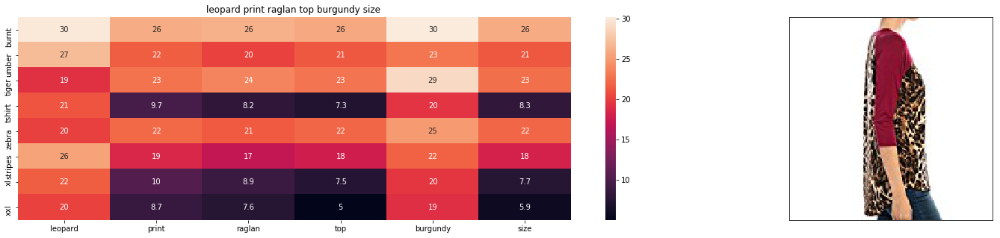

ASIN : B01C6ORLDQ
Brand : 1 Mad Fit
euclidean distance from input : 4.64591789282


In [ ]:
def idf_w2v_brand(doc_id, w1, w2, num_results):
    # doc_id: apparel's id in given corpus
    # w1: weight for  w2v features
    # w2: weight for brand and color features

    # pairwise_dist will store the distance from given input apparel to all remaining apparels
    # the metric we used here is cosine, the coside distance is mesured as K(X, Y) = <X, Y> / (||X||*||Y||)
    # http://scikit-learn.org/stable/modules/metrics.html#cosine-similarity
    idf_w2v_dist  = pairwise_distances(w2v_title_weight, w2v_title_weight[doc_id].reshape(1,-1))
    ex_feat_dist = pairwise_distances(extra_features, extra_features[doc_id])
    pairwise_dist   = (w1 * idf_w2v_dist +  w2 * ex_feat_dist)/float(w1 + w2)

    # np.argsort will return indices of 9 smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the 9 smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #data frame indices of the 9 smallest distace's
    df_indices = list(data.index[indices])
    

    for i in range(0, len(indices)):
        heat_map_w2v_brand(data['title'].loc[df_indices[0]],data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], indices[0], indices[i],df_indices[0], df_indices[i], 'weighted')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print('Brand :',data['brand'].loc[df_indices[i]])
        print('euclidean distance from input :', pdists[i])
        print('='*125)

idf_w2v_brand(12566, 5, 5, 20)
# in the give heat map, each cell contains the euclidean distance between words i, j

### 10. Extract image features using VGG_16

In [ ]:
from IPython.display import Image

cnn_image_features = np.load('/content/drive/My Drive/*Assign 26 - Apparel Recommendation/Copy of 16k_data_cnn_features.npy')
asins = np.load('/content/drive/My Drive/*Assign 26 - Apparel Recommendation/Copy of 16k_data_cnn_feature_asins.npy')
asins = list(asins)

#load the dataset
data = pd.read_pickle('/content/drive/My Drive/*Assign 26 - Apparel Recommendation/Copy of 16k_apperal_data_preprocessed')
df_asins = list(data['asin'])

#get similar products using CNN features (VGG-16)
def get_similar_products_cnn(doc_id, num_results):
    doc_id = asins.index(df_asins[doc_id])
    pairwise_dist = pairwise_distances(cnn_image_features, cnn_image_features[doc_id].reshape(1,-1))

    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    for i in range(len(indices)):
        rows = data[['medium_image_url','title']].loc[data['asin']==asins[indices[i]]]
        for indx, row in rows.iterrows():
            display(Image(url=row['medium_image_url'], embed=True))
            print('Product Title: ', row['title'])
            print('Euclidean Distance from input image:', pdists[i])
            print('Amazon Url: www.amzon.com/dp/'+ asins[indices[i]])

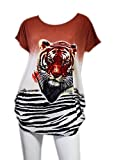

Product Title:  burnt umber tiger tshirt zebra stripes xl  xxl 
Euclidean Distance from input image: 6.32596e-06
Amazon Url: www.amzon.com/dp/B00JXQB5FQ


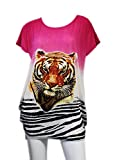

Product Title:  pink tiger tshirt zebra stripes xl  xxl 
Euclidean Distance from input image: 30.05017
Amazon Url: www.amzon.com/dp/B00JXQASS6


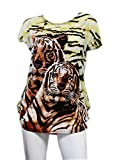

Product Title:  yellow tiger tshirt tiger stripes  l 
Euclidean Distance from input image: 41.261116
Amazon Url: www.amzon.com/dp/B00JXQCUIC


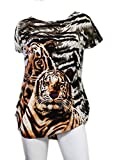

Product Title:  brown  white tiger tshirt tiger stripes xl  xxl 
Euclidean Distance from input image: 44.000156
Amazon Url: www.amzon.com/dp/B00JXQCWTO


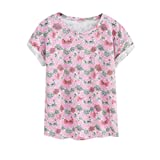

Product Title:  kawaii pastel tops tees pink flower design 
Euclidean Distance from input image: 47.38248
Amazon Url: www.amzon.com/dp/B071FCWD97


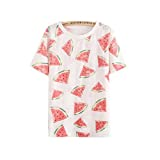

Product Title:  womens thin style tops tees pastel watermelon print 
Euclidean Distance from input image: 47.71842
Amazon Url: www.amzon.com/dp/B01JUNHBRM


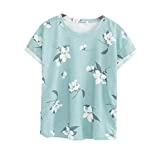

Product Title:  kawaii pastel tops tees baby blue flower design 
Euclidean Distance from input image: 47.90206
Amazon Url: www.amzon.com/dp/B071SBCY9W


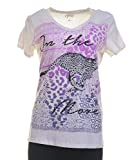

Product Title:  edv cheetah run purple multi xl 
Euclidean Distance from input image: 48.046482
Amazon Url: www.amzon.com/dp/B01CUPYBM0


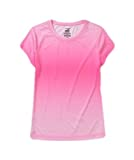

Product Title:  danskin womens vneck loose performance tee xsmall pink ombre 
Euclidean Distance from input image: 48.101837
Amazon Url: www.amzon.com/dp/B01F7PHXY8


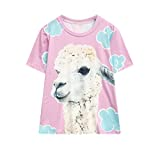

Product Title:  summer alpaca 3d pastel casual loose tops tee design 
Euclidean Distance from input image: 48.118866
Amazon Url: www.amzon.com/dp/B01I80A93G


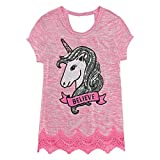

Product Title:  miss chievous juniors striped peplum tank top medium shadowpeach 
Euclidean Distance from input image: 48.13122
Amazon Url: www.amzon.com/dp/B0177DM70S


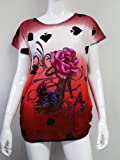

Product Title:  red  pink floral heel sleeveless shirt xl  xxl 
Euclidean Distance from input image: 48.16945
Amazon Url: www.amzon.com/dp/B00JV63QQE


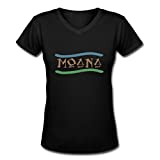

Product Title:  moana logo adults hot v neck shirt black xxl 
Euclidean Distance from input image: 48.256786
Amazon Url: www.amzon.com/dp/B01LX6H43D


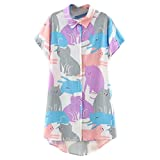

Product Title:  abaday multicolor cartoon cat print short sleeve longline shirt large 
Euclidean Distance from input image: 48.265686
Amazon Url: www.amzon.com/dp/B01CR57YY0


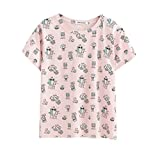

Product Title:  kawaii cotton pastel tops tees peach pink cactus design 
Euclidean Distance from input image: 48.362602
Amazon Url: www.amzon.com/dp/B071WYLBZS


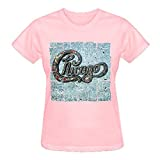

Product Title:  chicago chicago 18 shirt women pink 
Euclidean Distance from input image: 48.383606
Amazon Url: www.amzon.com/dp/B01GXAZTRY


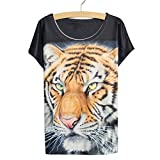

Product Title:  yichun womens tiger printed summer tshirts tops 
Euclidean Distance from input image: 48.449356
Amazon Url: www.amzon.com/dp/B010NN9RXO


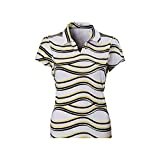

Product Title:  nancy lopez whimsy short sleeve  whiteblacklemon drop  xs 
Euclidean Distance from input image: 48.47889
Amazon Url: www.amzon.com/dp/B01MPX6IDX


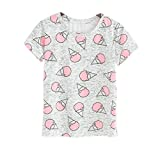

Product Title:  womens tops tees pastel peach ice cream cone print 
Euclidean Distance from input image: 48.557957
Amazon Url: www.amzon.com/dp/B0734GRKZL


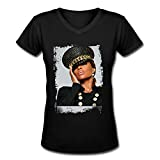

Product Title:  uswomens mary j blige without tshirts shirt 
Euclidean Distance from input image: 48.614372
Amazon Url: www.amzon.com/dp/B01M0XXFKK


In [ ]:
get_similar_products_cnn(12566, 20)

# 11. Assignment:
- IDF_W2V
- Brand
- Color
- Cnn_features

### 11.1 IDF_W2V

In [4]:
data = pd.read_pickle('/content/drive/My Drive/*Assign 26 - Apparel Recommendation/Copy of 16k_apperal_data_preprocessed')
data.head()

,asin,brand,color,medium_image_url,product_type_name,title,formatted_price
4,B004GSI2OS,FeatherLite,Onyx Black/ Stone,https://images-na.ssl-images-amazon.com/images...,SHIRT,featherlite ladies long sleeve stain resistant...,$26.26
6,B012YX2ZPI,HX-Kingdom Fashion T-shirts,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,womens unique 100 cotton special olympics wor...,$9.99
15,B003BSRPB0,FeatherLite,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,featherlite ladies moisture free mesh sport sh...,$20.54
27,B014ICEJ1Q,FNC7C,Purple,https://images-na.ssl-images-amazon.com/images...,SHIRT,supernatural chibis sam dean castiel neck tshi...,$7.39
46,B01NACPBG2,Fifth Degree,Black,https://images-na.ssl-images-amazon.com/images...,SHIRT,fifth degree womens gold foil graphic tees jun...,$6.95


In [5]:
from sklearn.feature_extraction.text import CountVectorizer
idf_title_vectorizer = CountVectorizer()
idf_title_features = idf_title_vectorizer.fit_transform(data['title'])


#finding whether title has given word and if it has count it
def n_containing(word):
    count = 0
    for title in data['title'].values:
        title_split = title.split()
        if word in title_split:
            count += 1

    return count

#idf = log(#number of docs / #number of docs which had the given word)
def idf(word):
    return math.log(data.shape[0]/n_containing(word))

#now replace the idf_title_feautes(BOW features) into a idf encoded featues
idf_title_features = idf_title_features.astype(np.float)

#for word in title 
for i in idf_title_vectorizer.vocabulary_.keys():
    idf_val = idf(i)

    # to calculate idf_title_features we need to replace the count values with the idf values of the word
    # idf_title_features[:, idf_title_vectorizer.vocabulary_[i]].nonzero()[0] will return all documents in which the word i present
    for j in idf_title_features[:, idf_title_vectorizer.vocabulary_[i]].nonzero()[0]:
        idf_title_features[j, idf_title_vectorizer.vocabulary_[i]] = idf_val

In [ ]:
pd.DataFrame.sparse.from_spmatrix(idf_title_features).head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,12569,12570,12571,12572,12573,12574,12575,12576,12577,12578,12579,12580,12581,12582,12583,12584,12585,12586,12587,12588,12589,12590,12591,12592,12593,12594,12595,12596,12597,12598,12599,12600,12601,12602,12603,12604,12605,12606,12607,12608
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [6]:
with open('/content/drive/My Drive/*Assign 26 - Apparel Recommendation/Copy of word2vec_model', 'rb') as handle:
    model = pickle.load(handle)
    vocab = model.keys()


def get_idf_weighted_w2v(sentence, num_features, doc_id):
    vec = np.zeros((num_features,), dtype='float32')
    nwords = 0
    for i in sentence.split():
        try:
            if i in vocab:
                nwords += 1
                vec = np.add(vec, idf_title_features[doc_id, idf_title_vectorizer.vocabulary_[i]]*model[i]) #idf_val*model_w2v of the particular word
        except:
            continue

    if nwords>0:
        vec = np.divide(vec, nwords)
    return vec


In [7]:
doc_id = 0
idf_weighted_w2v_title = []
# for every title we build a weighted vector representation
for i in data['title']:
    idf_weighted_w2v_title.append(get_idf_weighted_w2v(i, 300, doc_id))
    doc_id += 1
# w2v_title = np.array(# number of doc in courpus * 300), each row corresponds to a doc 
idf_weighted_w2v_title = np.array(idf_weighted_w2v_title)

In [8]:
idf_weighted_w2v_title.shape

(16042, 300)

### 11.2 Brand and color features

In [9]:
from scipy.sparse import hstack
# some of the brand values are empty. 
# Need to replace Null with string "NULL"
data['brand'].fillna(value="Not given", inplace=True )

# replace spaces with hypen
brands = [x.replace(" ", "-") for x in data['brand'].values]
colors = [x.replace(" ", "-") for x in data['color'].values]

brand_vectorizer = CountVectorizer()
brand_features = brand_vectorizer.fit_transform(brands)

color_vectorizer = CountVectorizer()
color_features = color_vectorizer.fit_transform(colors)

#needed to plot plotly heatmap
types = [x.replace(" ", "-") for x in data['product_type_name'].values]
type_vectorizer = CountVectorizer()
type_features = type_vectorizer.fit_transform(types)

In [10]:
print(brand_features.shape)
print(color_features.shape)
print(type_features.shape)

(16042, 3835)
(16042, 1845)
(16042, 55)


### 11.3 CNN based features

In [11]:
cnn_image_features = np.load('/content/drive/My Drive/*Assign 26 - Apparel Recommendation/Copy of 16k_data_cnn_features.npy')
asins = np.load('/content/drive/My Drive/*Assign 26 - Apparel Recommendation/Copy of 16k_data_cnn_feature_asins.npy')
asins = list(asins)

In [12]:
print(cnn_image_features.shape)

(16042, 25088)


### Note:
- The features we have: idf_weighted_w2v_title, color, brand, types, cnn_features


### 11.4 Displaying results

In [13]:
# Utility functions
#from IPython.display import display, Image
from PIL import Image

#Display an image
def display_img(url,ax,fig):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))
    plt.imshow(img)

    
#get the word_vec using the model from pickle
def get_word_vec(sentence, doc_id):# if the word in our courpus is not there in the google word2vec corpus, we are just ignoring it_id, m_name):
    # sentence : title of the apparel
    # doc_id: document id in our corpus
    
    vec = []
    for i in sentence.split():
        if i in vocab:
            if i in idf_title_vectorizer.vocabulary_:
                vec.append(idf_title_features[doc_id, idf_title_vectorizer.vocabulary_[i]]*model[i])

        else:
            vec.append(zp.zeros(shape=(300,)))

    # we will return a numpy array of shape (#number of words in title * 300 ) 300 = len(w2v_model[word])
    # each row represents the word2vec representation of each word (weighted/avg) in given sentance 
    return np.array(vec)    
    

def get_distance(vec1, vec2):
    # vec1 = np.array(#number_of_words_title1 * 300), each row is a vector of length 300 corresponds to each word in give title
    # vec2 = np.array(#number_of_words_title2 * 300), each row is a vector of length 300 corresponds to each word in give title
    
    final_dist = []
    # for each vector in vec1 we caluclate the distance(euclidean) to all vectors in vec2
    for i in vec1:
        dist = []
        for j in vec2:
            # np.linalg.norm(i-j) will result the euclidean distance between vectors i, j
            dist.append(np.linalg.norm(i-j))
        final_dist.append(np.array(dist))
    # final_dist = np.array(#number of words in title1 * #number of words in title2)
    # final_dist[i,j] = euclidean distance between vectors i, j
    return np.array(final_dist)



def heat_map_final(sentance1, sentance2, url, doc_id1, doc_id2, df_id1, df_id2):
    
    # sentance1 : title1, input apparel
    # sentance2 : title2, recommended apparel
    # url: apparel image url
    # doc_id1: document id of input apparel
    # doc_id2: document id of recommended apparel
    # df_id1: index of document1 in the data frame
    # df_id2: index of document2 in the data frame
    # model: it can have two values, 1. avg 2. weighted
    
    #s1_vec = np.array(#number_of_words_title1 * 300), each row is a vector(weighted/avg) of length 300 corresponds to each word in give title
    s1_vec = get_word_vec(sentance1, doc_id1)
    #s2_vec = np.array(#number_of_words_title2 * 300), each row is a vector(weighted/avg) of length 300 corresponds to each word in give title
    s2_vec = get_word_vec(sentance2, doc_id2)
    
    # s1_s2_dist = np.array(#number of words in title1 * #number of words in title2)
    # s1_s2_dist[i,j] = euclidean distance between words i, j
    s1_s2_dist = get_distance(s1_vec, s2_vec)
   
    data_matrix = [['Asin','Brand', 'Color', 'Product type'],
               [data['asin'].loc[df_id1],brands[doc_id1], colors[doc_id1], types[doc_id1]], # input apparel's features
               [data['asin'].loc[df_id2],brands[doc_id2], colors[doc_id2], types[doc_id2]]] # recommonded apparel's features
    
    colorscale = [[0, '#1d004d'],[.5, '#f2e5ff'],[1, '#f2e5d1']] # to color the headings of each column 
    
    # we create a table with the data_matrix
    table = ff.create_table(data_matrix, index=True, colorscale=colorscale)
    # plot it with plotly
    plotly.offline.iplot(table, filename='simple_table')
    
    # devide whole figure space into 25 * 1:10 grids
    gs = gridspec.GridSpec(25, 15)
    fig = plt.figure(figsize=(25,5))
    
    # in first 25*10 grids we plot heatmap
    ax1 = plt.subplot(gs[:, :-5])
    # ploting the heap map based on the pairwise distances
    ax1 = sns.heatmap(np.round(s1_s2_dist,6), annot=True)
    # set the x axis labels as recommended apparels title
    ax1.set_xticklabels(sentance2.split())
    # set the y axis labels as input apparels title
    ax1.set_yticklabels(sentance1.split())
    # set title as recommended apparels title
    ax1.set_title(sentance2)

    # in last 25 * 10:15 grids we display image
    ax2 = plt.subplot(gs[:, 10:16])
    # we dont display grid lins and axis labels to images
    ax2.grid(False)
    ax2.set_xticks([])
    ax2.set_yticks([])
    
    # pass the url it display it
    display_img(url, ax2, fig)
    
    plt.show()

In [14]:
print(idf_weighted_w2v_title.shape)
print(color_features.shape)
print(brand_features.shape)
print(type_features.shape)
print(cnn_image_features.shape)

(16042, 300)
(16042, 1845)
(16042, 3835)
(16042, 55)
(16042, 25088)


In [15]:
def final_model(doc_id, num_results, w1, w2, w3, w4, w5):

    #pairwise dist of idf_weighted_w2v
    idf_weighted_w2v_dist = pairwise_distances(idf_weighted_w2v_title, idf_weighted_w2v_title[doc_id].reshape(1,-1))  #maintaining the (1,all.shape[1]) shape
    #pairwise_dist of color features
    color_dist = pairwise_distances(color_features, color_features[doc_id])
    #pairwise dist of brand features
    brand_dist = pairwise_distances(brand_features, brand_features[doc_id])
    #pairwise_dist of type features
    type_dist = pairwise_distances(type_features, type_features[doc_id])
    #pairwise dist of cnn features
    cnn_dist = pairwise_distances(cnn_image_features, cnn_image_features[doc_id].reshape(1,-1))

    #weighted pairwise distance with different weights
    pairwise_dist = ((w1*idf_weighted_w2v_dist)+(w2*color_dist)+(w3*brand_dist)+(w4*type_dist)+(w5*cnn_dist))/(float(w1+w2+w3+w4+w5))

    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    pdists = np.sort(pairwise_dist.flatten())[0:num_results]
    df_indices = list(data.index[indices])

    for i in range(0, len(indices)):
        heat_map_final(data['title'].loc[df_indices[0]],data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], indices[0], indices[i],df_indices[0], df_indices[i])
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print('BRAND :',data['brand'].loc[df_indices[i]])
        print ('euclidean distance from given input image :', pdists[i])
        print('='*125)

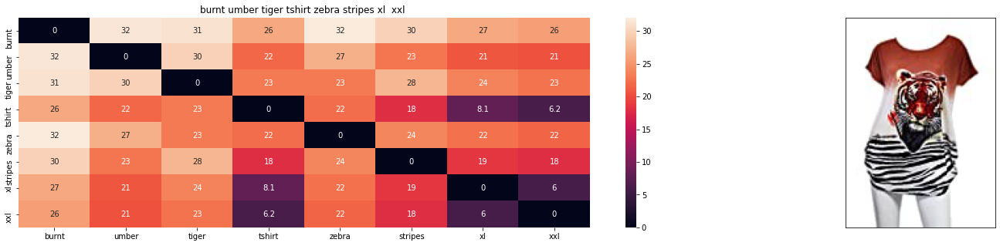

ASIN : B00JXQB5FQ
BRAND : Si Row
euclidean distance from given input image : 2.002463709989873e-06


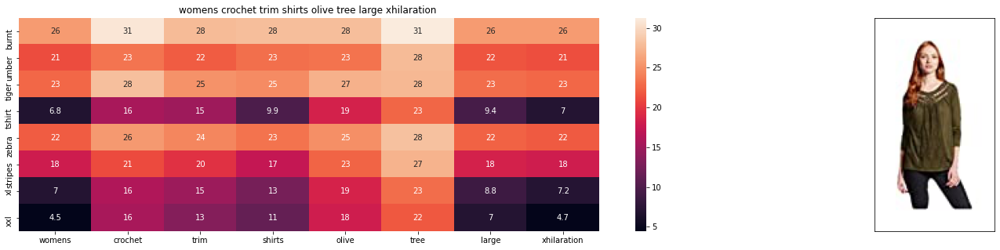

ASIN : B06XBHNM7J
BRAND : Xhilaration
euclidean distance from given input image : 13.221623400672687


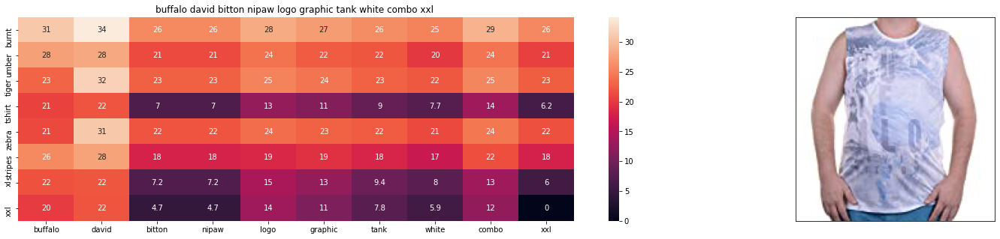

ASIN : B018H5AZXQ
BRAND : Buffalo
euclidean distance from given input image : 13.684658475542479


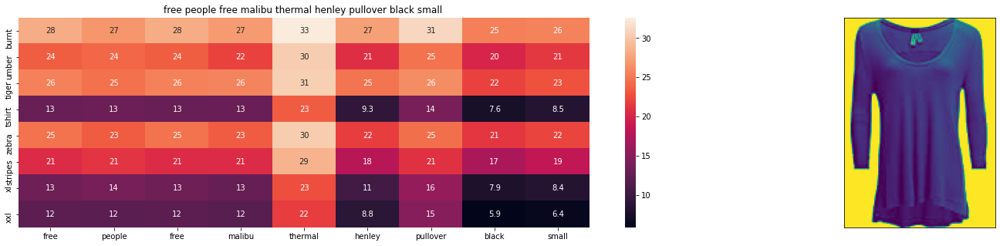

ASIN : B074MXY984
BRAND : We The Free
euclidean distance from given input image : 13.982569378704413


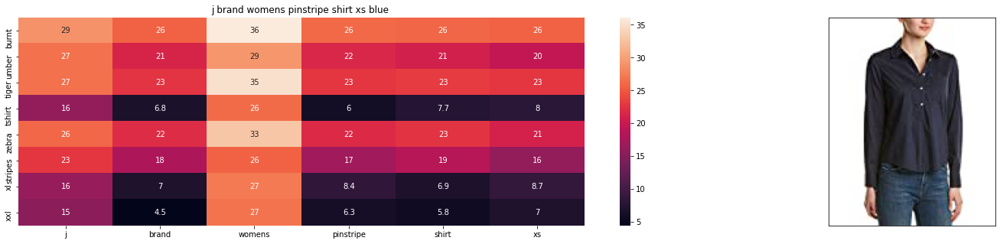

ASIN : B06XYP1X1F
BRAND : J Brand Jeans
euclidean distance from given input image : 14.00347681684929


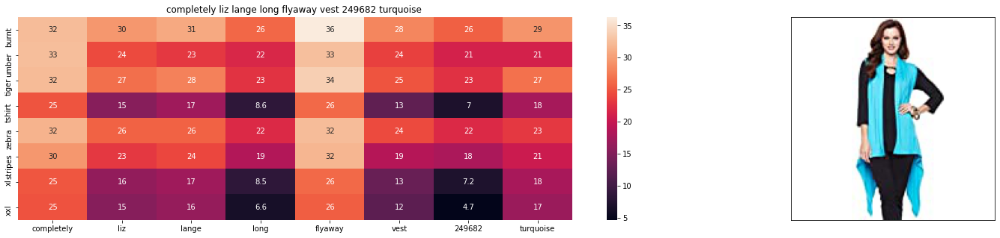

ASIN : B074LTBWSW
BRAND : Liz Lange
euclidean distance from given input image : 14.03373652149936


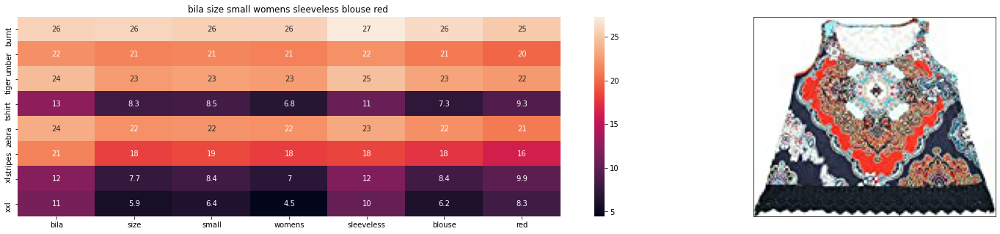

ASIN : B01L7ROZNC
BRAND : Bila
euclidean distance from given input image : 14.08517147170451


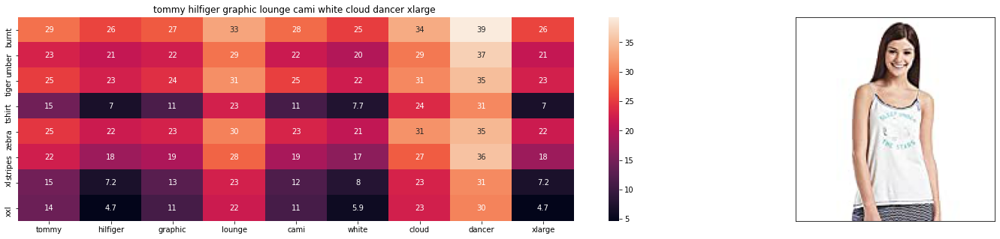

ASIN : B01BMSFYW2
BRAND : igertommy hilf
euclidean distance from given input image : 14.319557291702806


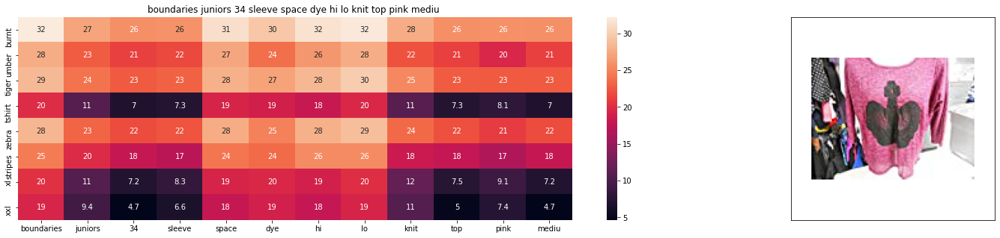

ASIN : B01EXXFS4M
BRAND : No Boundaries
euclidean distance from given input image : 14.48619242359897


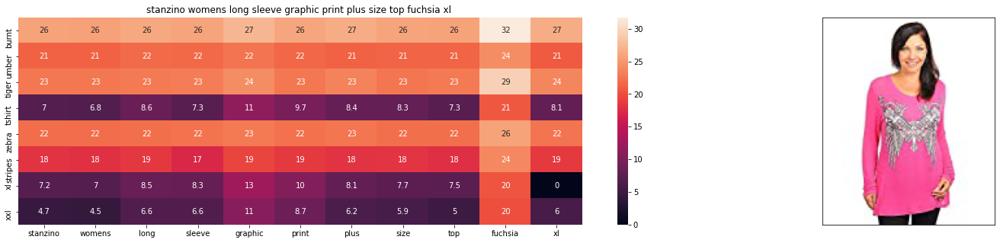

ASIN : B00DP4VHWI
BRAND : Stanzino
euclidean distance from given input image : 14.486550611922608


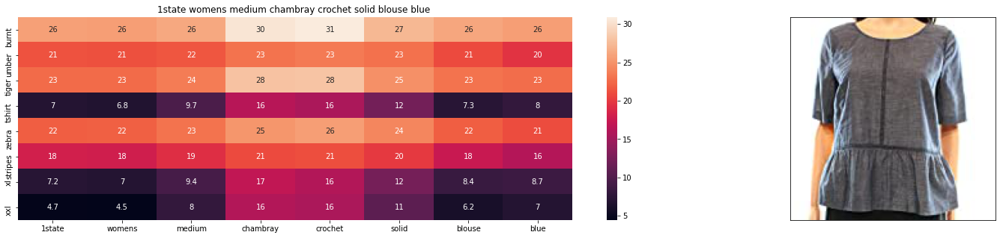

ASIN : B074MK6LV2
BRAND : 1.State
euclidean distance from given input image : 14.518920861352946


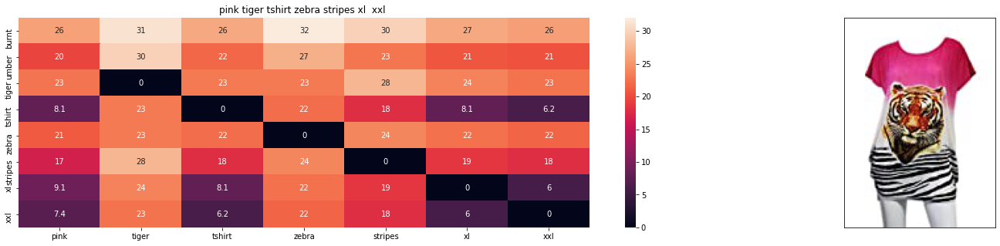

ASIN : B00JXQASS6
BRAND : Si Row
euclidean distance from given input image : 14.52628084824545


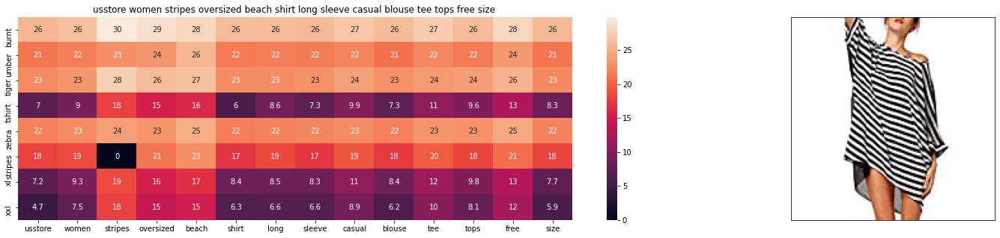

ASIN : B01DNNI1RO
BRAND : Usstore
euclidean distance from given input image : 14.534637367550943


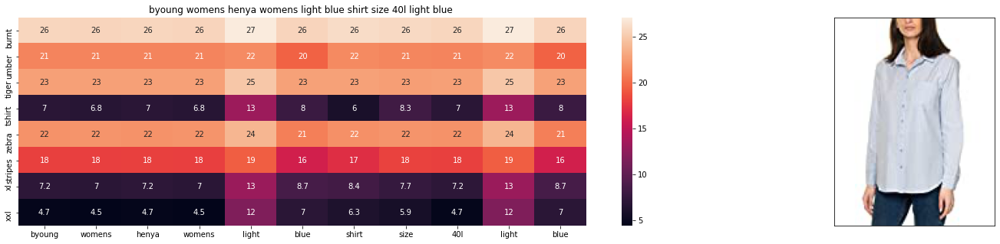

ASIN : B06Y41MRCH
BRAND : Byoung
euclidean distance from given input image : 14.54652854186735


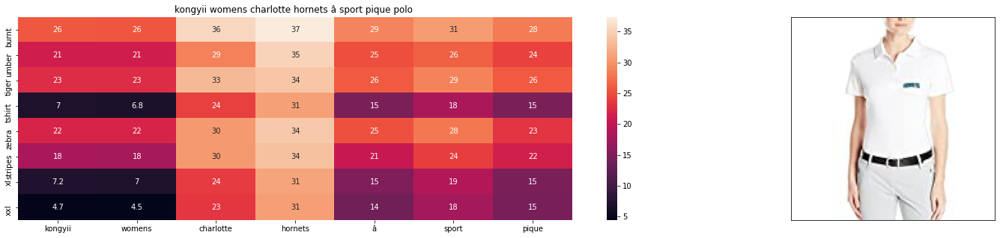

ASIN : B01FJVZST2
BRAND : KONGYII
euclidean distance from given input image : 14.562663486271566


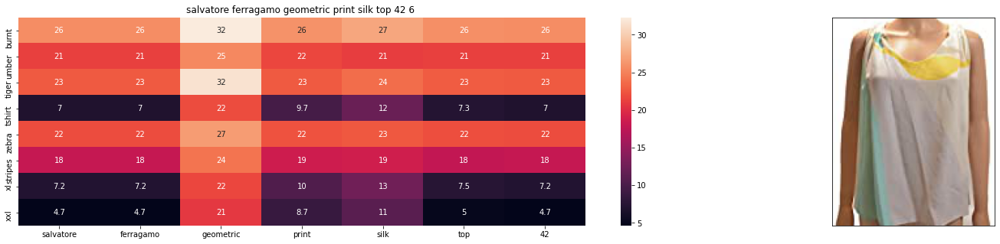

ASIN : B0756JTS1F
BRAND : Salvatore Ferragamo
euclidean distance from given input image : 14.586886906278087


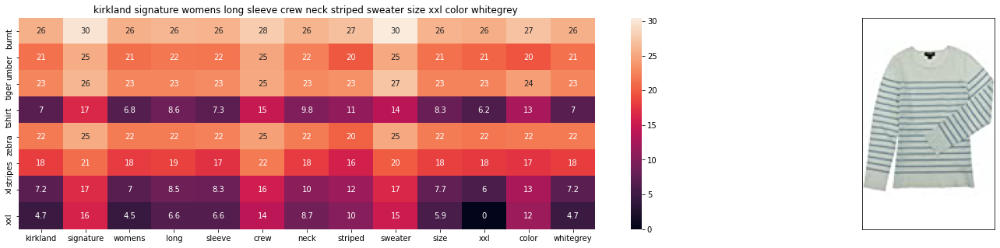

ASIN : B06XTPC3FP
BRAND : Kirkland Signature
euclidean distance from given input image : 14.594409281509126


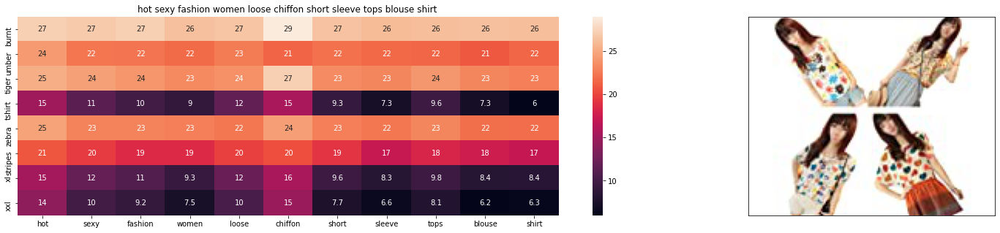

ASIN : B00JMAASRO
BRAND : Wotefusi
euclidean distance from given input image : 14.604873620142008


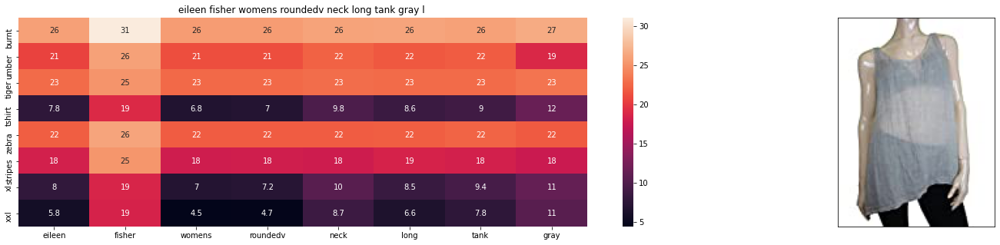

ASIN : B01N2JSRDM
BRAND : Eileen Fisher
euclidean distance from given input image : 14.646470235285168


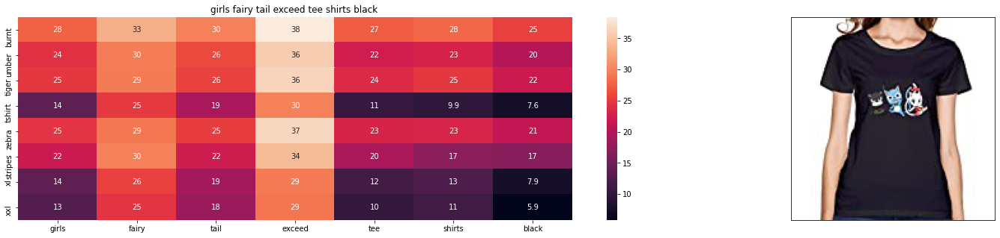

ASIN : B01L9F153U
BRAND : ATYPEMX
euclidean distance from given input image : 14.647337812850342


In [16]:
#w1--> idf_value
#w2--> color
#w3--> brand
#w4--> type
#w5--> image 
final_model(12566, 20, 10, 5, 4, 3, 8)

#### 11.5 Giving more weight to IDF value

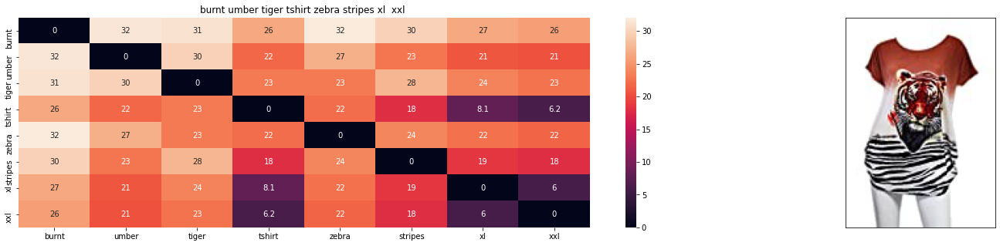

ASIN : B00JXQB5FQ
BRAND : Si Row
euclidean distance from given input image : 8.834398399545428e-07


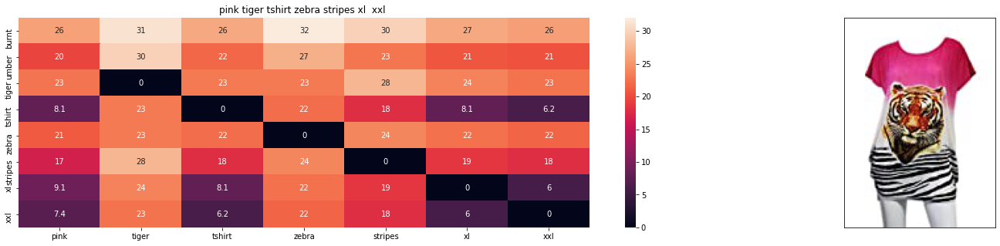

ASIN : B00JXQASS6
BRAND : Si Row
euclidean distance from given input image : 8.263936300881209


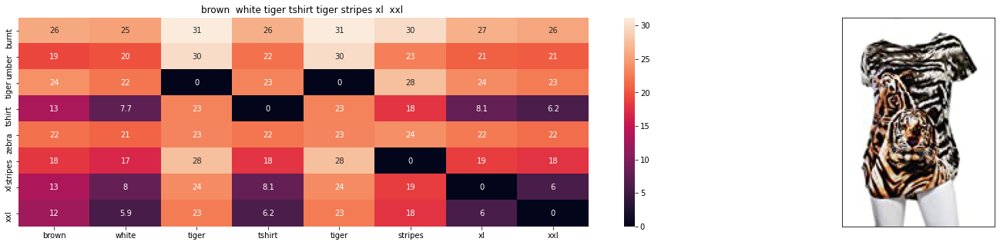

ASIN : B00JXQCWTO
BRAND : Si Row
euclidean distance from given input image : 9.341476619944853


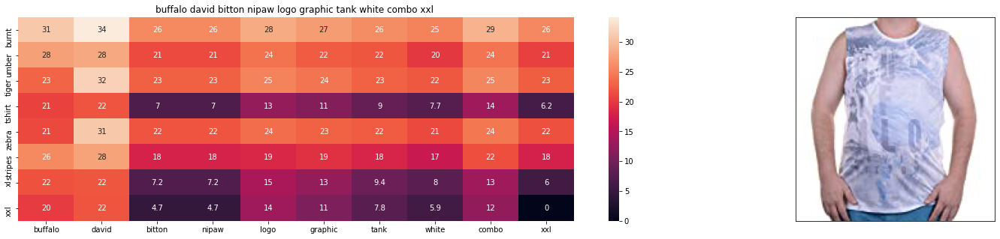

ASIN : B018H5AZXQ
BRAND : Buffalo
euclidean distance from given input image : 9.510505072131902


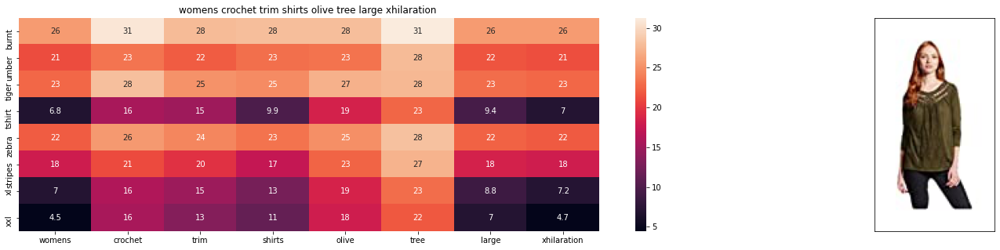

ASIN : B06XBHNM7J
BRAND : Xhilaration
euclidean distance from given input image : 9.531376223326756


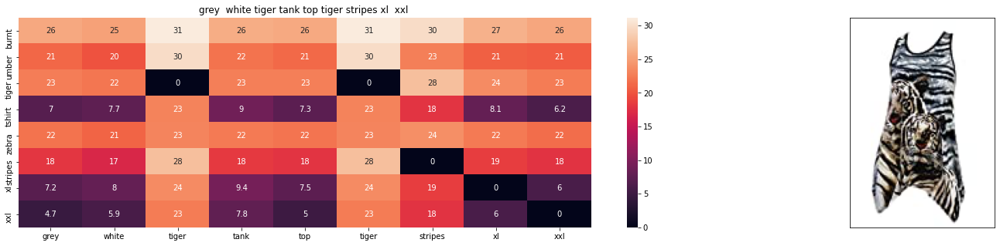

ASIN : B00JXQAFZ2
BRAND : Si Row
euclidean distance from given input image : 9.66372088268268


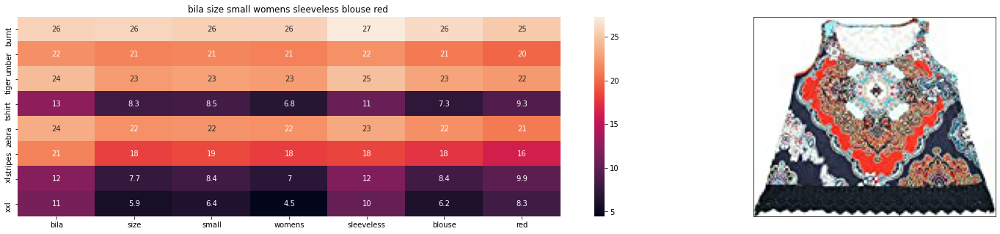

ASIN : B01L7ROZNC
BRAND : Bila
euclidean distance from given input image : 9.753017886460892


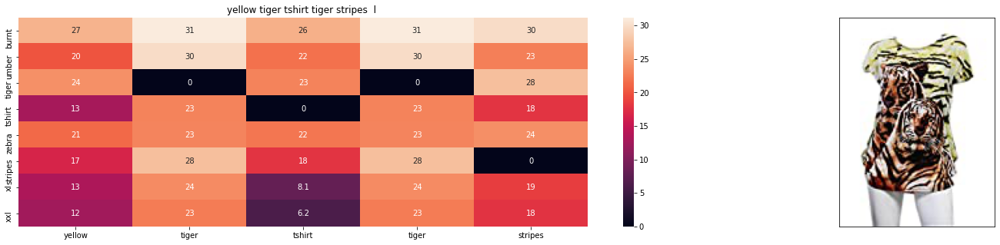

ASIN : B00JXQCUIC
BRAND : Si Row
euclidean distance from given input image : 9.771586878201981


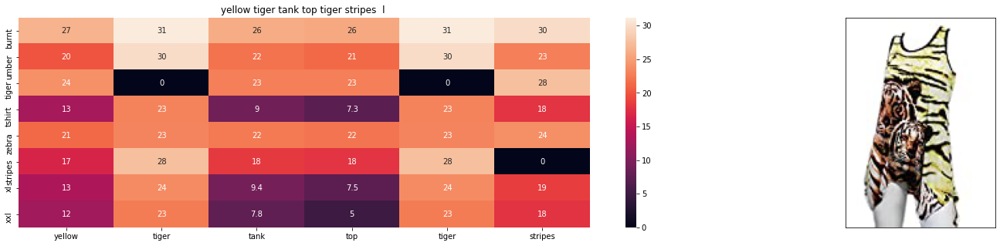

ASIN : B00JXQAUWA
BRAND : Si Row
euclidean distance from given input image : 9.804790721262643


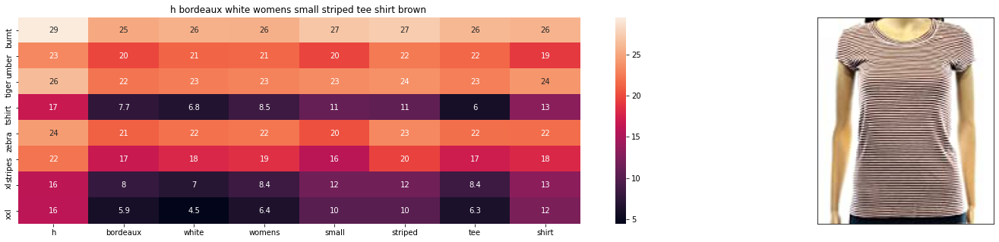

ASIN : B072BVB47Z
BRAND : H By Bordeaux
euclidean distance from given input image : 9.890098930828932


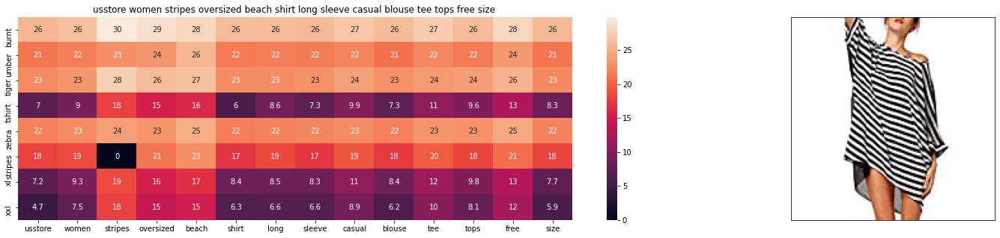

ASIN : B01DNNI1RO
BRAND : Usstore
euclidean distance from given input image : 9.942614231713705


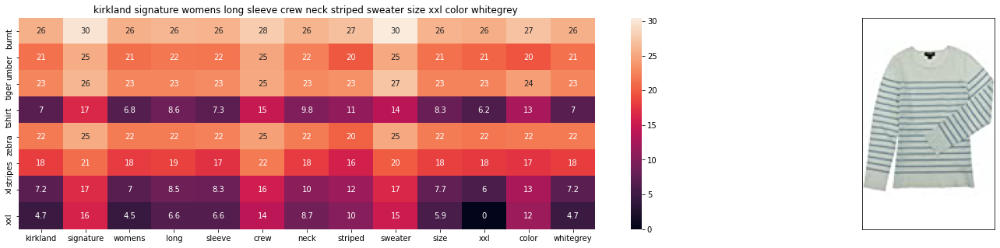

ASIN : B06XTPC3FP
BRAND : Kirkland Signature
euclidean distance from given input image : 9.959573633594331


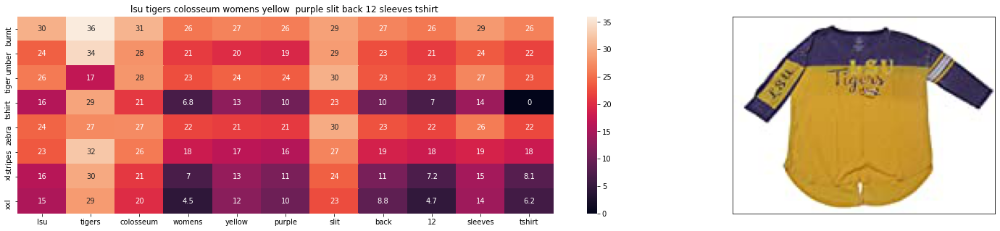

ASIN : B073R5Q8HD
BRAND : Colosseum
euclidean distance from given input image : 9.959965841424127


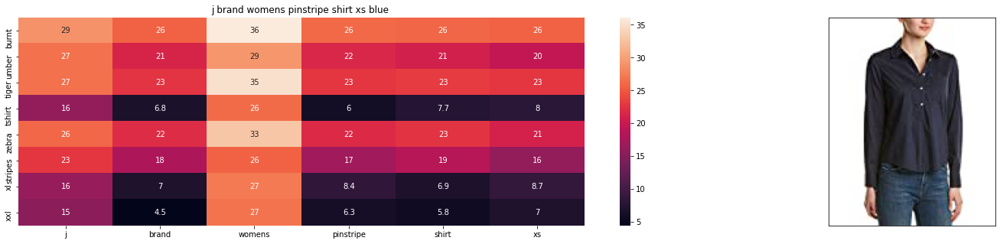

ASIN : B06XYP1X1F
BRAND : J Brand Jeans
euclidean distance from given input image : 9.984249249647867


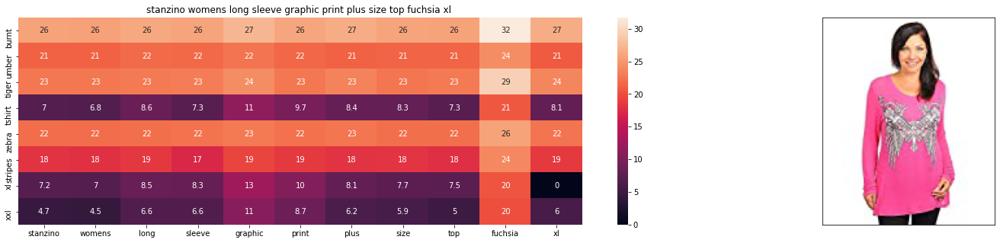

ASIN : B00DP4VHWI
BRAND : Stanzino
euclidean distance from given input image : 9.98837662956751


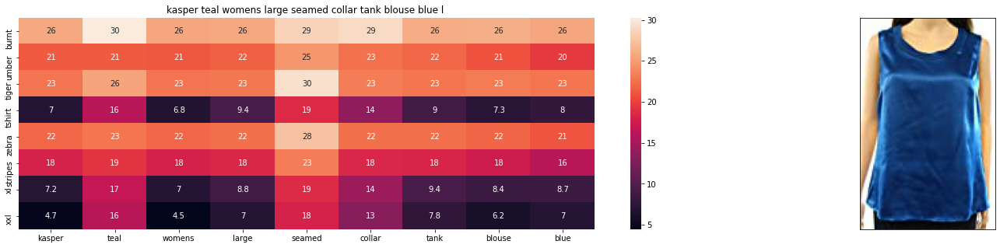

ASIN : B0722DJVQP
BRAND : Kasper
euclidean distance from given input image : 9.998726037885525


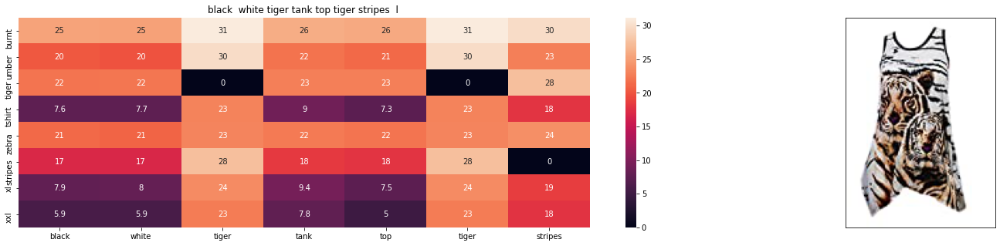

ASIN : B00JXQAO94
BRAND : Si Row
euclidean distance from given input image : 10.012780223215769


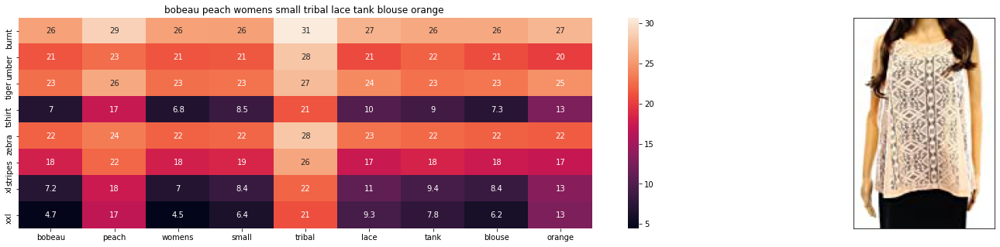

ASIN : B072JTHCX6
BRAND : Bobeau
euclidean distance from given input image : 10.037417300523392


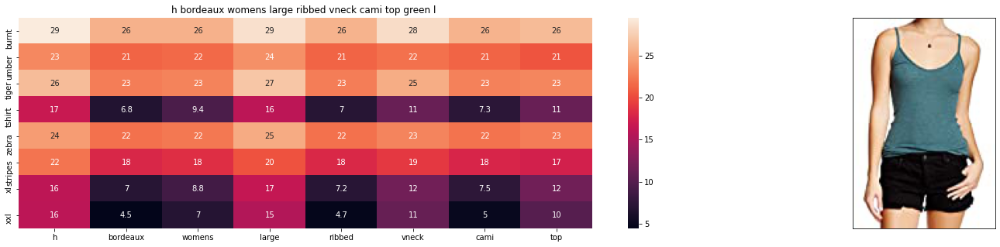

ASIN : B06XWWH6KJ
BRAND : H By Bordeaux
euclidean distance from given input image : 10.04360575962834


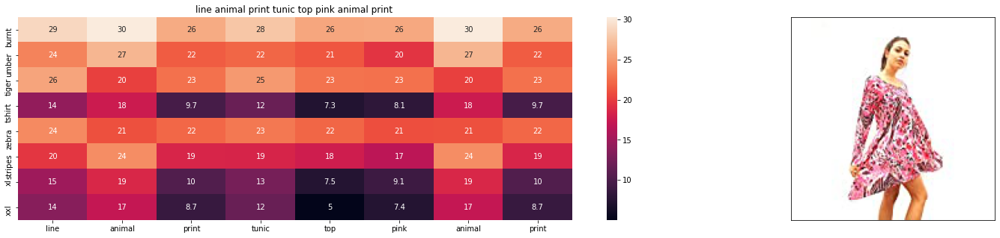

ASIN : B01LMJ5XYK
BRAND : Romeo 4 Ever
euclidean distance from given input image : 10.050288211619375


In [19]:
#w1--> idf_value
#w2--> color
#w3--> brand
#w4--> type
#w5--> image 
final_model(12566, 20, 50, 10, 10, 5, 10)

#### 11.6 Giving more weight to color

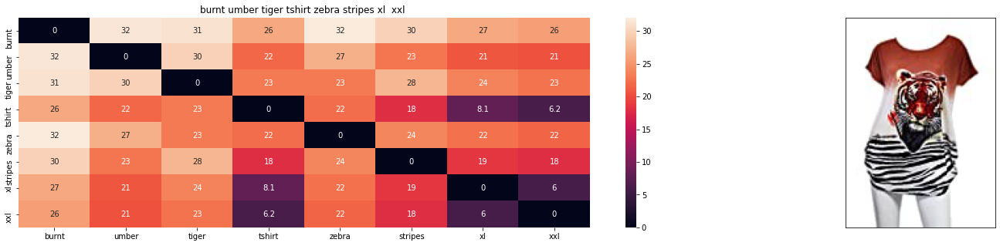

ASIN : B00JXQB5FQ
BRAND : Si Row
euclidean distance from given input image : 1.072748377087659e-06


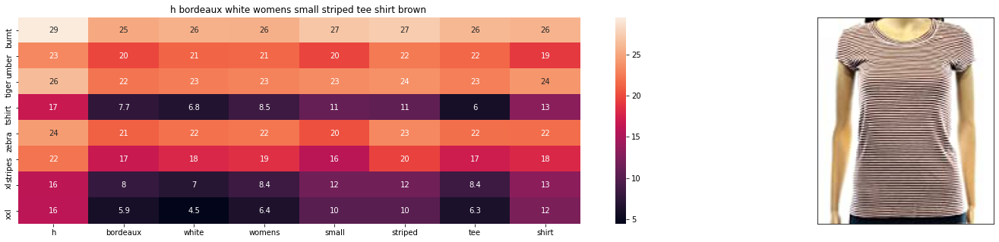

ASIN : B072BVB47Z
BRAND : H By Bordeaux
euclidean distance from given input image : 7.163265021198244


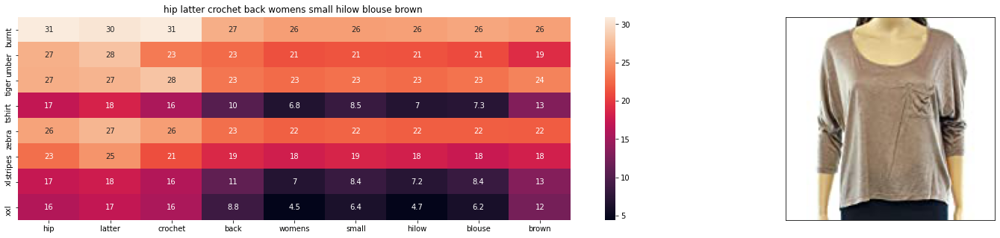

ASIN : B074MJN1K9
BRAND : Hip
euclidean distance from given input image : 7.2075658188349845


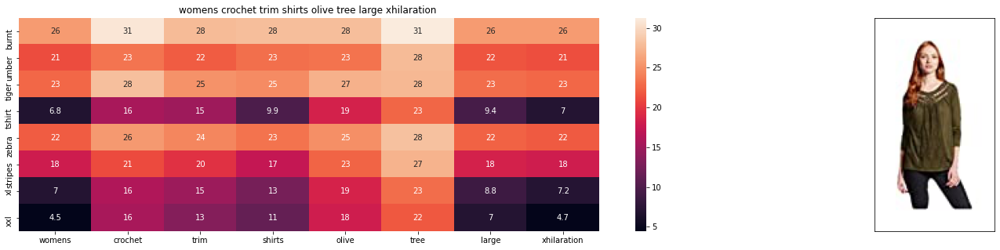

ASIN : B06XBHNM7J
BRAND : Xhilaration
euclidean distance from given input image : 7.230893637839958


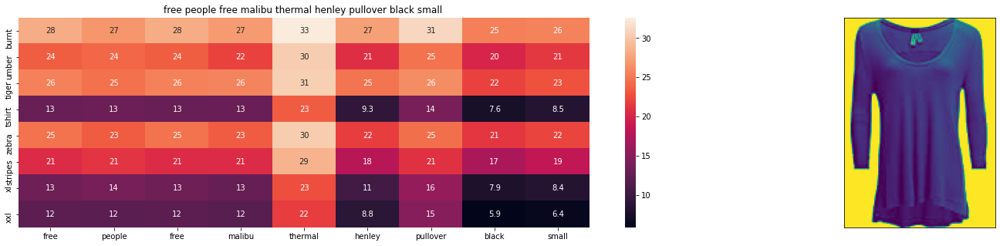

ASIN : B074MXY984
BRAND : We The Free
euclidean distance from given input image : 7.372029147371958


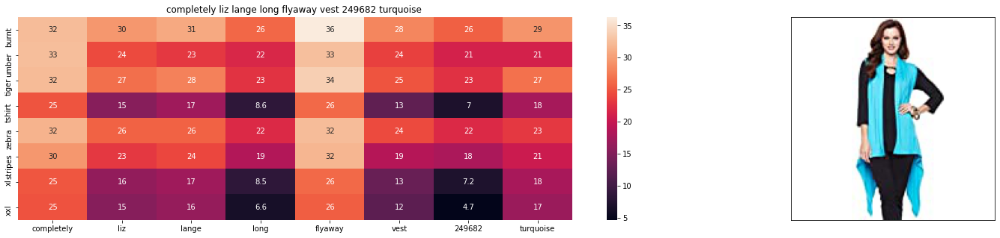

ASIN : B074LTBWSW
BRAND : Liz Lange
euclidean distance from given input image : 7.379621135435165


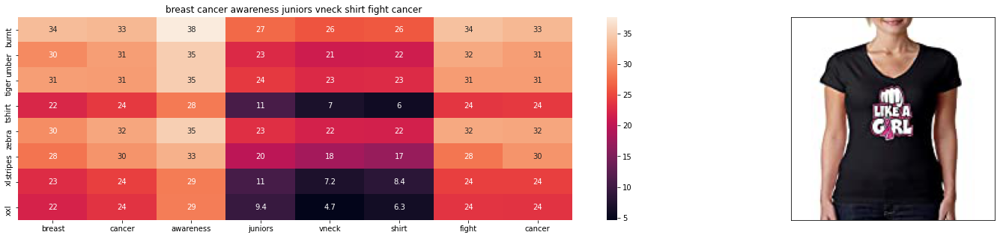

ASIN : B016CU40IY
BRAND : Juiceclouds
euclidean distance from given input image : 7.46736544939445


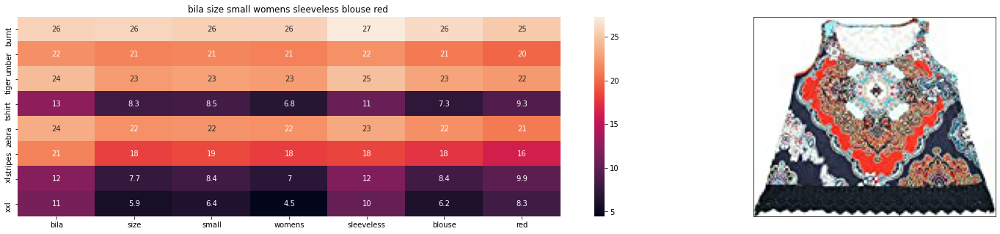

ASIN : B01L7ROZNC
BRAND : Bila
euclidean distance from given input image : 7.530150461775867


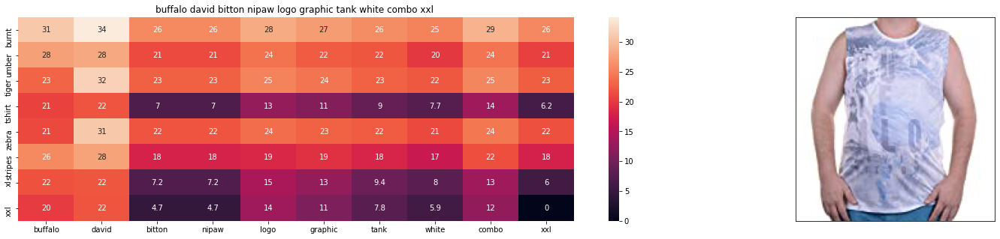

ASIN : B018H5AZXQ
BRAND : Buffalo
euclidean distance from given input image : 7.533627358891855


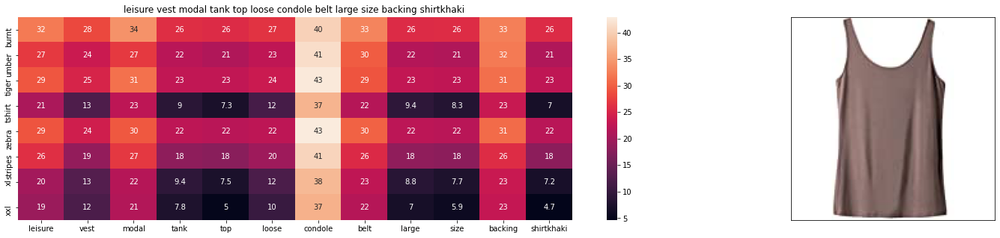

ASIN : B014OUHUZY
BRAND : Black Temptation
euclidean distance from given input image : 7.550423060836218


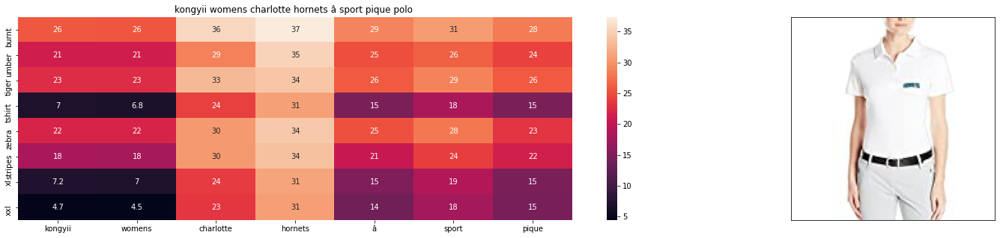

ASIN : B01FJVZST2
BRAND : KONGYII
euclidean distance from given input image : 7.605994872263452


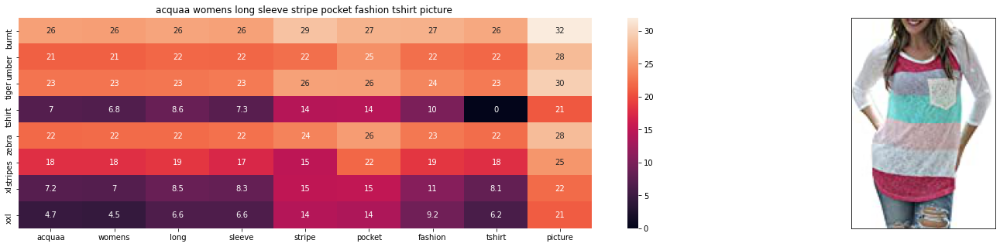

ASIN : B06XK2ZRFH
BRAND : Acquaa
euclidean distance from given input image : 7.649018063184873


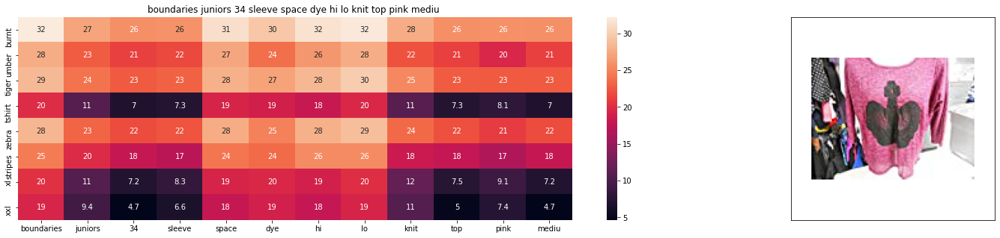

ASIN : B01EXXFS4M
BRAND : No Boundaries
euclidean distance from given input image : 7.675944257732179


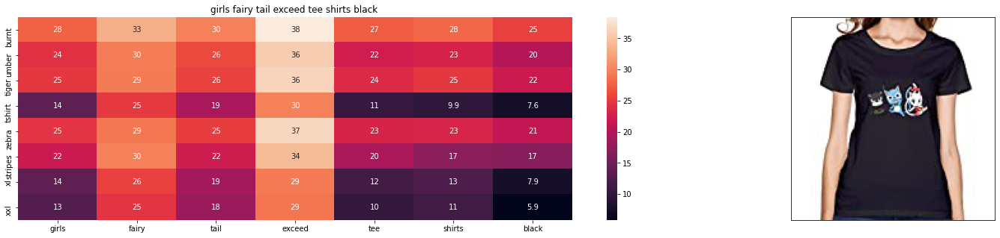

ASIN : B01L9F153U
BRAND : ATYPEMX
euclidean distance from given input image : 7.697771529367944


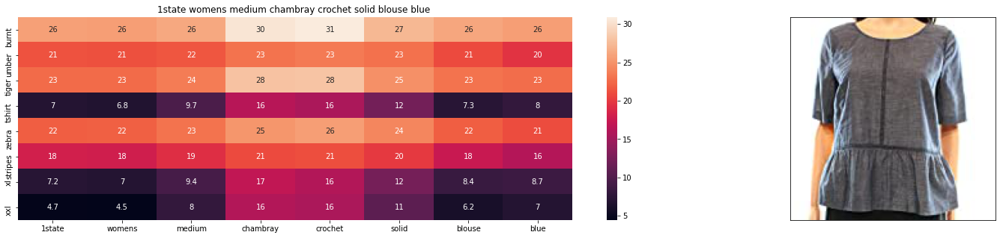

ASIN : B074MK6LV2
BRAND : 1.State
euclidean distance from given input image : 7.709928860562139


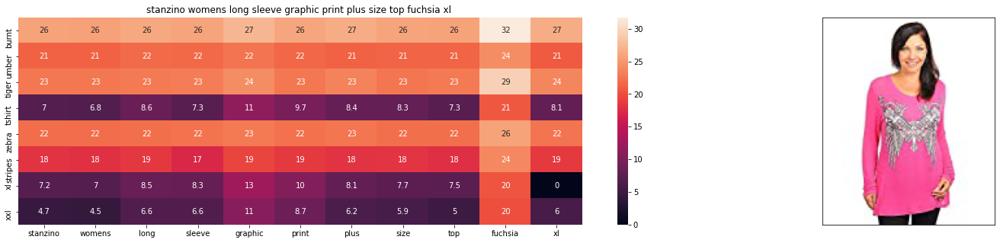

ASIN : B00DP4VHWI
BRAND : Stanzino
euclidean distance from given input image : 7.731021684135661


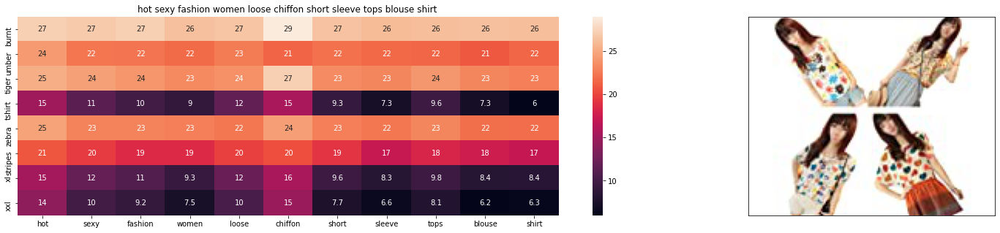

ASIN : B00JMAASRO
BRAND : Wotefusi
euclidean distance from given input image : 7.758877747978435


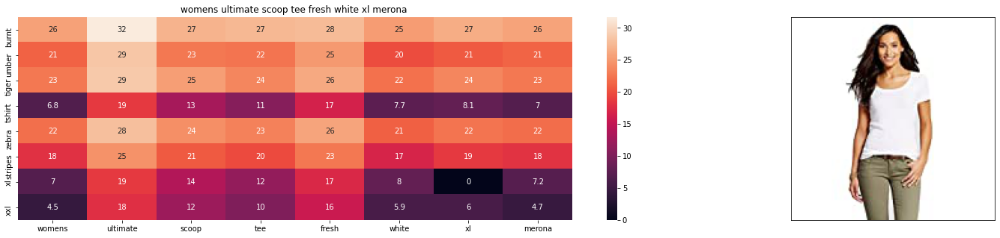

ASIN : B01G7XE50E
BRAND : Merona
euclidean distance from given input image : 7.78344952096253


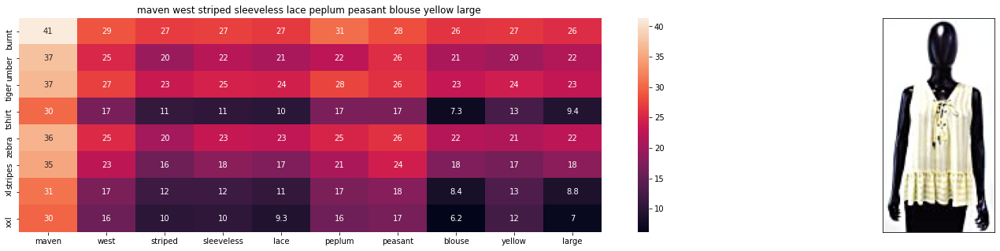

ASIN : B01M8GB3AL
BRAND : Maven West
euclidean distance from given input image : 7.786322904582765


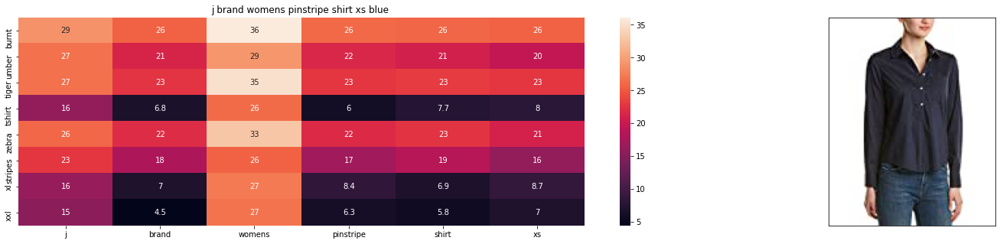

ASIN : B06XYP1X1F
BRAND : J Brand Jeans
euclidean distance from given input image : 7.790041416723495


In [20]:
#w1--> idf_value
#w2--> color
#w3--> brand
#w4--> type
#w5--> image 
final_model(12566, 20, 5, 50, 3, 2, 10)

#### 11.7 Giving more weight to brand



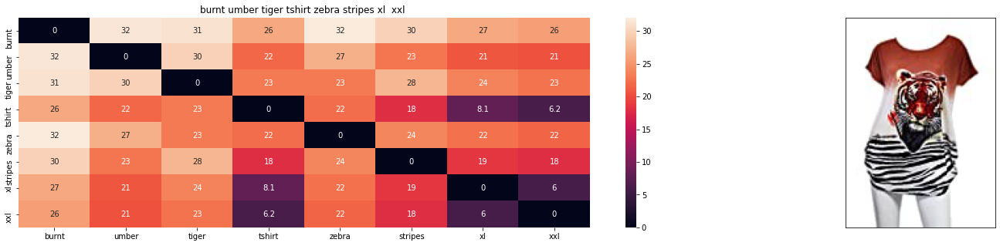

ASIN : B00JXQB5FQ
BRAND : Si Row
euclidean distance from given input image : 7.90446201311792e-07


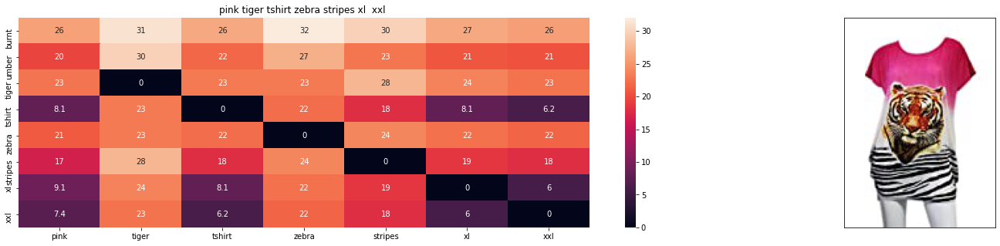

ASIN : B00JXQASS6
BRAND : Si Row
euclidean distance from given input image : 5.734058229570572


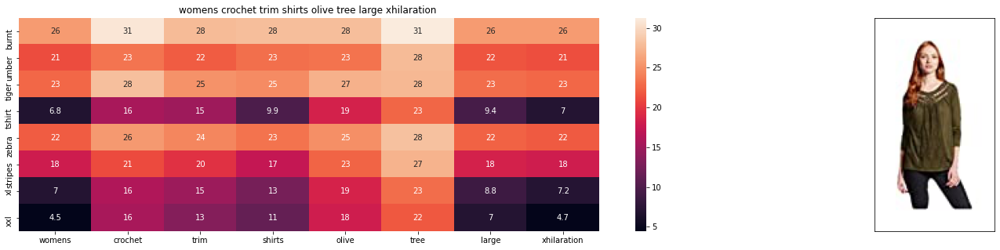

ASIN : B06XBHNM7J
BRAND : Xhilaration
euclidean distance from given input image : 6.267408410109854


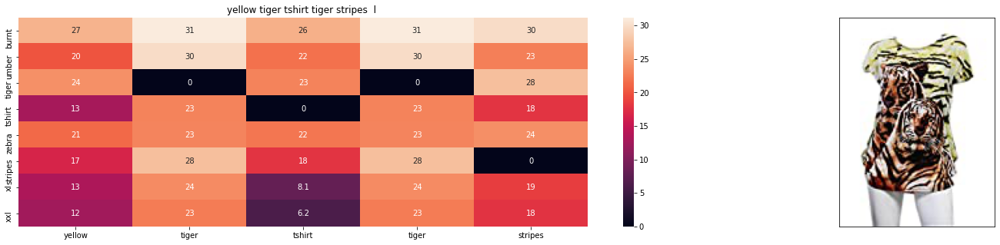

ASIN : B00JXQCUIC
BRAND : Si Row
euclidean distance from given input image : 6.360815700755555


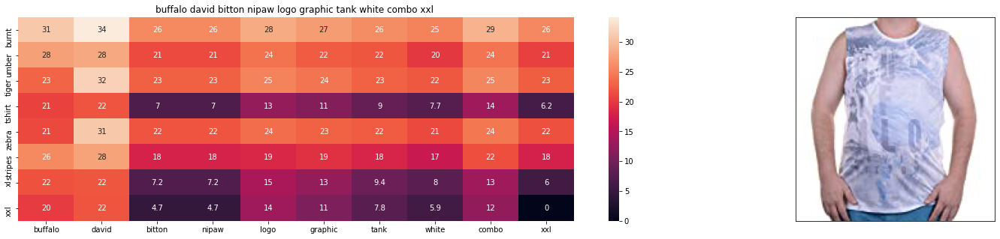

ASIN : B018H5AZXQ
BRAND : Buffalo
euclidean distance from given input image : 6.45018541334793


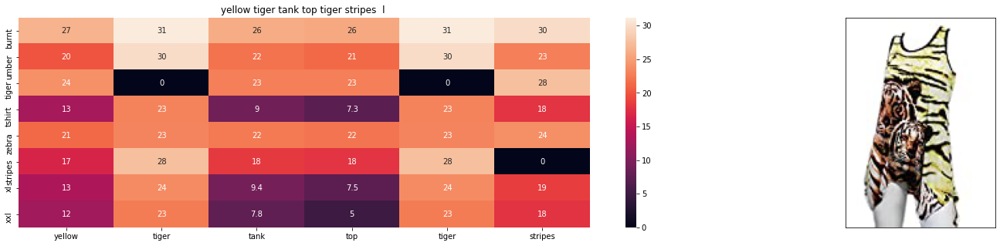

ASIN : B00JXQAUWA
BRAND : Si Row
euclidean distance from given input image : 6.471018941802661


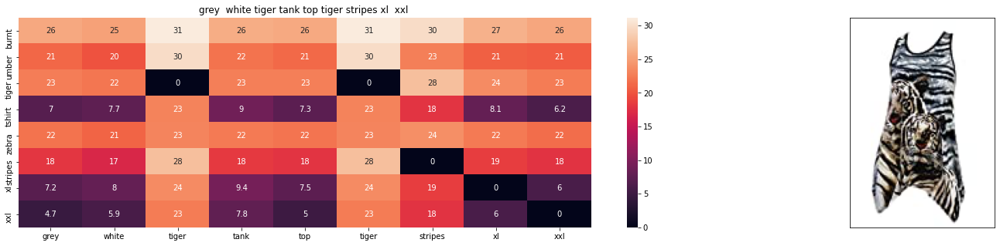

ASIN : B00JXQAFZ2
BRAND : Si Row
euclidean distance from given input image : 6.474810198757456


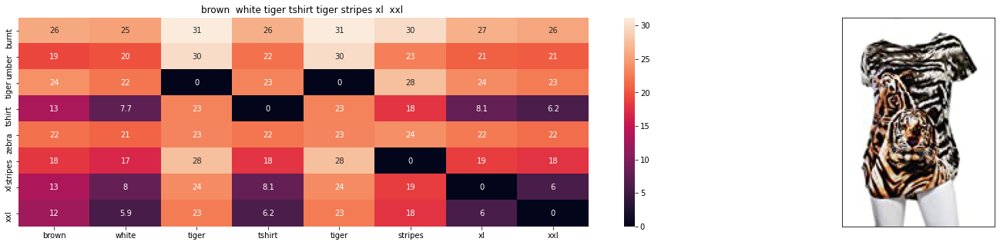

ASIN : B00JXQCWTO
BRAND : Si Row
euclidean distance from given input image : 6.474897284256785


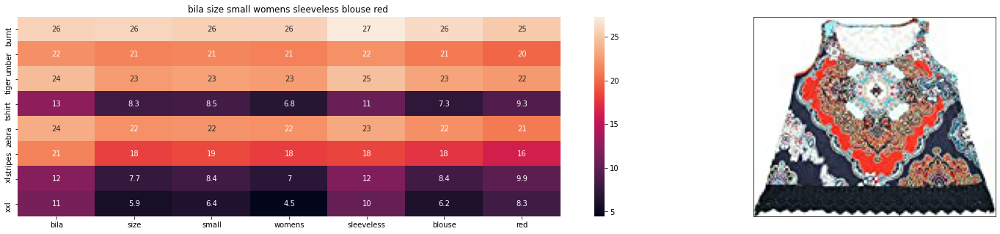

ASIN : B01L7ROZNC
BRAND : Bila
euclidean distance from given input image : 6.608282648675048


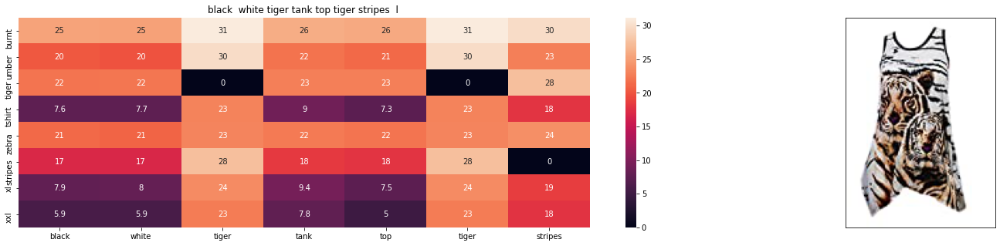

ASIN : B00JXQAO94
BRAND : Si Row
euclidean distance from given input image : 6.6557339116384435


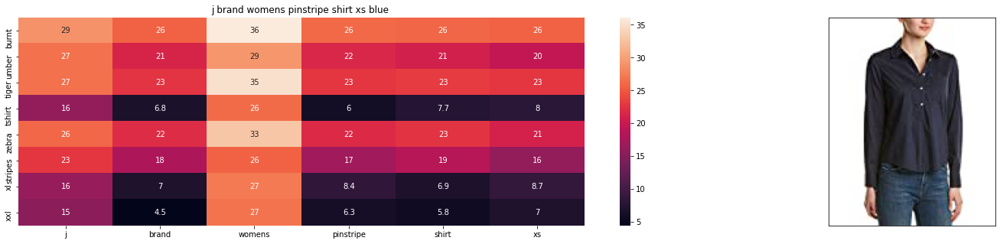

ASIN : B06XYP1X1F
BRAND : J Brand Jeans
euclidean distance from given input image : 6.738214532966825


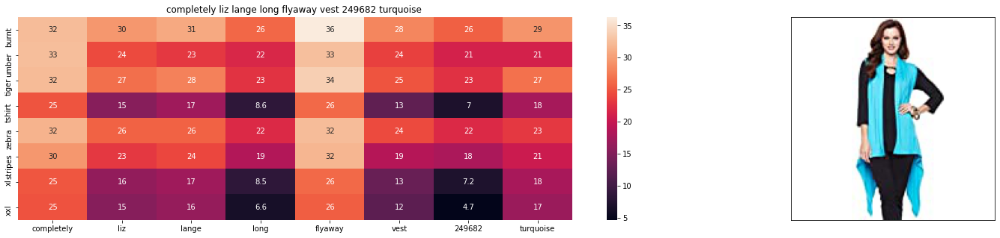

ASIN : B074LTBWSW
BRAND : Liz Lange
euclidean distance from given input image : 6.750159153223432


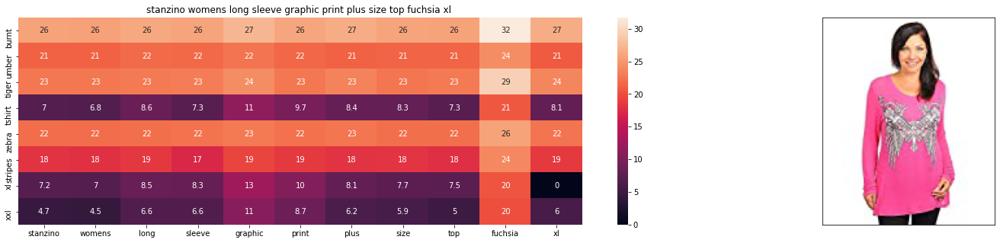

ASIN : B00DP4VHWI
BRAND : Stanzino
euclidean distance from given input image : 6.766721782971666


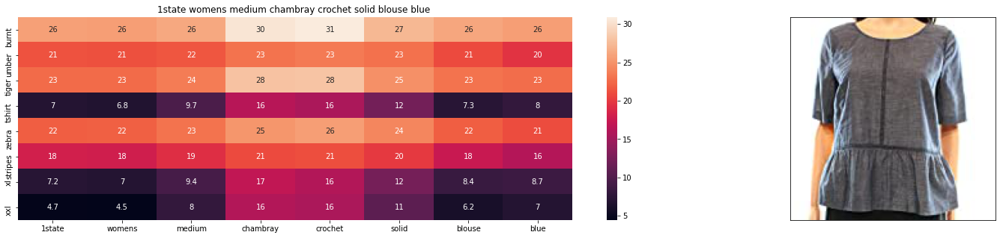

ASIN : B074MK6LV2
BRAND : 1.State
euclidean distance from given input image : 6.779499513009958


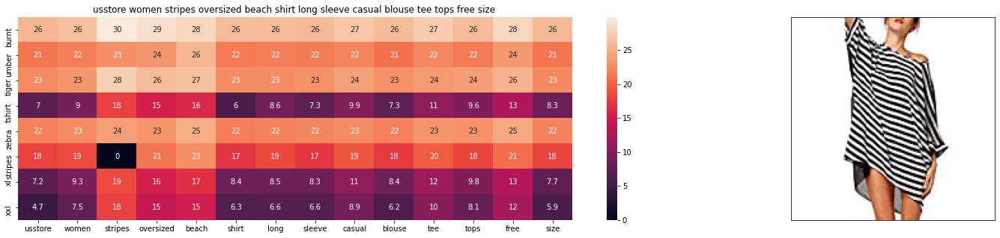

ASIN : B01DNNI1RO
BRAND : Usstore
euclidean distance from given input image : 6.785703397035482


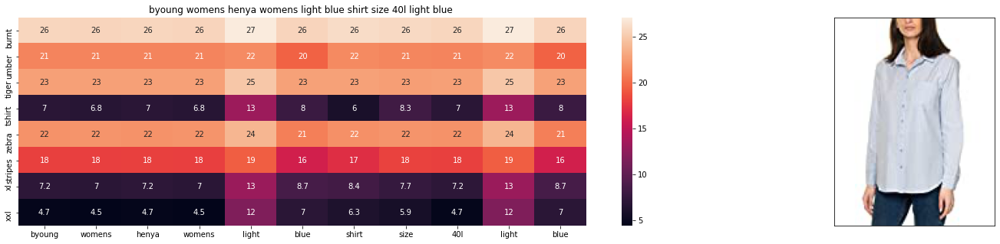

ASIN : B06Y41MRCH
BRAND : Byoung
euclidean distance from given input image : 6.790397281634063


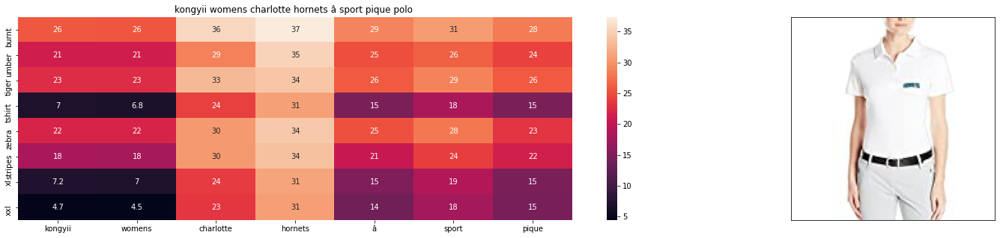

ASIN : B01FJVZST2
BRAND : KONGYII
euclidean distance from given input image : 6.796766338635728


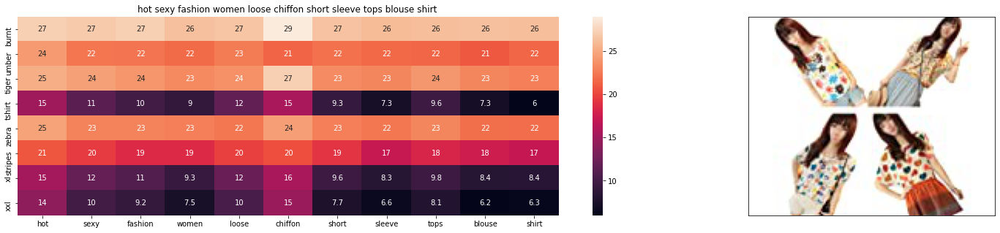

ASIN : B00JMAASRO
BRAND : Wotefusi
euclidean distance from given input image : 6.813428233584587


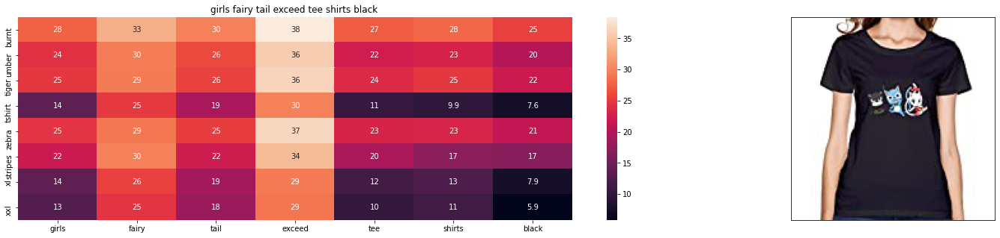

ASIN : B01L9F153U
BRAND : ATYPEMX
euclidean distance from given input image : 6.830190414916824


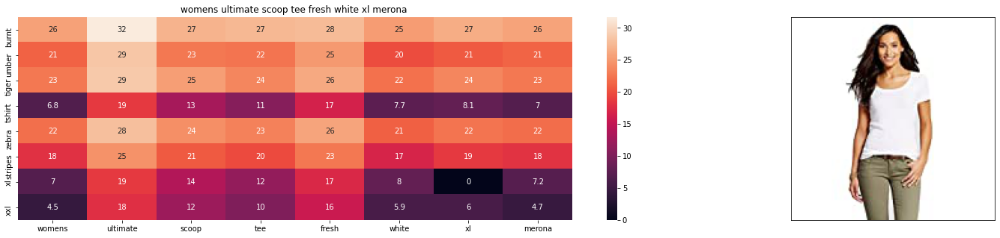

ASIN : B01G7XE50E
BRAND : Merona
euclidean distance from given input image : 6.858930544889583


In [21]:
#w1--> idf_value
#w2--> color
#w3--> brand
#w4--> type
#w5--> image 
final_model(12566, 20, 10, 5, 50, 3, 8)

#### 11.8 Giving more weight to more product type

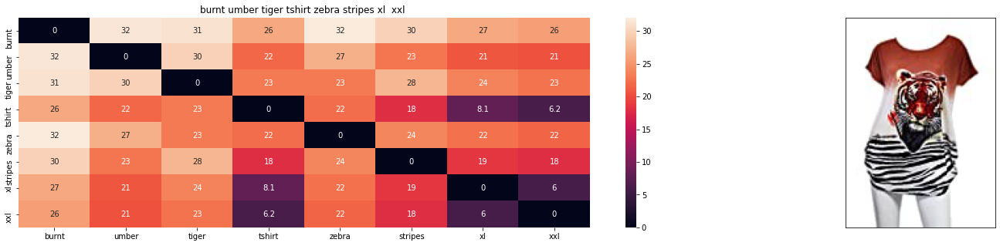

ASIN : B00JXQB5FQ
BRAND : Si Row
euclidean distance from given input image : 8.461114267562844e-07


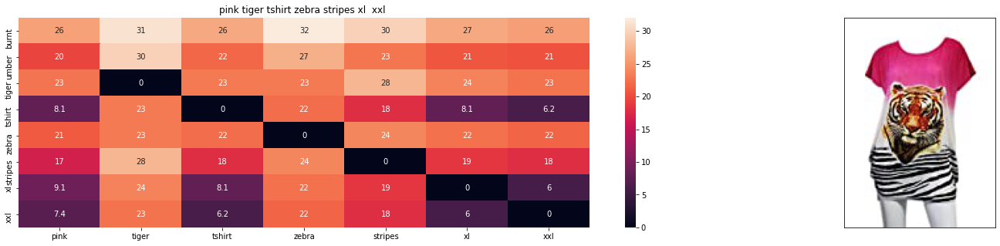

ASIN : B00JXQASS6
BRAND : Si Row
euclidean distance from given input image : 5.831757446094509


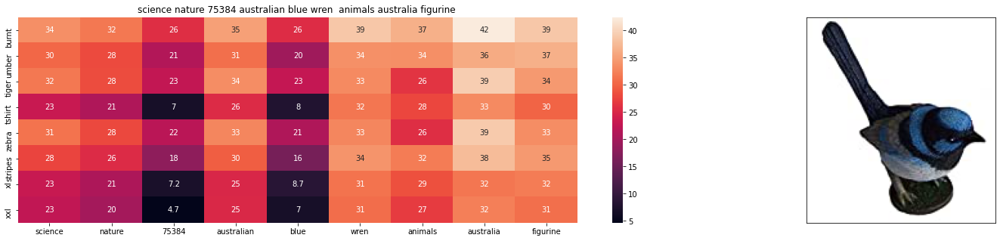

ASIN : B00BQRY5UC
BRAND : Science and Nature
euclidean distance from given input image : 5.8496077425219974


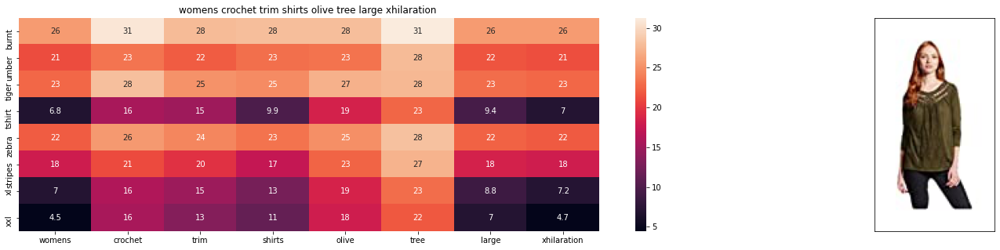

ASIN : B06XBHNM7J
BRAND : Xhilaration
euclidean distance from given input image : 5.93981647867183


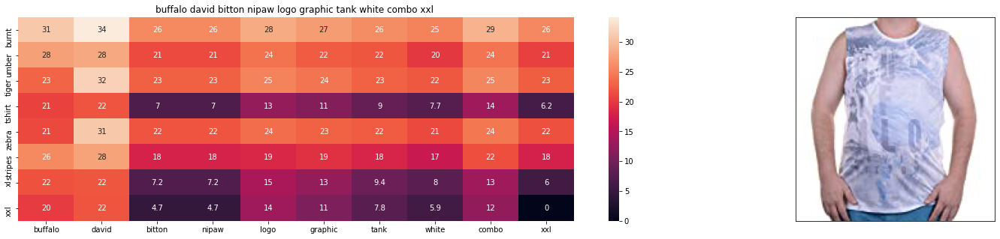

ASIN : B018H5AZXQ
BRAND : Buffalo
euclidean distance from given input image : 6.171404707998964


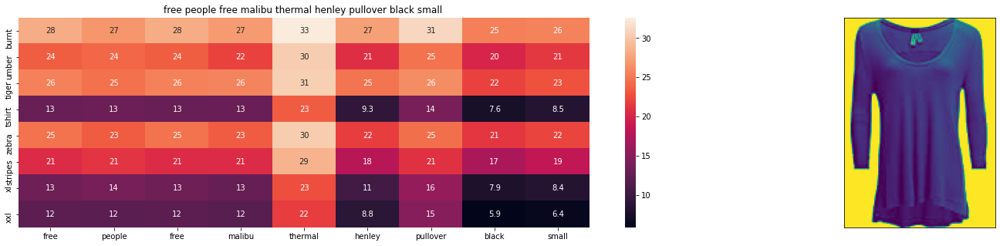

ASIN : B074MXY984
BRAND : We The Free
euclidean distance from given input image : 6.230678054416837


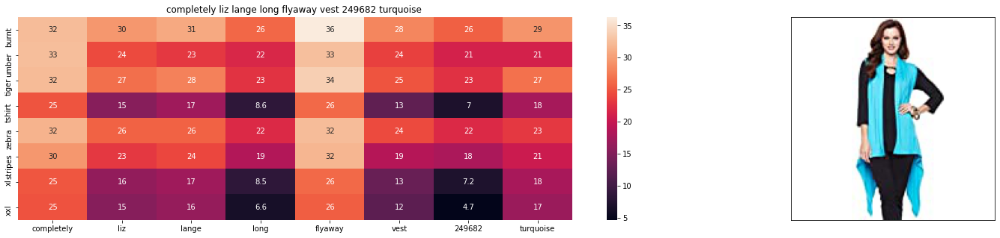

ASIN : B074LTBWSW
BRAND : Liz Lange
euclidean distance from given input image : 6.234838211979158


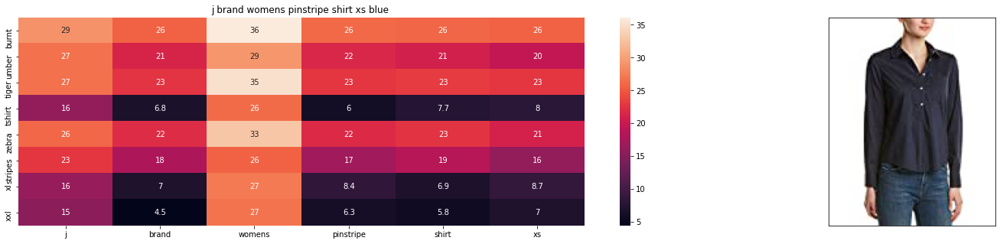

ASIN : B06XYP1X1F
BRAND : J Brand Jeans
euclidean distance from given input image : 6.253576574445732


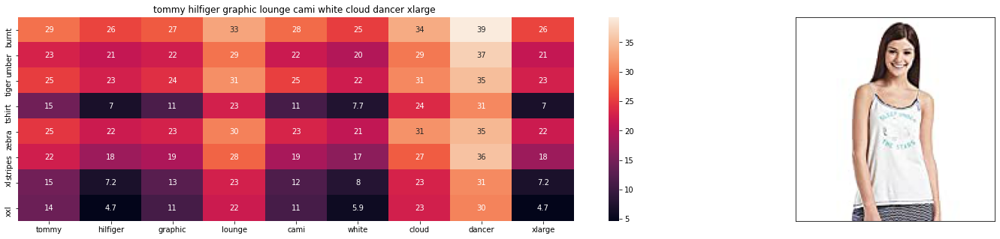

ASIN : B01BMSFYW2
BRAND : igertommy hilf
euclidean distance from given input image : 6.328413788955937


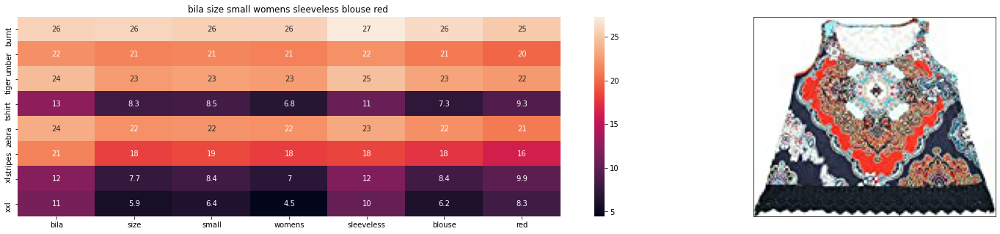

ASIN : B01L7ROZNC
BRAND : Bila
euclidean distance from given input image : 6.332368088451595


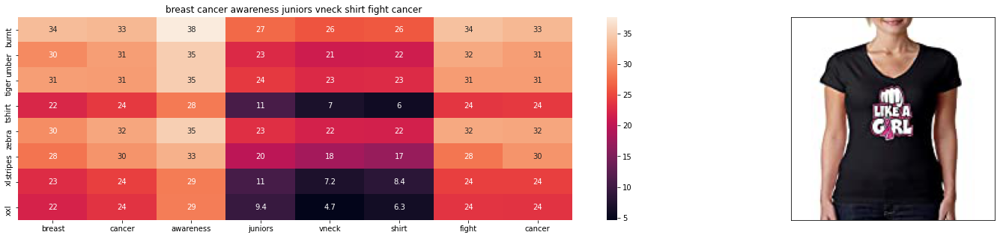

ASIN : B016CU40IY
BRAND : Juiceclouds
euclidean distance from given input image : 6.347180396749626


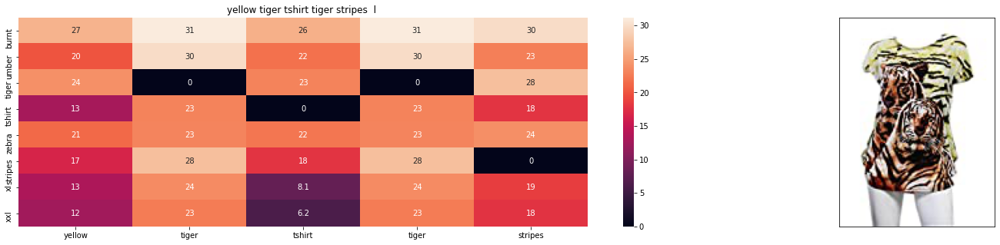

ASIN : B00JXQCUIC
BRAND : Si Row
euclidean distance from given input image : 6.373810829935151


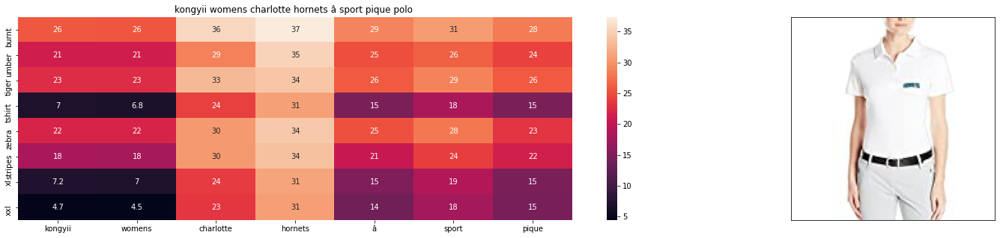

ASIN : B01FJVZST2
BRAND : KONGYII
euclidean distance from given input image : 6.415844786346485


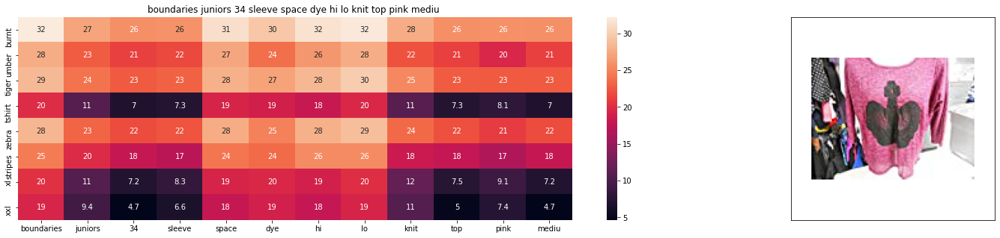

ASIN : B01EXXFS4M
BRAND : No Boundaries
euclidean distance from given input image : 6.461467818414154


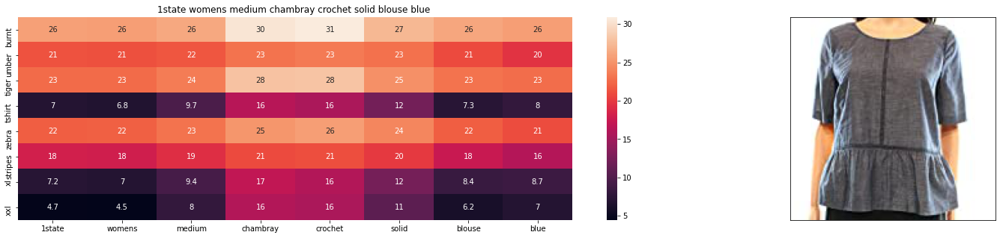

ASIN : B074MK6LV2
BRAND : 1.State
euclidean distance from given input image : 6.481077882616979


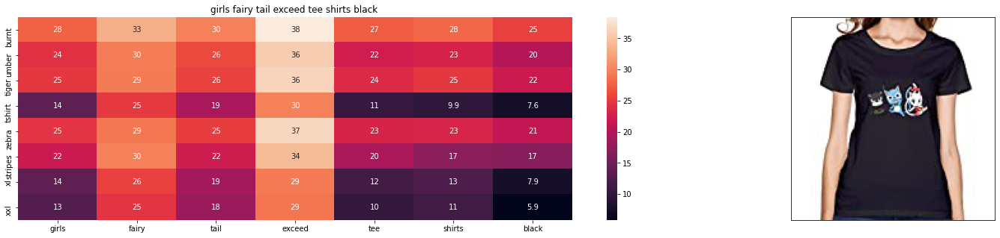

ASIN : B01L9F153U
BRAND : ATYPEMX
euclidean distance from given input image : 6.482130524149769


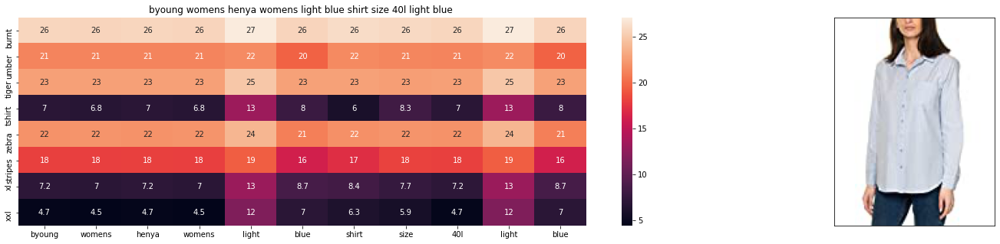

ASIN : B06Y41MRCH
BRAND : Byoung
euclidean distance from given input image : 6.487858185025675


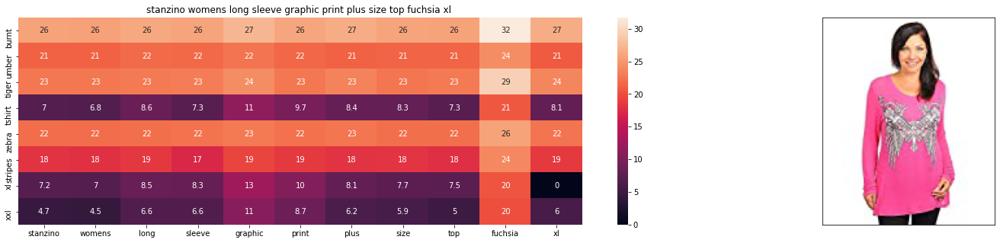

ASIN : B00DP4VHWI
BRAND : Stanzino
euclidean distance from given input image : 6.492662043650071


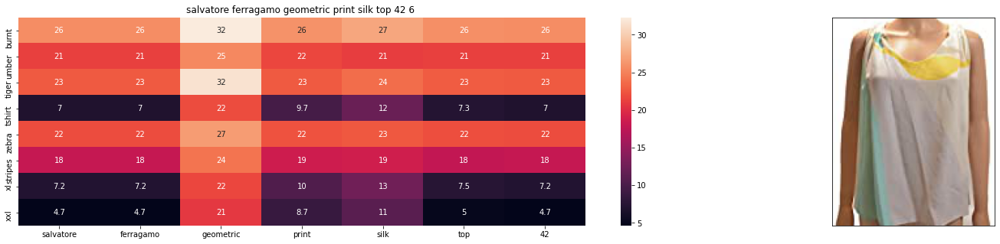

ASIN : B0756JTS1F
BRAND : Salvatore Ferragamo
euclidean distance from given input image : 6.499634429089934


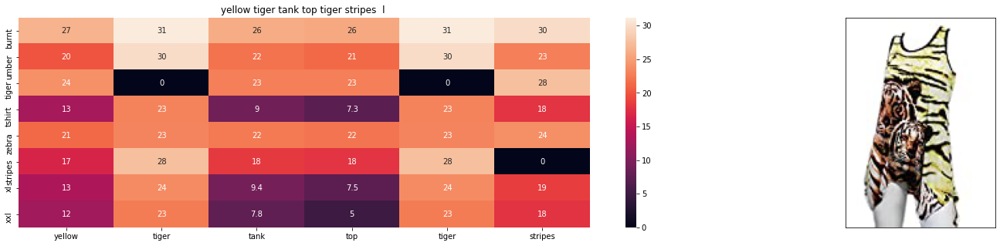

ASIN : B00JXQAUWA
BRAND : Si Row
euclidean distance from given input image : 6.5061353979179986


In [22]:
#w1--> idf_value
#w2--> color
#w3--> brand
#w4--> type
#w5--> image 
final_model(12566, 20, 5, 4, 4, 50, 8)

#### 11.8 Giving more weight to Image

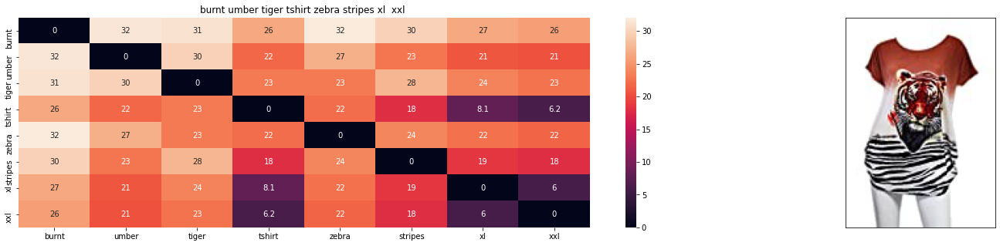

ASIN : B00JXQB5FQ
BRAND : Si Row
euclidean distance from given input image : 5.214749156342198e-06


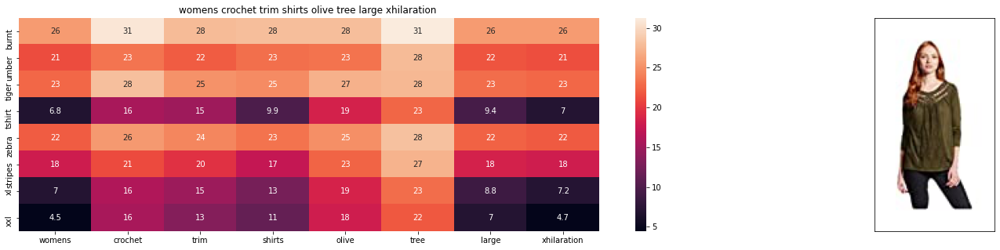

ASIN : B06XBHNM7J
BRAND : Xhilaration
euclidean distance from given input image : 27.201876181622517


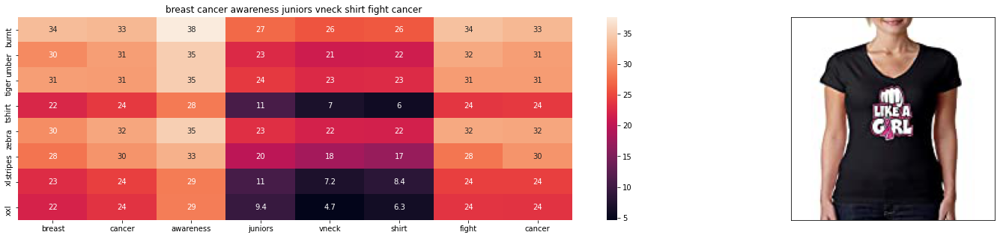

ASIN : B016CU40IY
BRAND : Juiceclouds
euclidean distance from given input image : 28.54994772319556


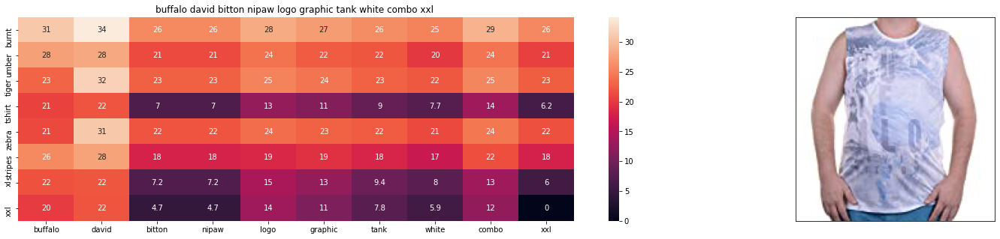

ASIN : B018H5AZXQ
BRAND : Buffalo
euclidean distance from given input image : 28.77982104314053


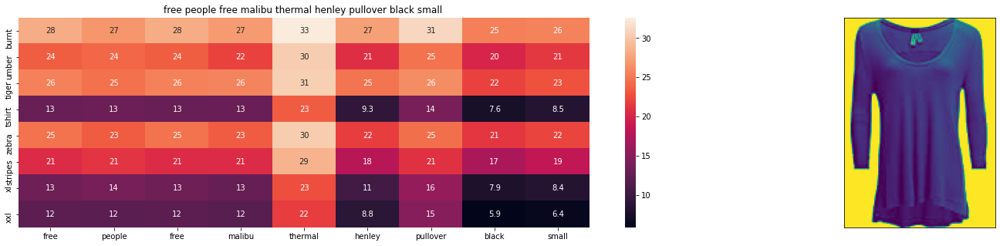

ASIN : B074MXY984
BRAND : We The Free
euclidean distance from given input image : 28.788518694577355


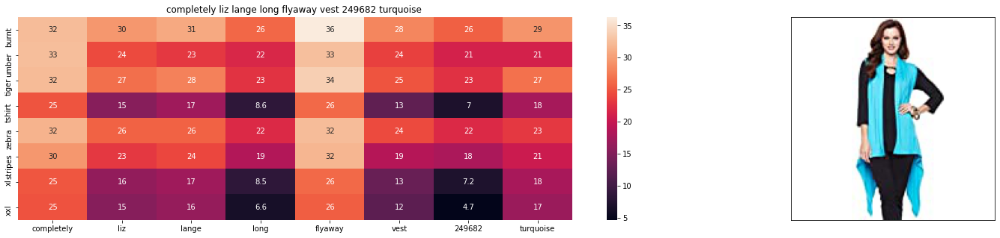

ASIN : B074LTBWSW
BRAND : Liz Lange
euclidean distance from given input image : 28.80983833740859


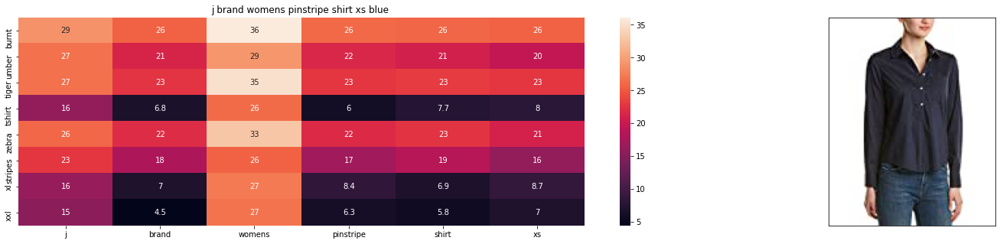

ASIN : B06XYP1X1F
BRAND : J Brand Jeans
euclidean distance from given input image : 28.929301728157686


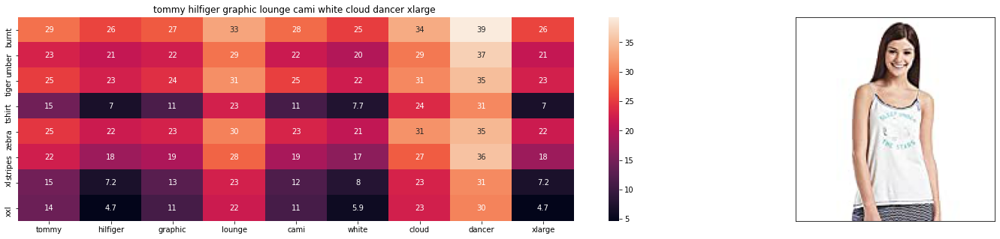

ASIN : B01BMSFYW2
BRAND : igertommy hilf
euclidean distance from given input image : 29.144453091106634


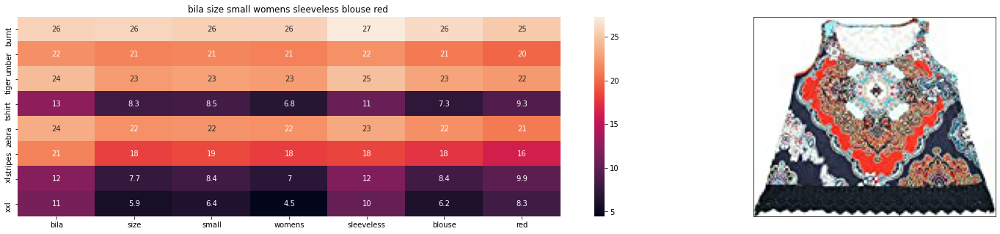

ASIN : B01L7ROZNC
BRAND : Bila
euclidean distance from given input image : 29.80674784492679


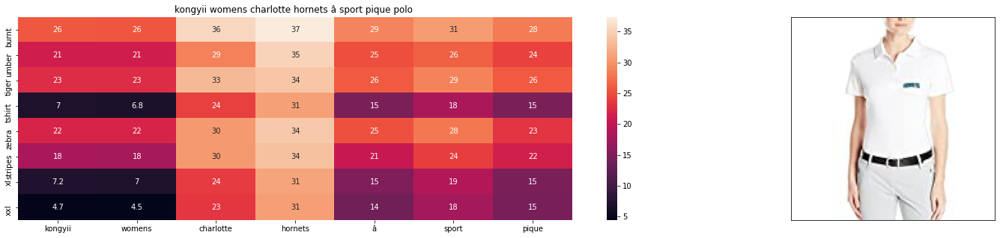

ASIN : B01FJVZST2
BRAND : KONGYII
euclidean distance from given input image : 29.82552028806237


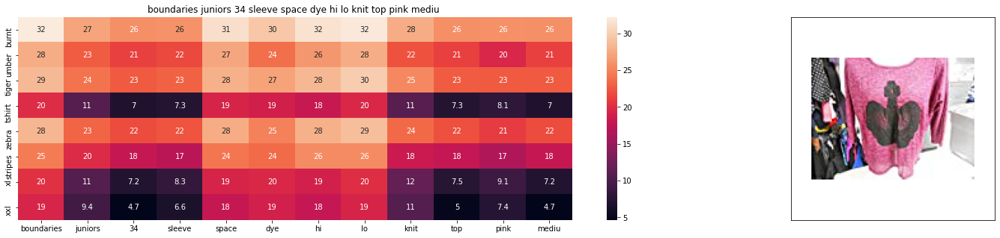

ASIN : B01EXXFS4M
BRAND : No Boundaries
euclidean distance from given input image : 30.355174001098096


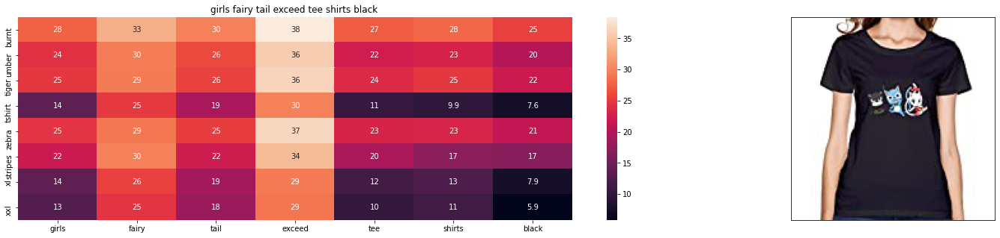

ASIN : B01L9F153U
BRAND : ATYPEMX
euclidean distance from given input image : 30.36191133437449


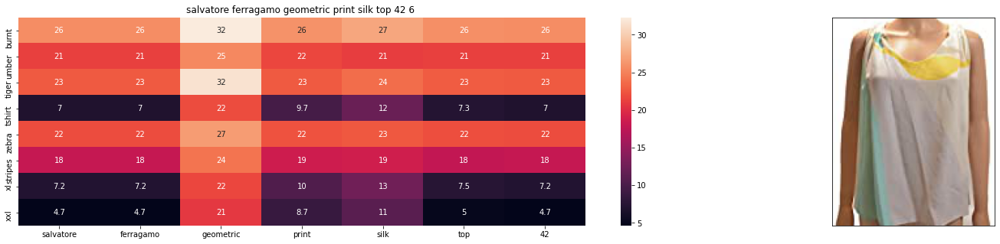

ASIN : B0756JTS1F
BRAND : Salvatore Ferragamo
euclidean distance from given input image : 30.50251740533939


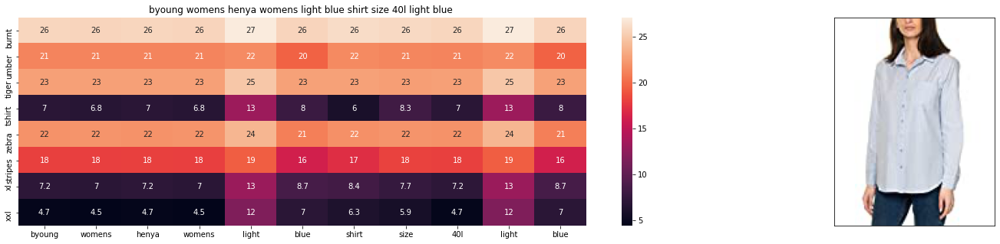

ASIN : B06Y41MRCH
BRAND : Byoung
euclidean distance from given input image : 30.5302066454558


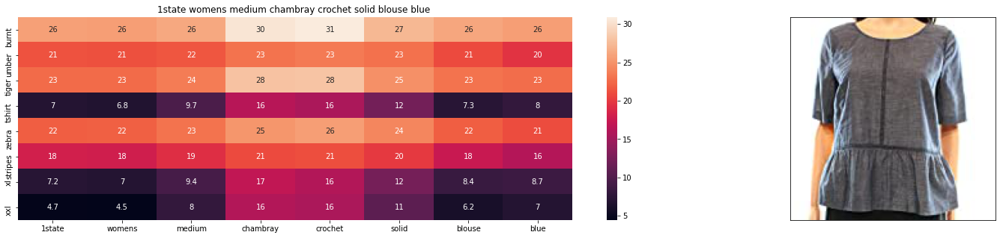

ASIN : B074MK6LV2
BRAND : 1.State
euclidean distance from given input image : 30.578414901540288


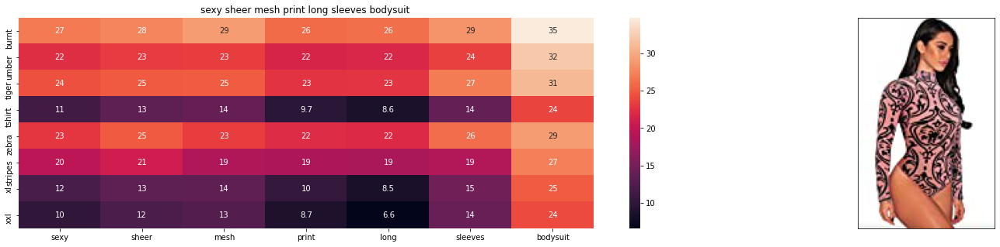

ASIN : B074Z5C98D
BRAND : Ariella's closet
euclidean distance from given input image : 30.747944716334487


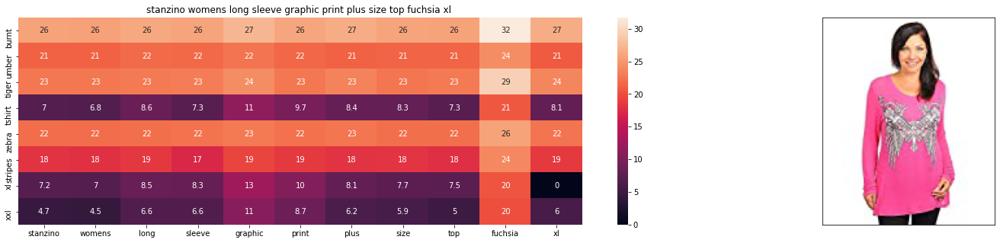

ASIN : B00DP4VHWI
BRAND : Stanzino
euclidean distance from given input image : 30.75568123437856


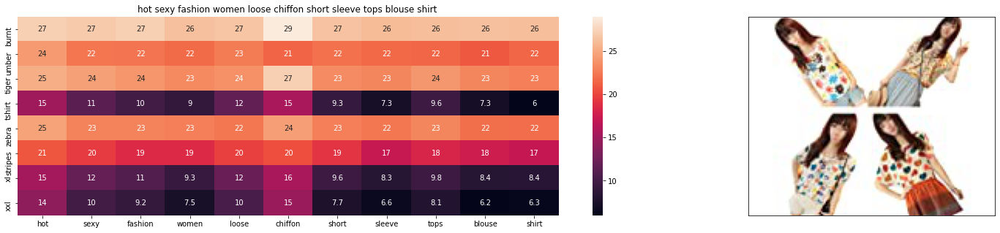

ASIN : B00JMAASRO
BRAND : Wotefusi
euclidean distance from given input image : 30.822007057844544


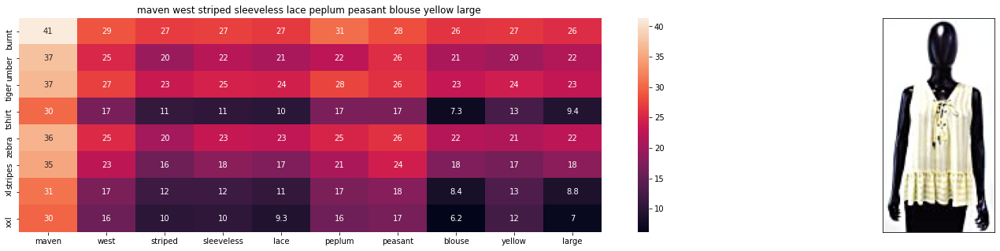

ASIN : B01M8GB3AL
BRAND : Maven West
euclidean distance from given input image : 30.835068109340554


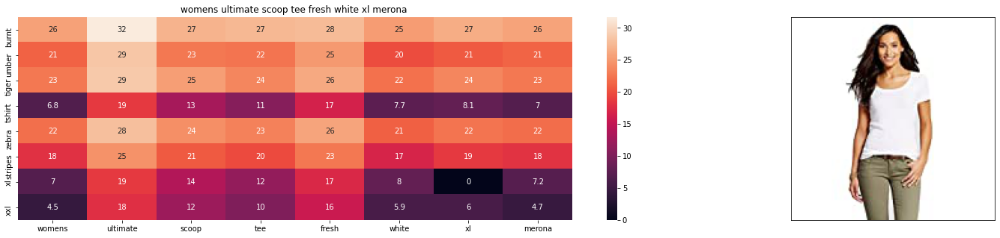

ASIN : B01G7XE50E
BRAND : Merona
euclidean distance from given input image : 30.869157351830545


In [23]:
#w1--> idf_value
#w2--> color
#w3--> brand
#w4--> type
#w5--> image 
final_model(12566, 20, 10, 5, 4, 3, 50)

# Summary:

In [24]:
from prettytable import PrettyTable
x = PrettyTable()

x.field_names = ['model', 'Similarity measure', 'w1_idf_value', 'w2_color', 'w3_brand', 'w4_type', 'w5_image']
x.add_row(['idf_based', 'Euclidean', 50, 10, 10, 5, 10])
x.add_row(['idf_based', 'Euclidean', 5, 50, 3, 2, 10])
x.add_row(['idf_based', 'Euclidean', 10, 5, 50, 3, 8])
x.add_row(['idf_based', 'Euclidean', 5, 4, 4, 50, 8])
x.add_row(['idf_based', 'Euclidean', 10, 5, 4, 3, 50])
print(x)

+-----------+--------------------+--------------+----------+----------+---------+----------+
|   model   | Similarity measure | w1_idf_value | w2_color | w3_brand | w4_type | w5_image |
+-----------+--------------------+--------------+----------+----------+---------+----------+
| idf_based |     Euclidean      |      50      |    10    |    10    |    5    |    10    |
| idf_based |     Euclidean      |      5       |    50    |    3     |    2    |    10    |
| idf_based |     Euclidean      |      10      |    5     |    50    |    3    |    8     |
| idf_based |     Euclidean      |      5       |    4     |    4     |    50   |    8     |
| idf_based |     Euclidean      |      10      |    5     |    4     |    3    |    50    |
+-----------+--------------------+--------------+----------+----------+---------+----------+


# That's the end of the code